In [2]:
library(Signac)
library(Seurat)
library(EnsDb.Hsapiens.v86)
library(BSgenome.Hsapiens.UCSC.hg38)
set.seed(1234)
#library(dplyr)
library(AUCell)
library(GSEABase)
library(ggplot2)
library(future)
library(tidyverse)
library(RCurl)
library(AnnotationHub)
library(ggplot2)
library(ArchR)


Attaching SeuratObject

Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: S4Vectors


Attaching package: ‘S4Vectors’


The following objects are masked from ‘package:base’:

    expand.grid, I, unname


Loading required package: IRanges

Loading required package: GenomeInfoDb

Loading requir

In [3]:
options(future.globals.maxSize = 8000 * 1024^2)
library(BiocParallel)
register(SerialParam())

In [4]:
plan("multiprocess", workers = 50)


Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


In [5]:
load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat/glio.int.all.peaks.chromvar.rdata")

In [7]:
col<-c("#B3CDE3","#FCCDE5","#B2DF8A","#E6AB02","#FDBF6F")

In [8]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/5.figure"

In [9]:
write.table(glio.int$`CCA_RNA_snn_res.0.2`,file="scRNA-seq.name.cluster.xls",quote=F,sep="\t")

In [10]:
glio.int

An object of class Seurat 
510659 features across 22741 samples within 5 assays 
Active assay: peaks (258425 features, 258424 variable features)
 4 other assays present: RNA, ATAC_common_peak, CCA_RNA, chromvar
 6 dimensional reductions calculated: pca, rna.umap, lsi, umap, harmony, wnn.umap

In [11]:
cluster<-read.table("/disk1/xilu/glioblastoma_single_cell/11.joint/merged_cluster/fame.atac.seq.cluser.scRNA-seq.merged.xls",header=T,sep="\t")
colnames(cluster)<-c("file_barcode","ATAC")
cluster2<-data.frame(cluster[,2])
rownames(cluster2)<-cluster[,1]
glio.int<-AddMetaData(glio.int,metadata=cluster2)
glio.int$ATAC<-cluster2

In [12]:
cluster3<-cluster
cluster3$ATAC<-gsub("5","3",cluster3$ATAC)
cluster3$ATAC<-gsub("4","2",cluster3$ATAC)

In [13]:
cluster4<-data.frame(cluster3[,2])
rownames(cluster4)<-cluster3[,1]
glio.int<-AddMetaData(glio.int,metadata=cluster4)
glio.int$ATAC2<-cluster4

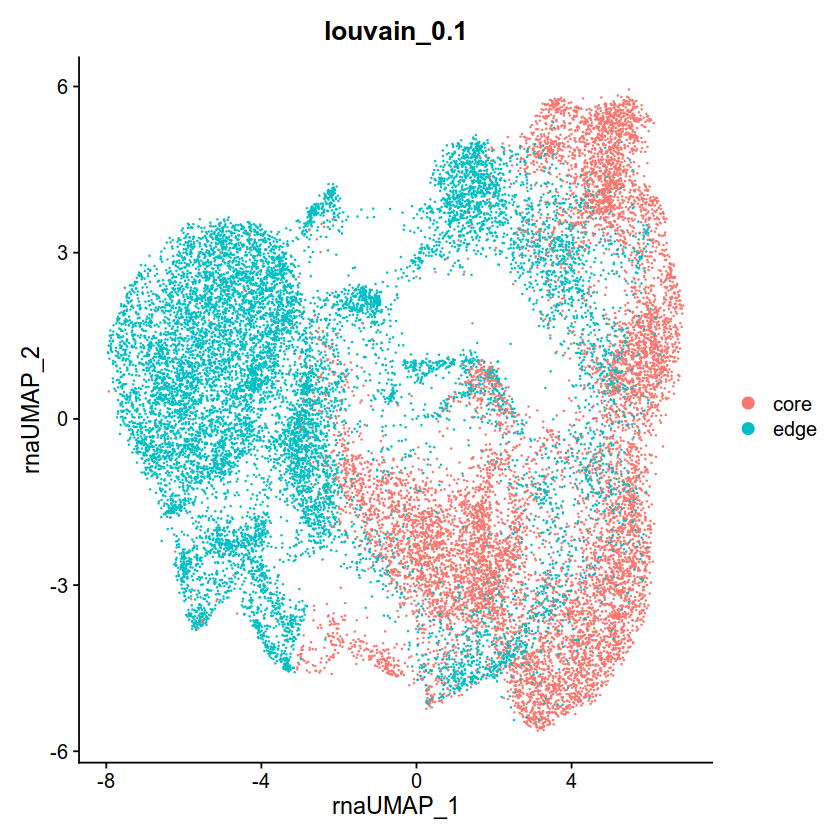

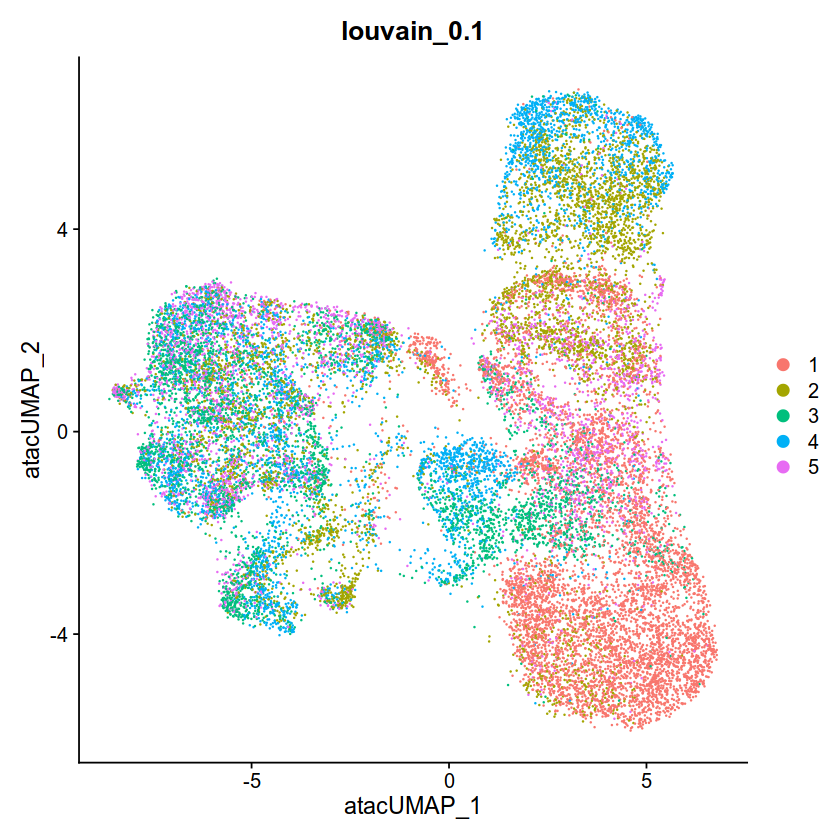

In [14]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "type") + ggtitle("louvain_0.1")
DimPlot(glio.int, reduction = "umap", group.by = "ATAC") + ggtitle("louvain_0.1")

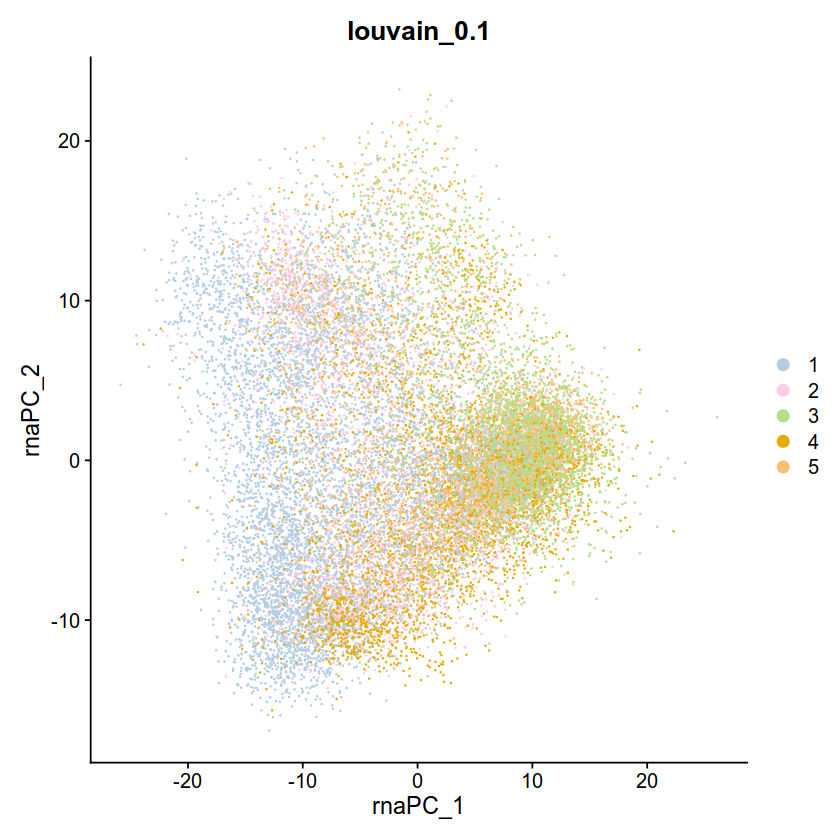

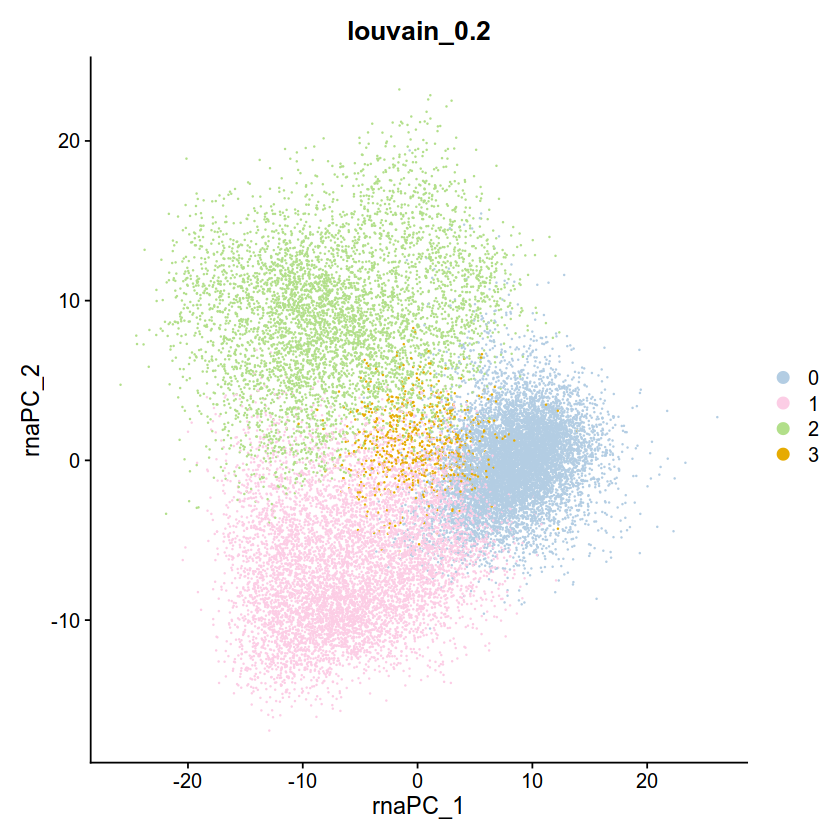

In [15]:
DimPlot(glio.int, reduction = "pca", group.by = "ATAC",cols = col) + ggtitle("louvain_0.1")
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")


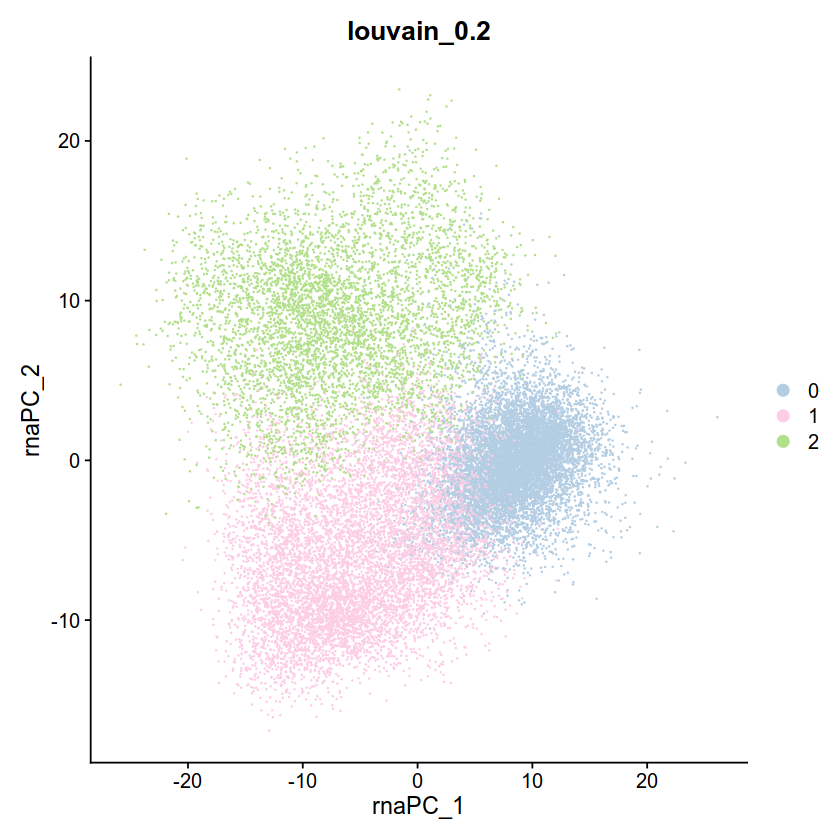

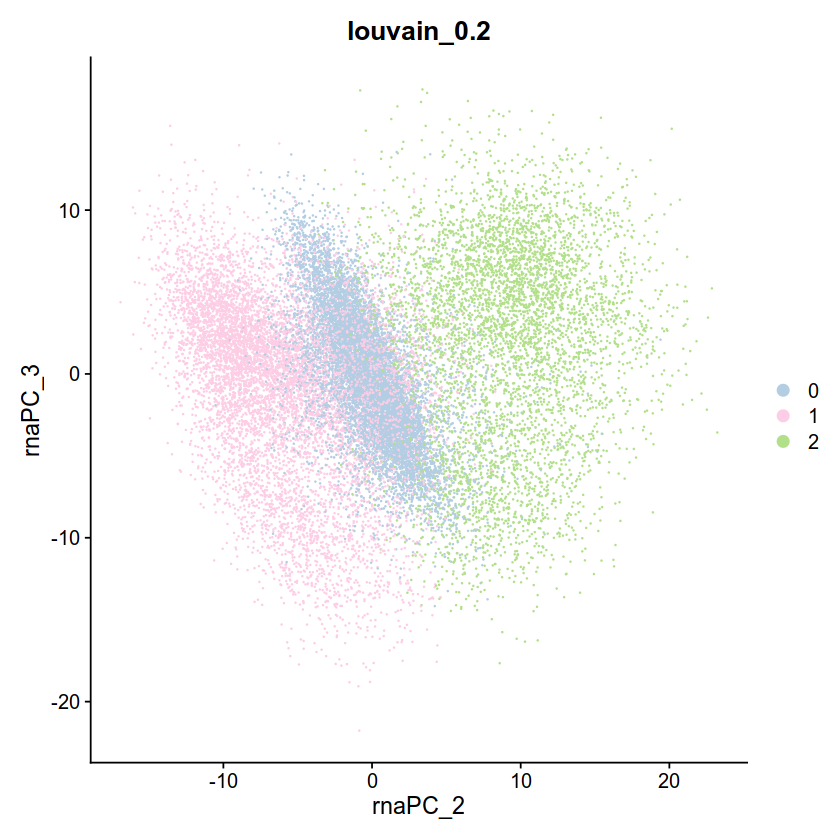

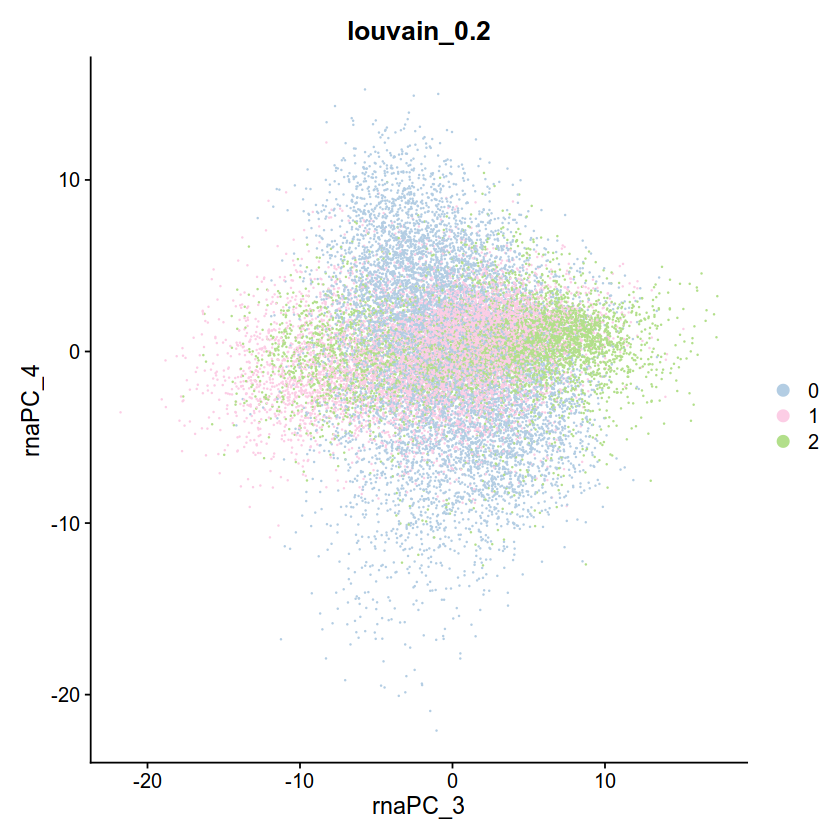

In [16]:
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.1",cols = col,dims=1:2) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.1",cols = col,dims=2:3) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.1",cols = col,dims=3:4) + ggtitle("louvain_0.2")


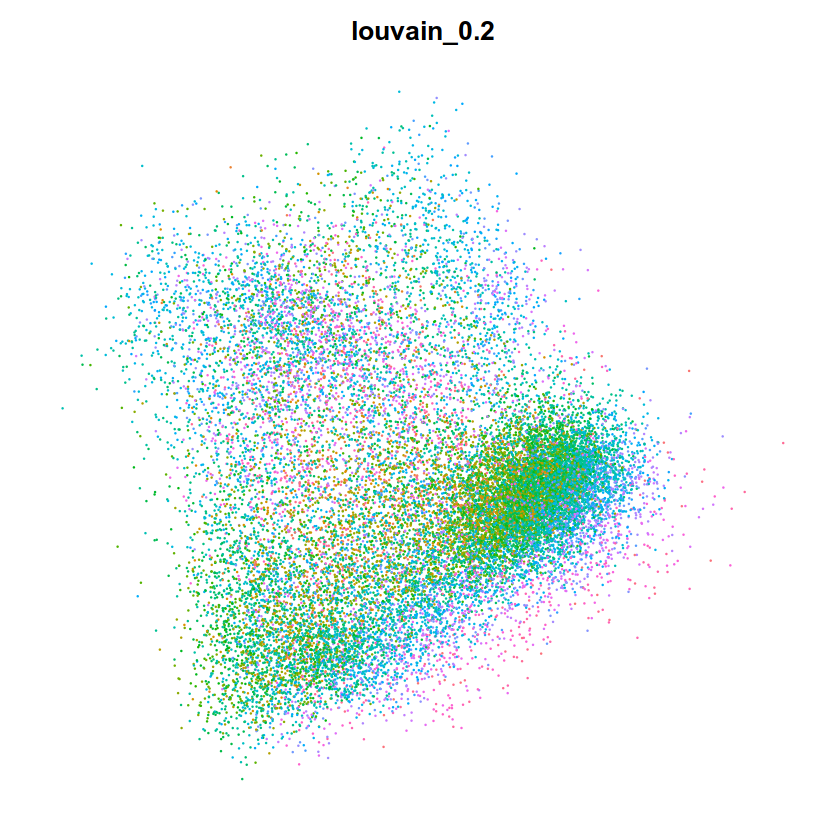

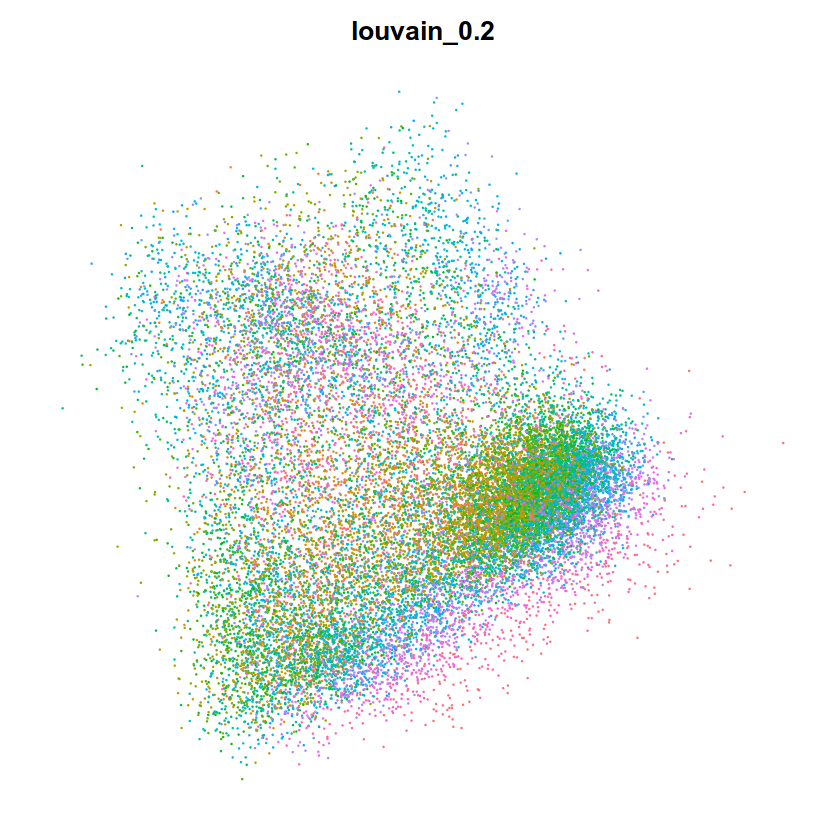

In [17]:
DimPlot(glio.int, reduction = "pca", group.by = "nFeature_RNA",dims=1:2)+NoAxes()+theme(legend.position = "none") + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "pca", group.by = "nCount_RNA",dims=1:2)+NoAxes()+theme(legend.position = "none") + ggtitle("louvain_0.2")


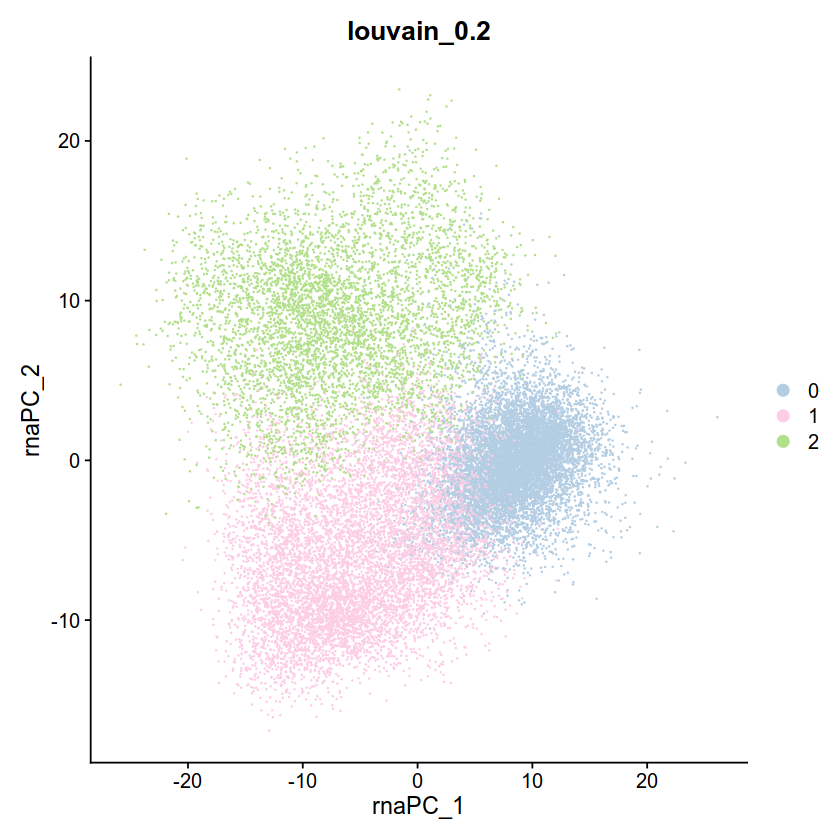

In [18]:
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.1",cols = col,dims=1:2) + ggtitle("louvain_0.2")


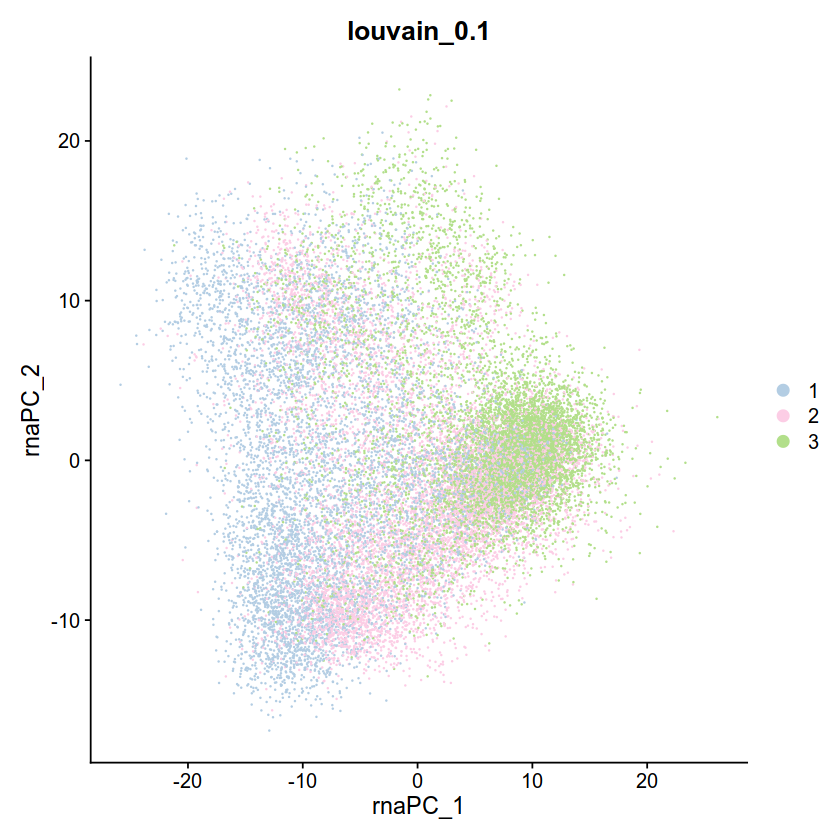

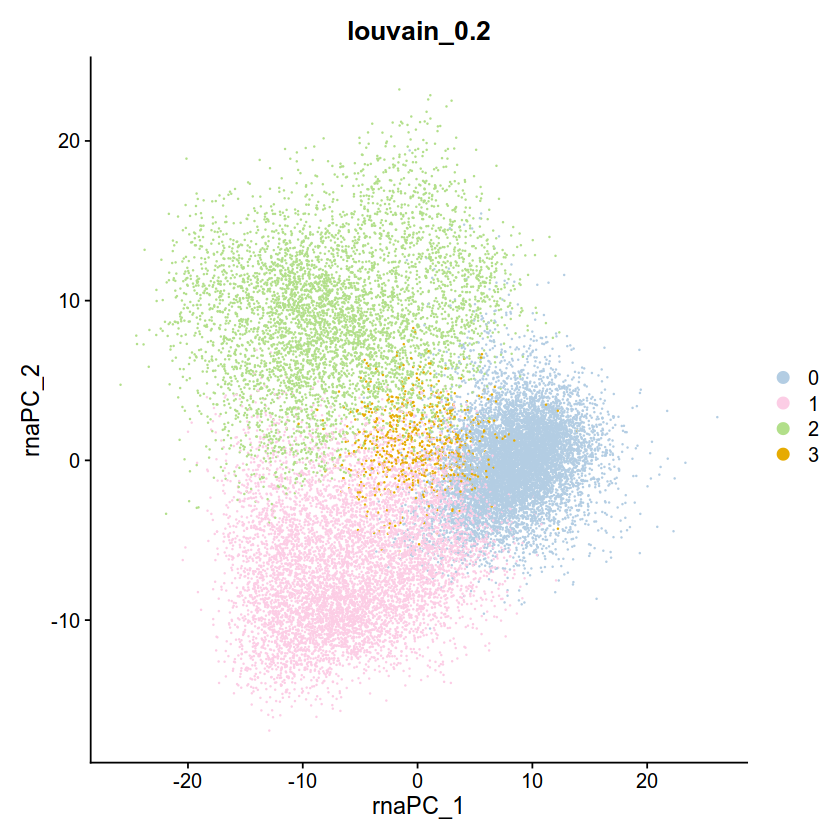

In [19]:
DimPlot(glio.int, reduction = "pca", group.by = "ATAC2",cols = col) + ggtitle("louvain_0.1")
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")


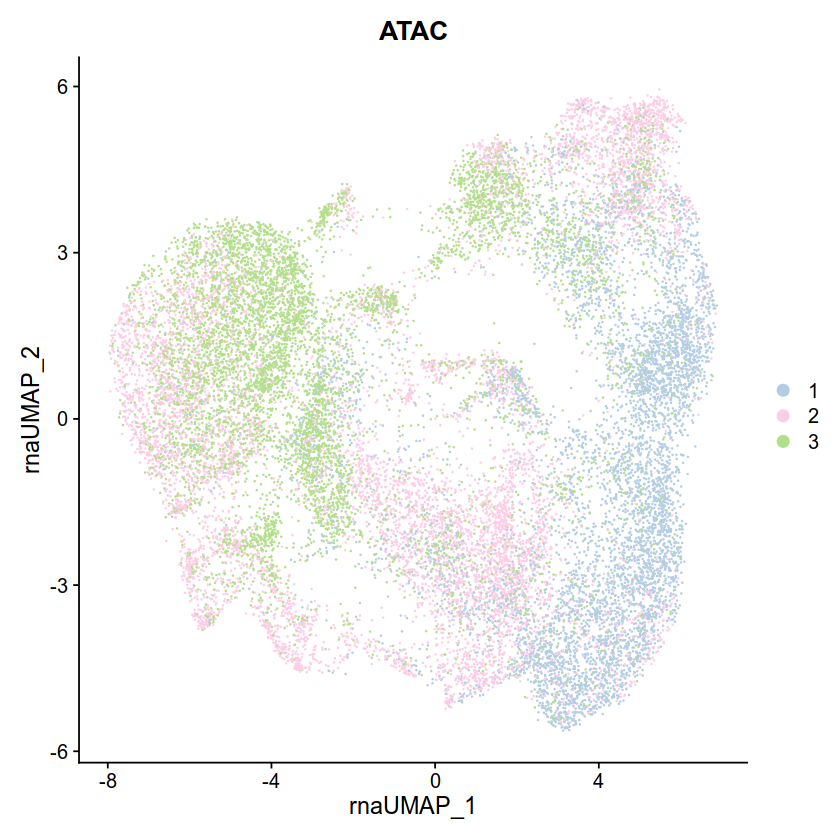

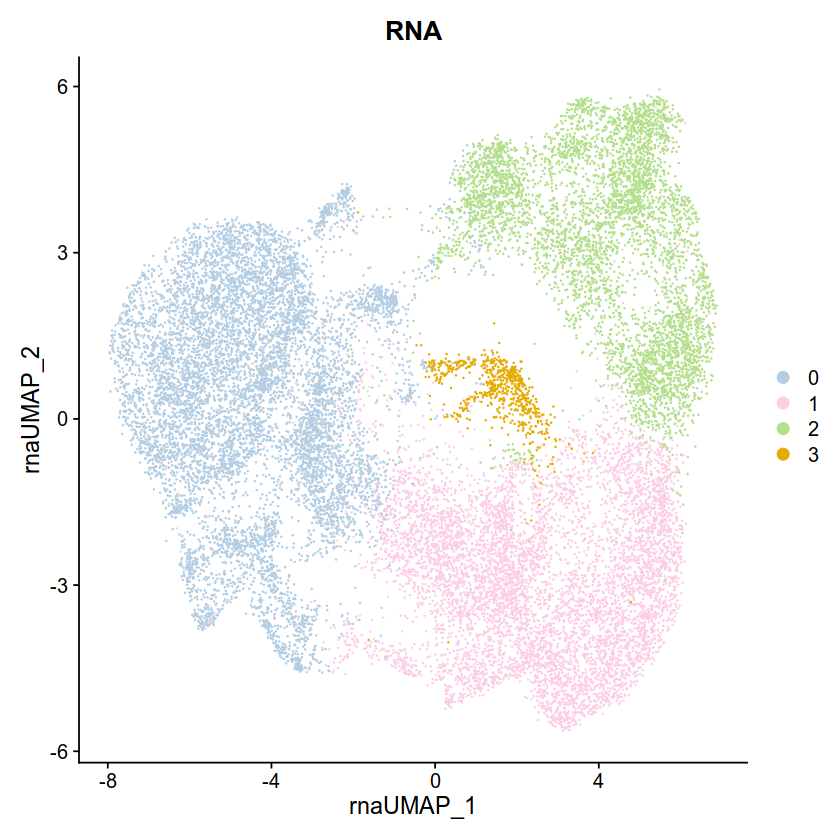

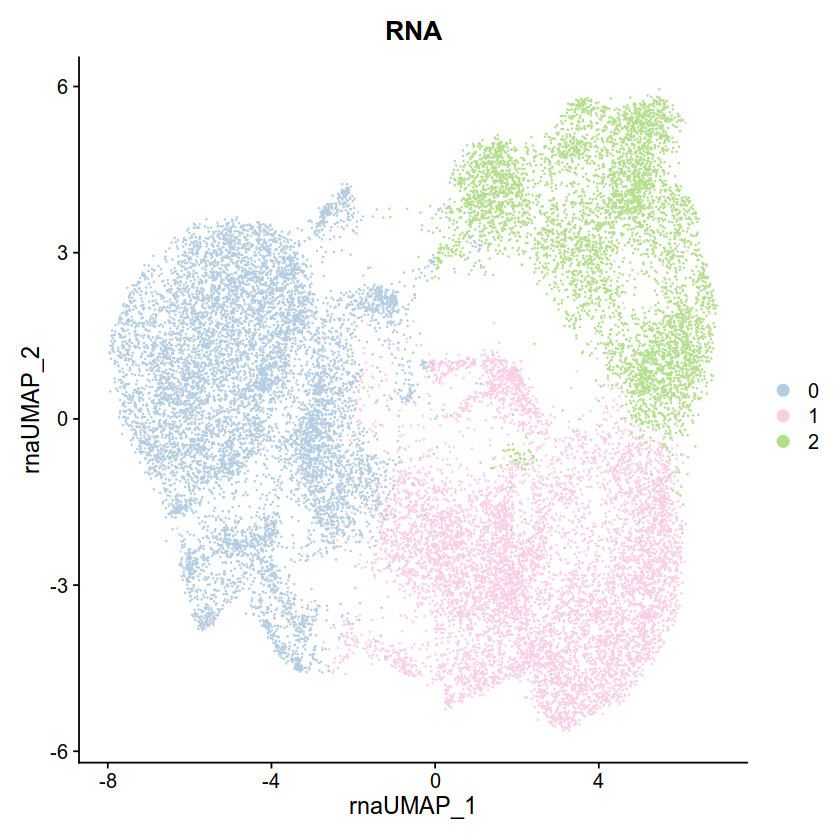

In [20]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "ATAC2",cols = col) + ggtitle("ATAC")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col ) + ggtitle("RNA")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("RNA")


In [21]:
pdf("scrna-seq.3cluster.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("RNA")
dev.off()

png 
  2

In [22]:
pdf("scatac-seq.3cluster.pdf")
DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.1", label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("ATAC")
dev.off()

png 
  2

In [23]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$ATAC)

   
       1    2    3    4    5
  0  373 1613 3362 1997 2050
  1 3647 1530  187 1467  474
  2 2231 1251  628  525  735
  3  201  124   59  174  113

In [24]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$ATAC2)

   
       1    2    3
  0  373 3610 5412
  1 3647 2997  661
  2 2231 1776 1363
  3  201  298  172

In [25]:
table(glio.int$type,glio.int$ATAC2)

      
          1    2    3
  core 4653 4429  742
  edge 1799 4252 6866

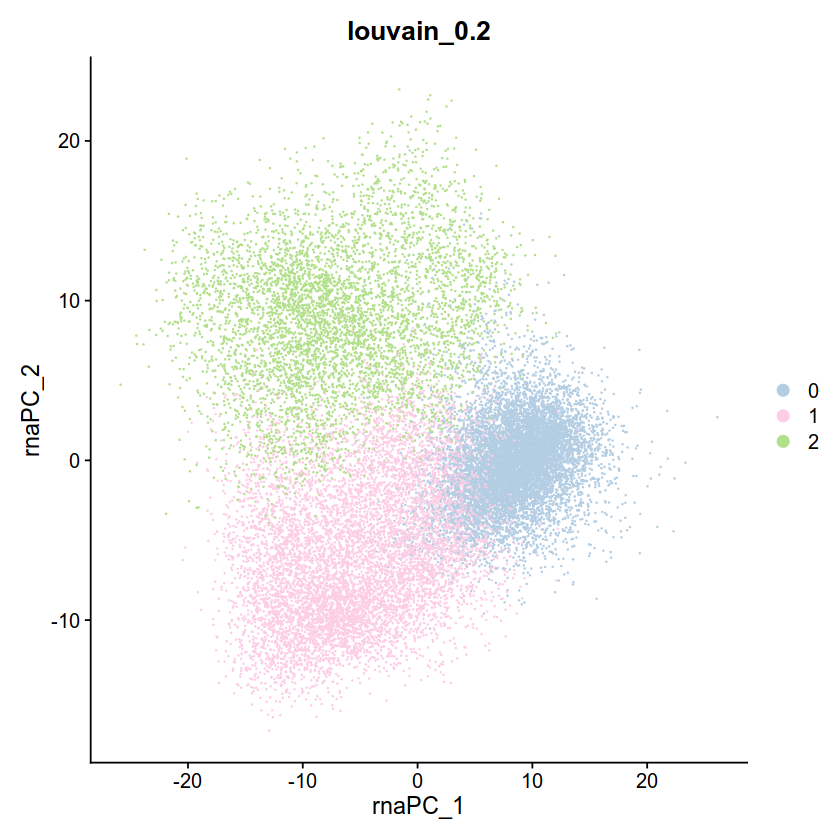

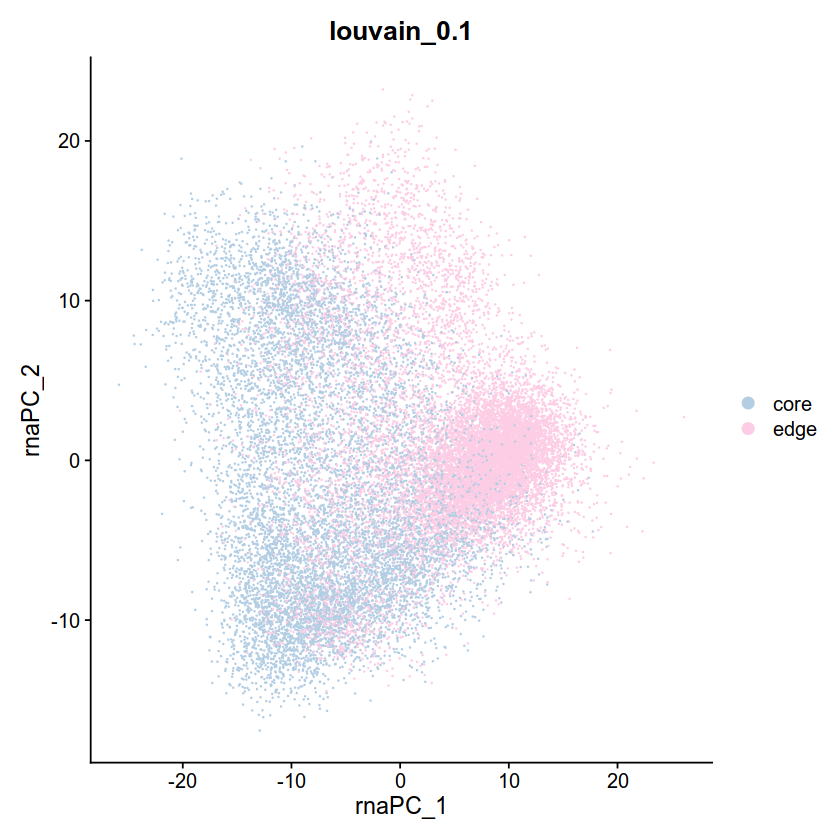

In [26]:
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.1",cols = col) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "pca", group.by = "type",cols = col) + ggtitle("louvain_0.1")

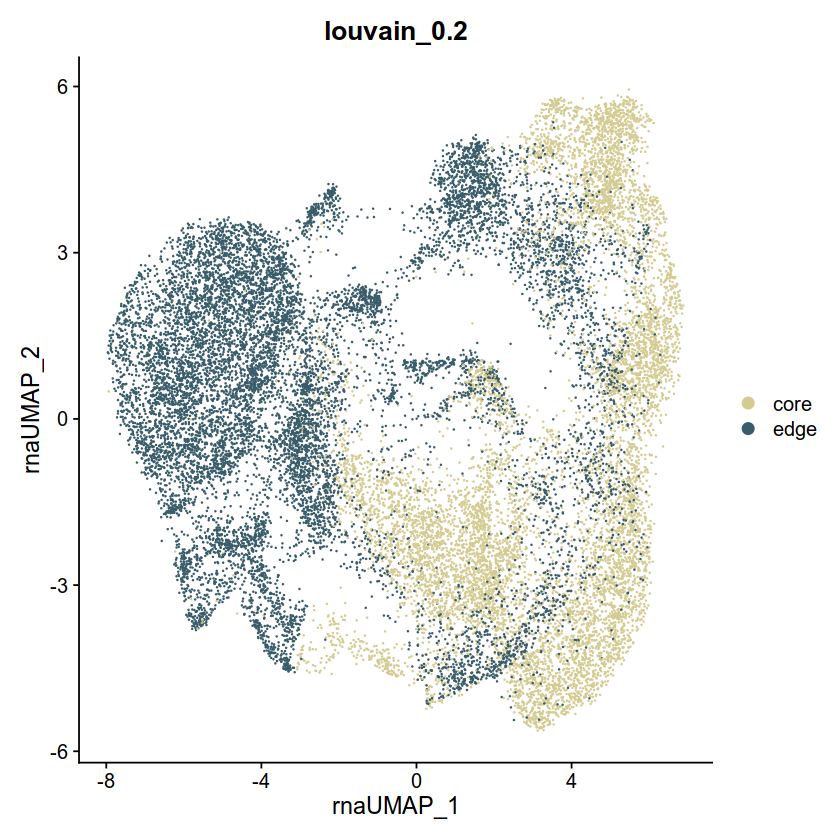

png 
  2

png 
  2

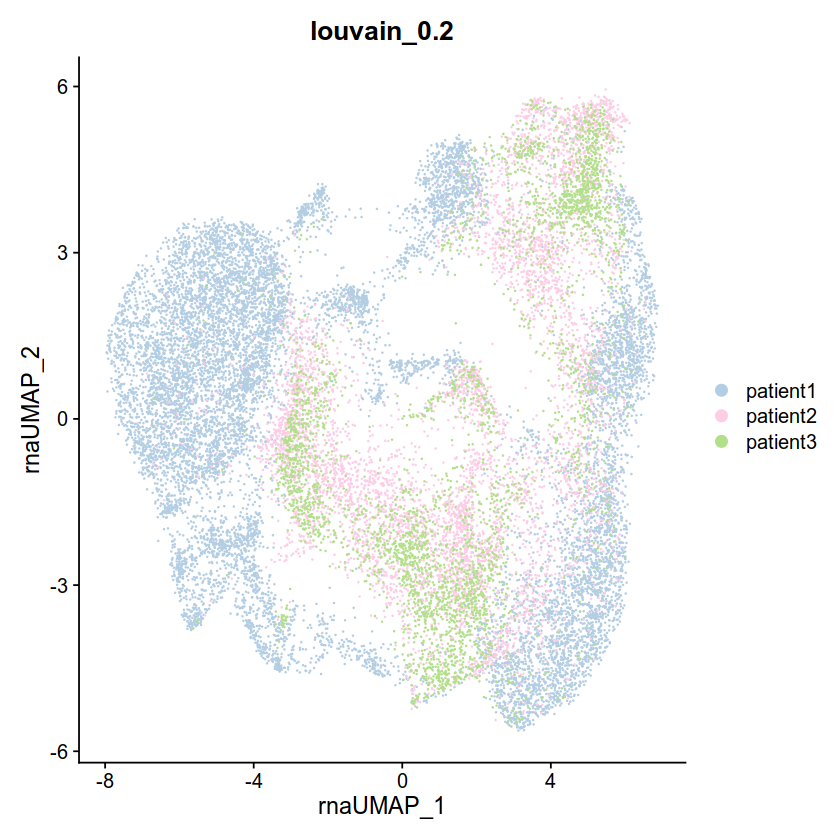

In [27]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "type",cols = c("#D4CB92","#395C6B")) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "rna.umap", group.by = "patient",cols = col ) + ggtitle("louvain_0.2")
pdf("core.edge.cluster.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "type",cols = c("#D4CB92","#395C6B")) + ggtitle("louvain_0.2")
dev.off()
pdf("patient.cluster.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "patient",cols = col ) + ggtitle("louvain_0.2")
dev.off()

In [28]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col2<-sample(col_vector, n)

In [29]:
col3<-col2[1:6]
col3
col3<-c("#FDC086","#FCCDE5","#F2F2F2","#1F78B4","#BF5B17","#B3CDE3")

[1] "#FFF2AE" "#BEAED4" "#999999" "#984EA3" "#FC8D62" "#FFFF33"

In [30]:
table(glio.int$sample,glio.int$`CCA_RNA_snn_res.0.1`)

       
           0    1    2
  core1   54 3053 1361
  core2  246 1758  864
  core3  105 1315 1068
  edge1 7443  202  865
  edge2  969 1086 1045
  edge3  586  557  164

In [31]:
col3<-c("#FDC086","white","white","white","white","white")
col4<-c("white","#FCCDE5","white","white","white","white")
col5<-c("white","white","#386CB0","white","white","white")
col6<-c("white","white","white","#1F78B4","white","white")
col7<-c("white","white","white","white","#BF5B17","white")
col8<-c("white","white","white","white","white","#B3CDE3")

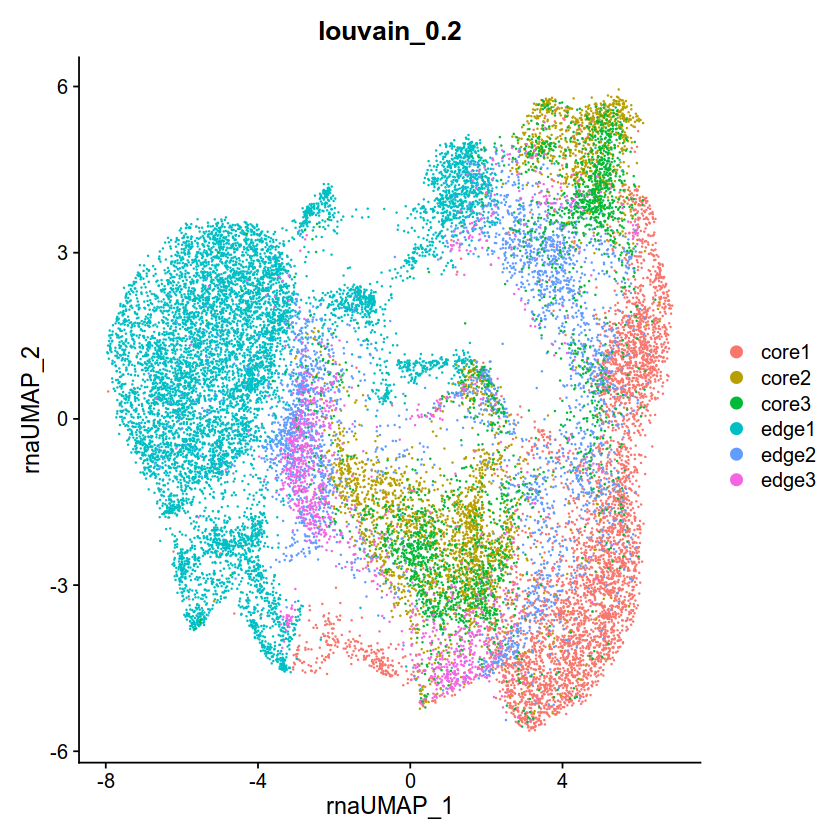

In [33]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "sample" ) + ggtitle("louvain_0.2")


png 
  2

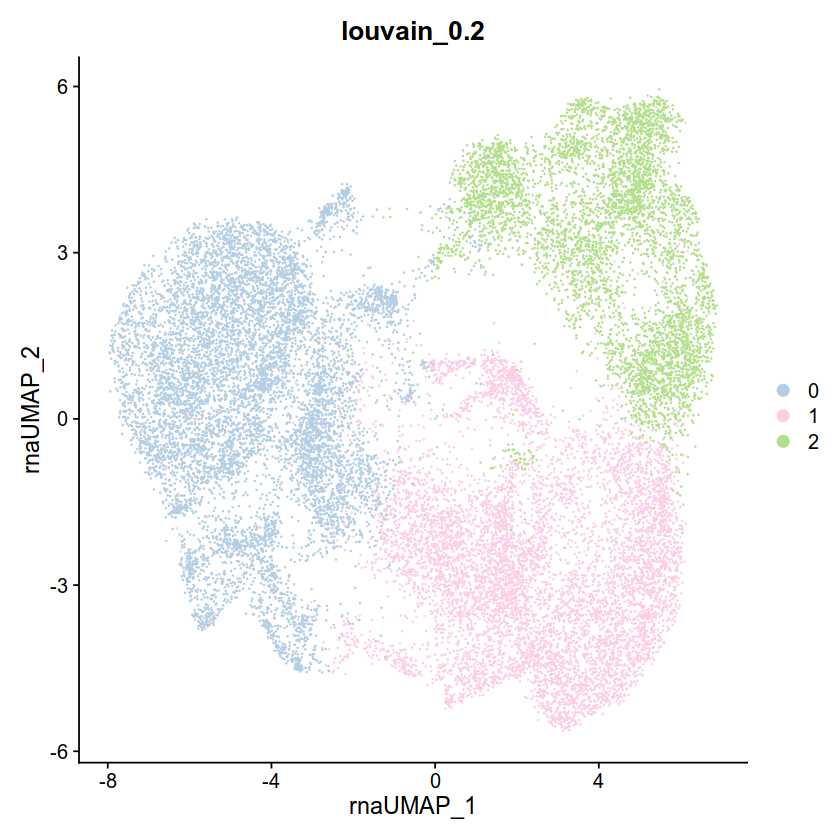

In [34]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("louvain_0.2")
pdf("cluster.scrna.pdf")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.1",cols = col ) + ggtitle("louvain_0.2")
dev.off()

In [35]:
a<-table(glio.int$type,glio.int$CCA_RNA_snn_res.0.1)
new<-t(a/rowSums(a))
new2<-data.frame(new)


In [36]:
new2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,core,0.04122557
1,core,0.62357492
2,core,0.33519951
0,edge,0.69660138
1,edge,0.14283502
2,edge,0.16056360


In [37]:
new2$Var2<-factor(new2$Var2,levels=c("core","edge"))

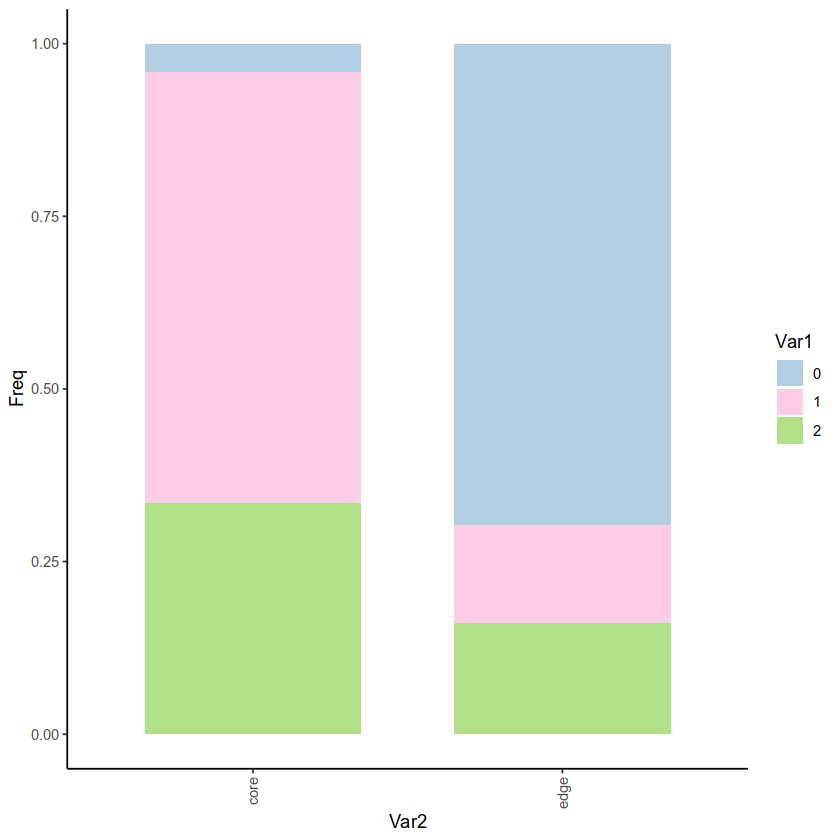

In [38]:
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [39]:
pdf("core.edge.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [40]:
a<-table(glio.int$patient,glio.int$CCA_RNA_snn_res.0.1)

In [41]:
new<-t(a/rowSums(a))
new2<-data.frame(new)

In [42]:
new2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,patient1,0.5776699
1,patient1,0.2508091
2,patient1,0.1715210
0,patient2,0.2035858
1,patient2,0.4765416
2,patient2,0.3198727
0,patient3,0.1820817
1,patient3,0.4932806
2,patient3,0.3246377


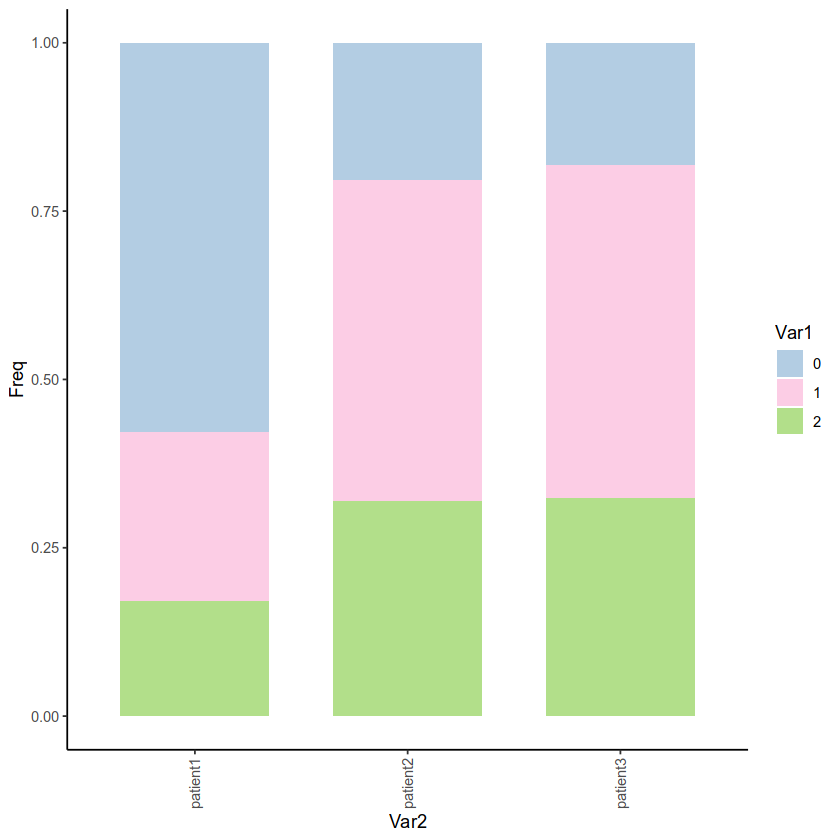

In [43]:
library(ggplot2)
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [44]:
pdf("patient.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [45]:
a<-table(glio.int$sample,glio.int$CCA_RNA_snn_res.0.1)

In [46]:
new<-t(a/rowSums(a))
new2<-data.frame(new)

In [47]:
new2
#new2$Var2<-factor(new2$Var2)
new2$Var2<-factor(new2$Var2,levels=c("core1","edge1","core2","edge2","core3","edge3"))
new2$Var2

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,core1,0.01208594
1,core1,0.68330349
2,core1,0.30461056
0,core2,0.08577406
1,core2,0.61297071
2,core2,0.30125523
0,core3,0.04220257
1,core3,0.52853698
2,core3,0.42926045


[1] core1 core1 core1 core2 core2 core2 core3 core3 core3 edge1 edge1 edge1
[13] edge2 edge2 edge2 edge3 edge3 edge3
Levels: core1 edge1 core2 edge2 core3 edge3

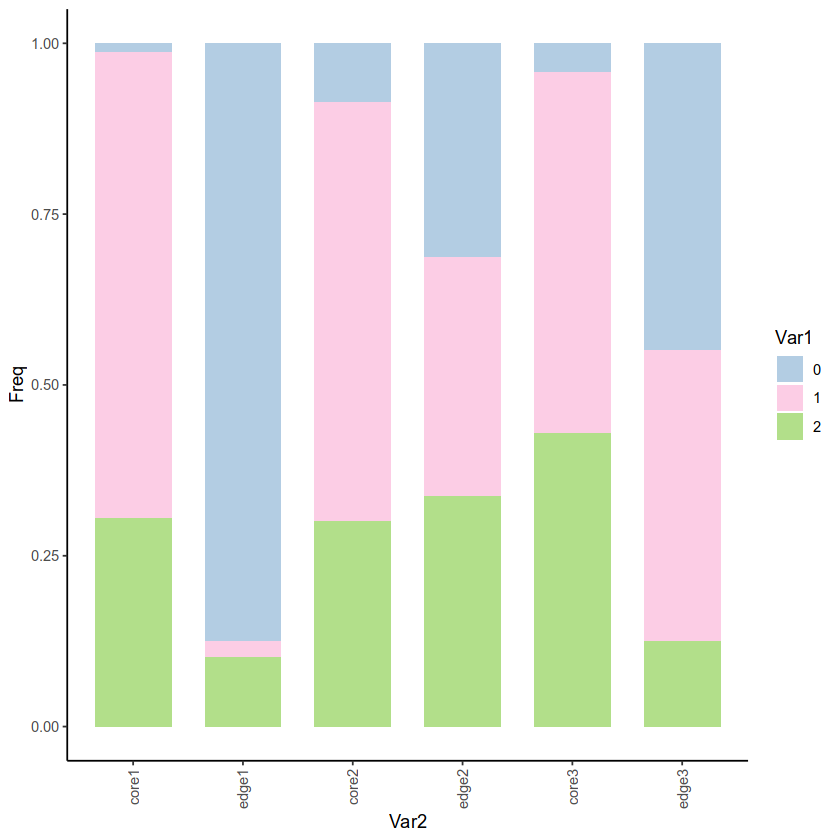

In [48]:
library(ggplot2)
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [49]:
pdf("patient.seperated.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [50]:
###cell cycle
cc_file <- getURL("https://raw.githubusercontent.com/hbc/tinyatlas/master/cell_cycle/Homo_sapiens.csv")
cell_cycle_genes <- read.csv(text = cc_file)
ah <- AnnotationHub()
ahDb <- query(ah,
              pattern = c("Homo sapiens", "EnsDb"),
              ignore.case = TRUE)
id <- ahDb %>%
        mcols() %>%
        rownames() %>%
        tail(n = 1)
edb <- ah[[id]]
annotations <- genes(edb,
                     return.type = "data.frame")
annotations <- annotations %>%
        dplyr::select(gene_id, gene_name, seq_name, gene_biotype, description)
# Get gene names for Ensembl IDs for each gene
cell_cycle_markers <- dplyr::left_join(cell_cycle_genes, annotations, by = c("geneID" = "gene_id"))

# Acquire the S phase genes
s_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "S") %>%
        pull("gene_name")

# Acquire the G2M phase genes
g2m_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "G2/M") %>%
        pull("gene_name")

snapshotDate(): 2022-10-31

loading from cache



In [51]:
#build gene-expression rankings for each cell 
glio.int.matrix<-as.matrix(glio.int@assays$RNA@data)
cells_rankings <- AUCell_buildRankings(glio.int.matrix, nCores=30, plotStats=FALSE)
#calculate enrichment for the gene signatures
geneSets <- GeneSet(c(s_genes,g2m_genes), setName="geneSet1")
cells_AUC <- AUCell_calcAUC(geneSets, cells_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 6.2 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


,threshold,nCells
tenPercentOfMax,0.03770350,8374
Global_k1,0.10241300,4663
L_k2,0.06462748,6435


Global_k1 
 0.102413

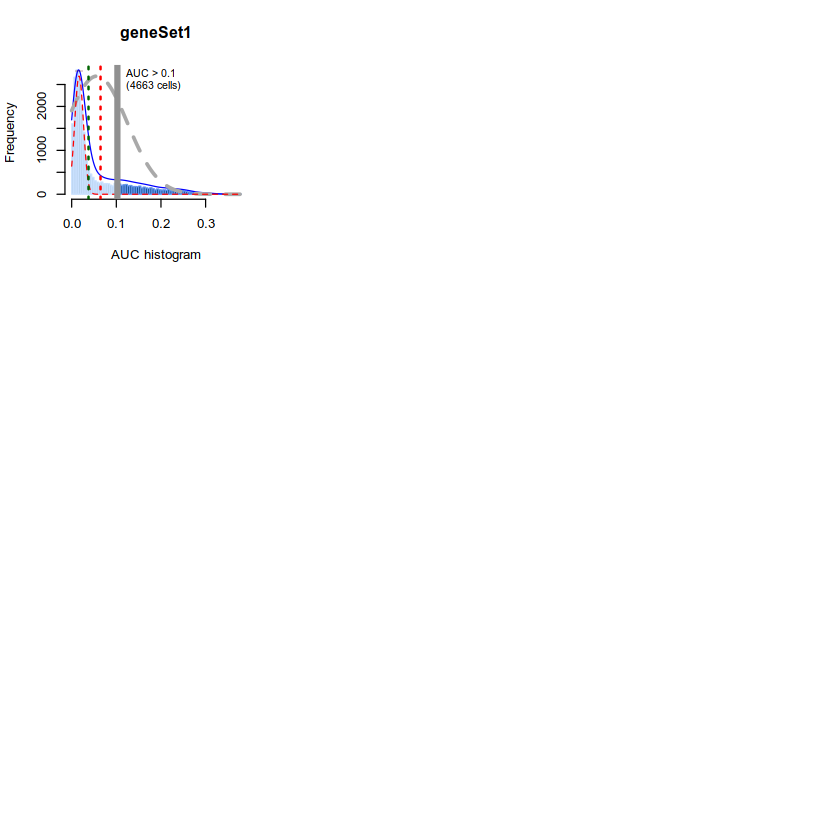

In [52]:
#Determine the cells with the given gene signatures or active gene sets
par(mfrow=c(3,3)) 
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, assign=TRUE) 
cells_assignment$geneSet1$aucThr$thresholds
cells_assignment$geneSet1$aucThr$selected

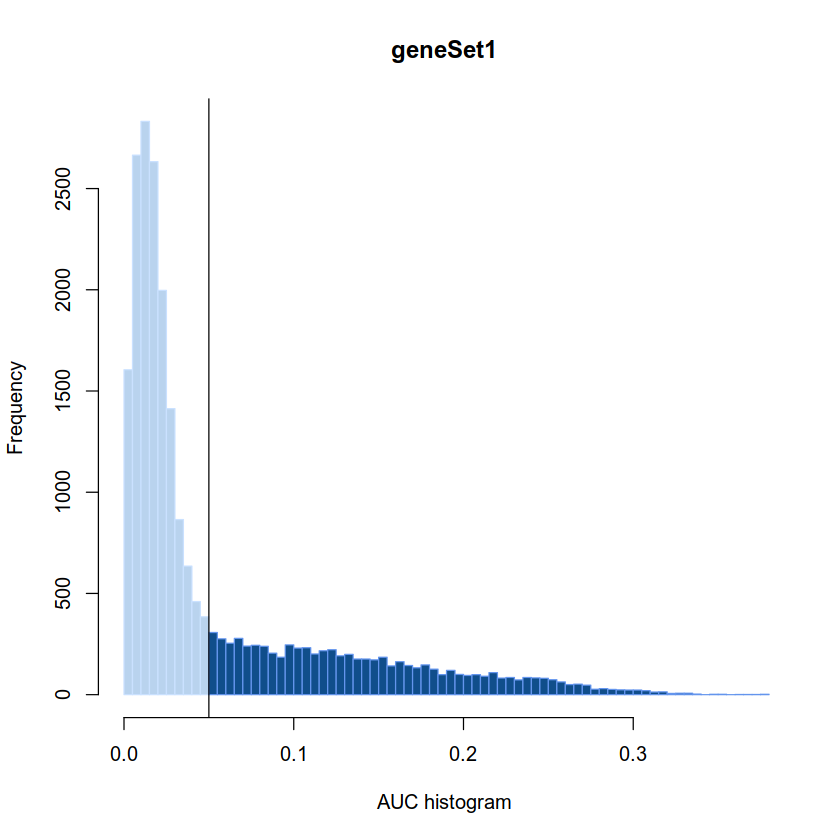

In [53]:
#ploting
geneSetName<-rownames(cells_AUC)[grep("geneSet1", rownames(cells_AUC))]
AUCell_plotHist(cells_AUC[geneSetName,], aucThr=0.05)
abline(v=0.05)

In [54]:
AUC<-data.frame(t(as.data.frame(cells_AUC@assays@data$AUC)))
colnames(AUC)<-"AUC"
#add AU#add AUC
glio.int<-AddMetaData(glio.int,metadata=AUC)
glio.int$S_G2M_AUC = AUC

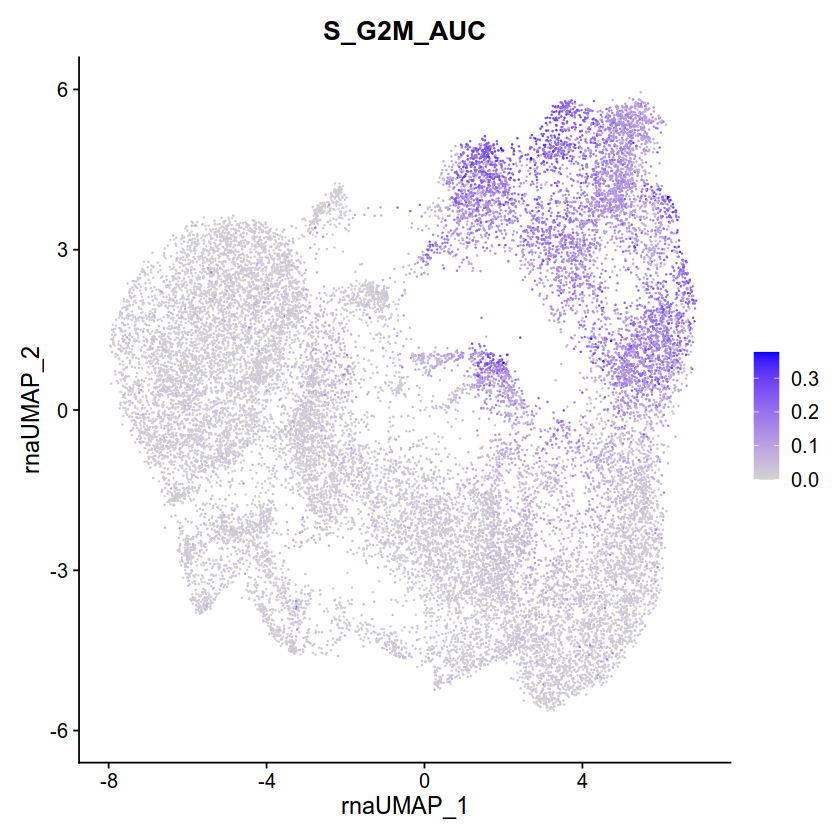

In [55]:
FeaturePlot(glio.int, features = 'S_G2M_AUC',reduction="rna.umap")

Warning message:
"Could not find NF1 in the default search locations, found in RNA assay instead"


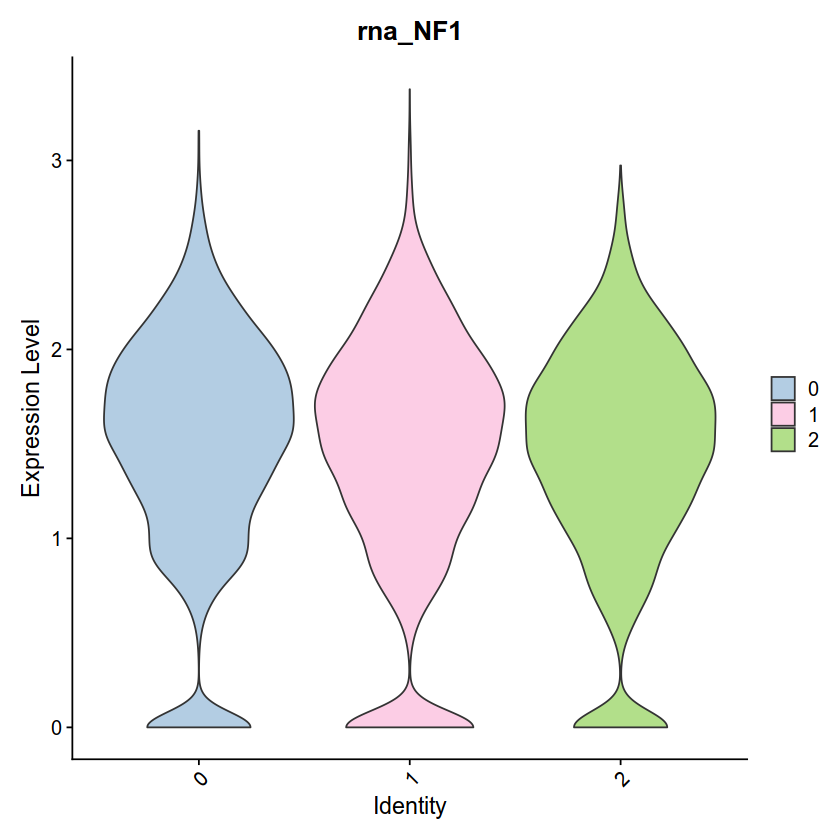

In [56]:
DefaultAssay(glio.int) <- "CCA_RNA"
VlnPlot(glio.int, features = "NF1",group.by = "CCA_RNA_snn_res.0.1",cols=col,pt.size=0)

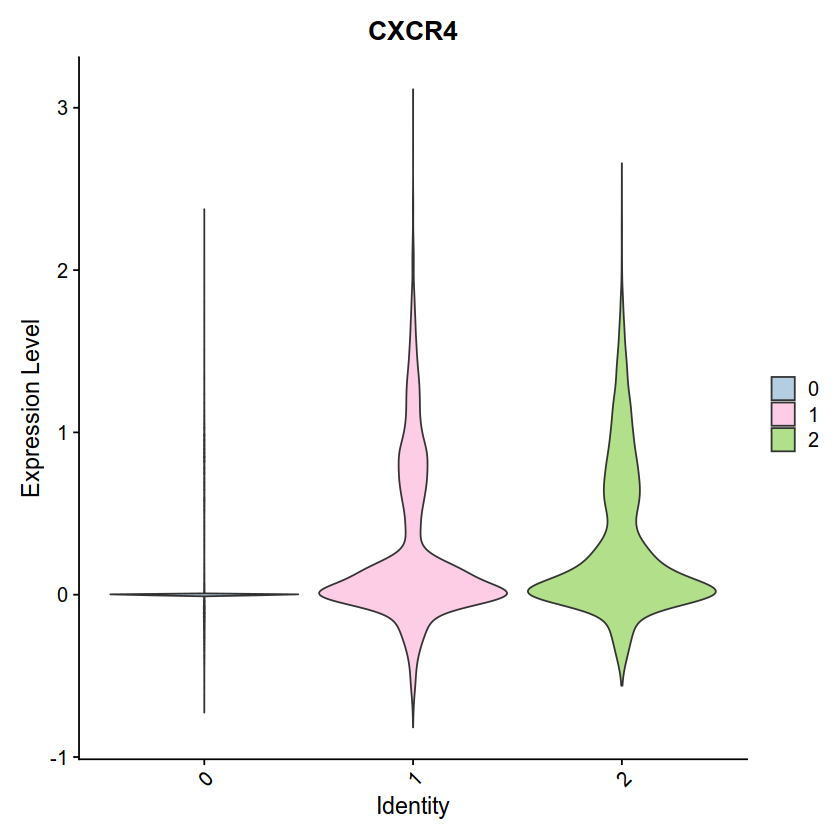

In [57]:
DefaultAssay(glio.int) <- "CCA_RNA"
VlnPlot(glio.int, features = "CXCR4",group.by = "CCA_RNA_snn_res.0.1",cols=col,pt.size=0)

In [58]:
pdf("cycling.cluster.pdf")
FeaturePlot(glio.int, features = 'S_G2M_AUC',reduction="rna.umap")
dev.off()


png 
  2

In [59]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$type)

   
    core edge
  0  402 8993
  1 5858 1447
  2 3290 2080
  3  274  397

In [60]:
table(glio.int$ATAC,glio.int$S_G2M_AUC > 0.1)

   
    FALSE TRUE
  1  4397 2055
  2  3459 1059
  3  3730  506
  4  3641  522
  5  2737  635

In [61]:
a<-table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$S_G2M_AUC > 0.1)

In [62]:
new<-t(a/rowSums(a))
new2<-data.frame(new)

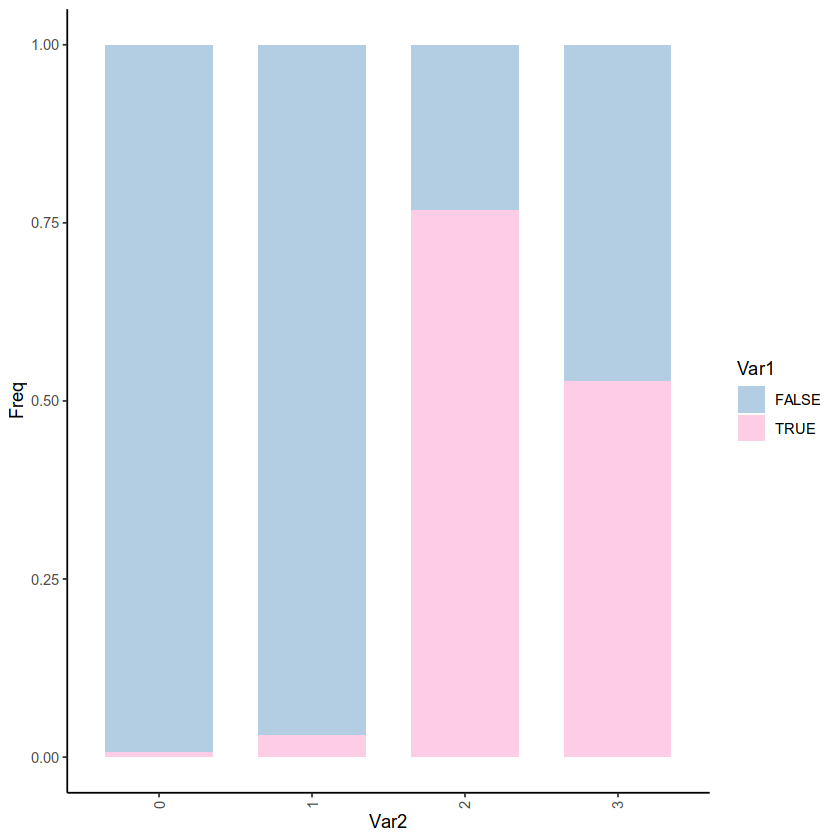

In [63]:
library(ggplot2)
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [64]:
pdf("cell.cyclying.barplot.pdf")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=col)+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [65]:
#subset_seurat[,names(which(subset_seurat$sample != "core1"))]

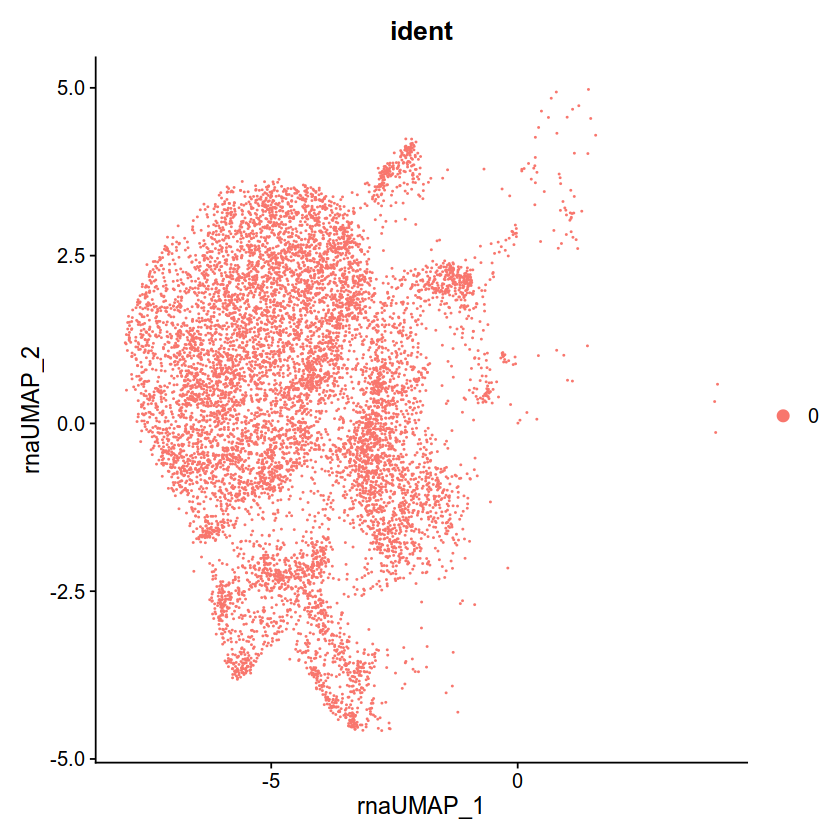

In [66]:
DefaultAssay(glio.int) <- "CCA_RNA"
clusters_of_interest <- 0
subset_seurat <- subset(glio.int, idents = clusters_of_interest)
DimPlot(subset_seurat, group.by = "ident")

In [67]:
#subset_seurat2<-subset_seurat[,names(which(subset_seurat$sample != "core1"｜ subset_seurat$sample != "core2"｜ subset_seurat$sample != "core3" ))]

In [68]:
subset_seurat2<-subset_seurat[,!(names(subset_seurat$sample) %in% names(which(subset_seurat$sample == "core1"| subset_seurat$sample == "core2"| subset_seurat$sample == "core3" )))]

In [69]:
subset_seurat2

An object of class Seurat 
510659 features across 8993 samples within 5 assays 
Active assay: CCA_RNA (2000 features, 2000 variable features)
 4 other assays present: RNA, ATAC_common_peak, chromvar, peaks
 6 dimensional reductions calculated: pca, rna.umap, lsi, umap, harmony, wnn.umap

In [70]:
subset_seurat<-subset_seurat2

In [71]:
DefaultAssay(subset_seurat) <- "CCA_RNA"

subset_seurat<-FindNeighbors(subset_seurat,dims=1:30,reduction="pca",k.param=60,prune.SNN=1/20)
#filtered_seurat<-FindNeighbors(filtered_seurat,dims=1:30)
names(subset_seurat@graphs)

Computing nearest neighbor graph

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Computing SNN



[1] "CCA_RNA_nn"  "CCA_RNA_snn"

In [72]:
for( res in c(0.1,0.15,0.2,0.25,0.3,0.4,0.6,0.8,1)){
   subset_seurat<-FindClusters(subset_seurat,graph.name='CCA_RNA_snn',resolution=res,algorithm=2)
    #filtered_seurat<-FindClusters(filtered_seurat,resolution=res)
}

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.9047
Number of communities: 2
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.8708
Number of communities: 3
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.8390
Number of communities: 4
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.8210
Number of communities: 6
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.8081
Number of communities: 6
Elapsed time: 4 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.7831
Number of communities: 6
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.7448
Number of communities: 9
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.7139
Number of communities: 9
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1303532

Running Louvain algorithm with multilevel refinement...
Maximum modularity in 10 random starts: 0.6838
Number of communities: 9
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [73]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col<-sample(col_vector, n)

In [75]:
DefaultAssay(subset_seurat) <- "peaks"


In [76]:
subset_seurat<-FindNeighbors(subset_seurat,dims=1:30,k.param=60,reduction = 'harmony',prune.SNN=1/20)
#filtered_seurat<-FindNeighbors(filtered_seurat,dims=1:30)
names(subset_seurat@graphs)

Computing nearest neighbor graph

Warning message:
"Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Computing SNN



[1] "CCA_RNA_nn"  "CCA_RNA_snn" "peaks_nn"    "peaks_snn"

In [77]:
for( res in c(0.1,0.2,0.25,0.3,0.4,0.6,0.8,1)){
    subset_seurat<-FindClusters(subset_seurat,graph.name='peaks_snn',resolution=res,algorithm=1)
    #filtered_seurat<-FindClusters(filtered_seurat,resolution=res)
}

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9141
Number of communities: 3
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8699
Number of communities: 4
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8548
Number of communities: 5
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8418
Number of communities: 6
Elapsed time: 3 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8222
Number of communities: 7
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7886
Number of communities: 8
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7590
Number of communities: 11
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 8993
Number of edges: 1325516

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7335
Number of communities: 12
Elapsed time: 2 seconds
R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


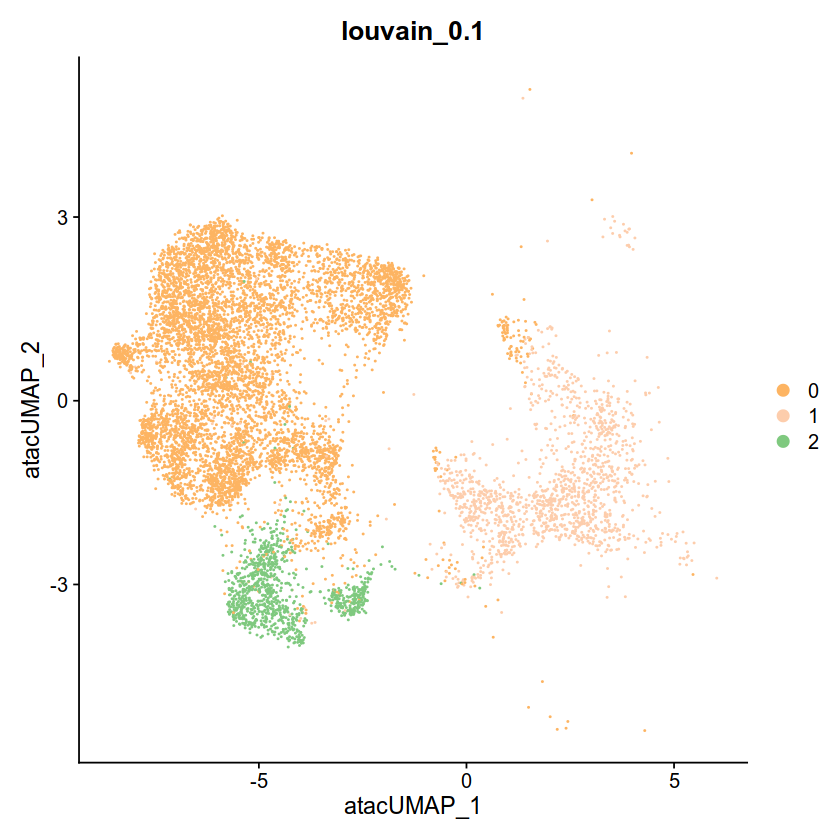

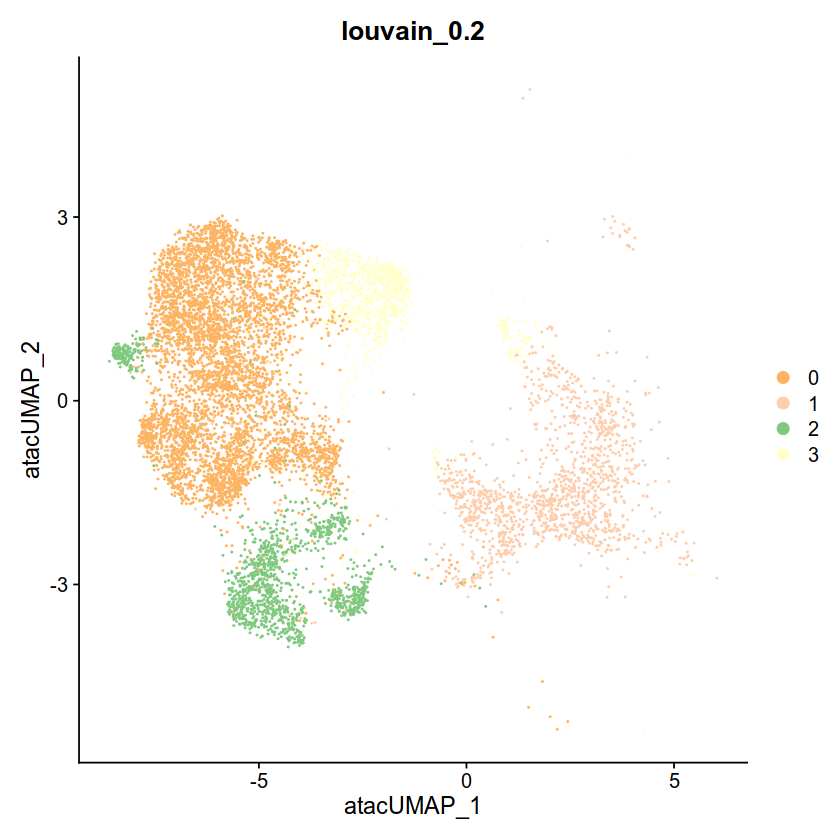

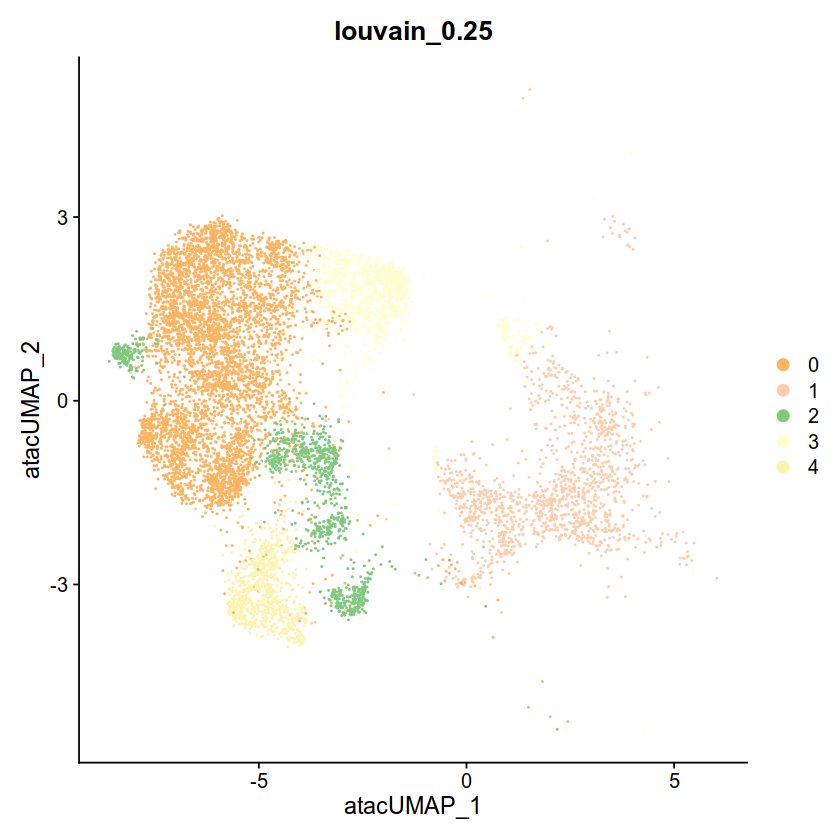

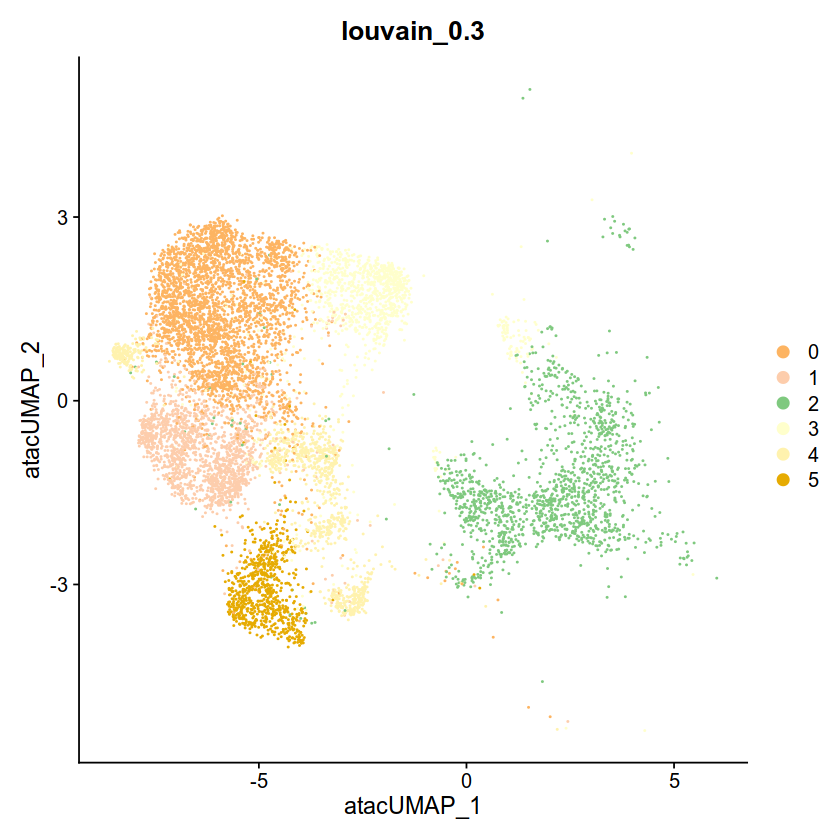

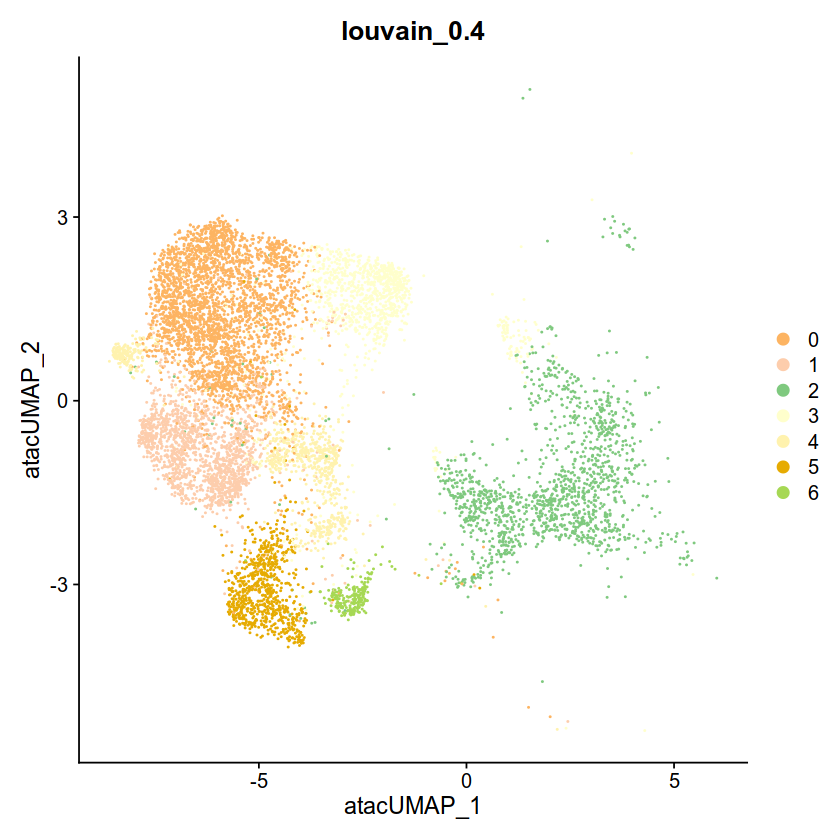

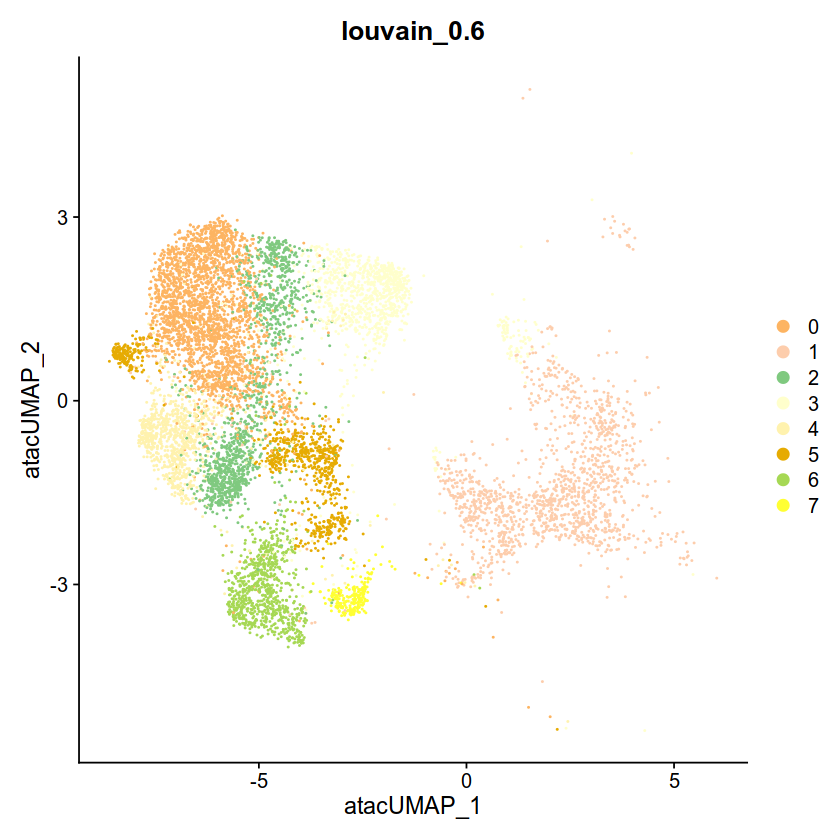

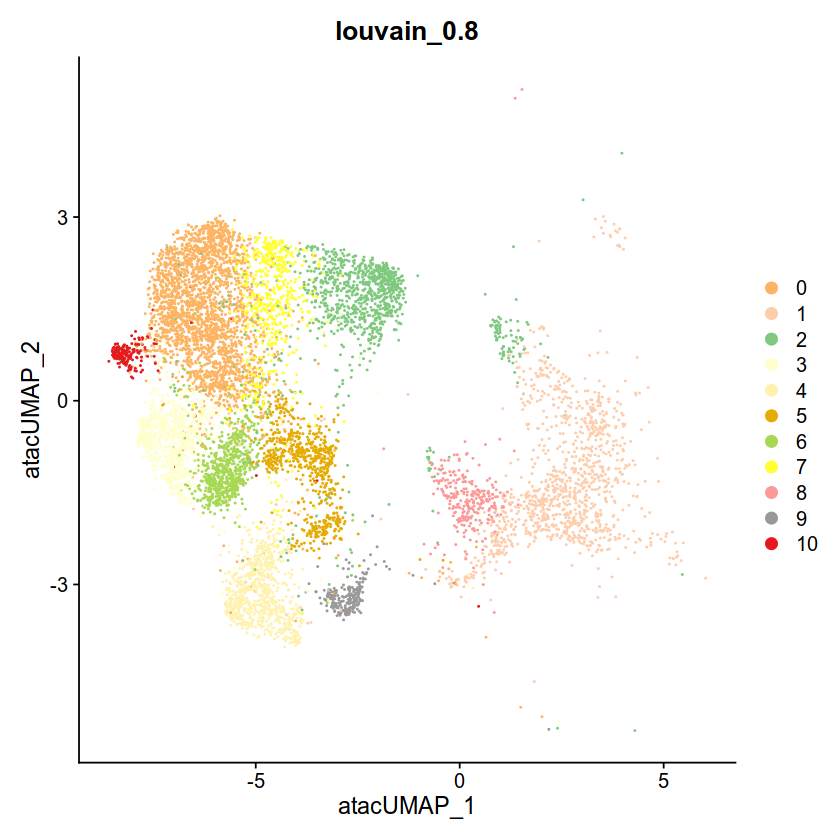

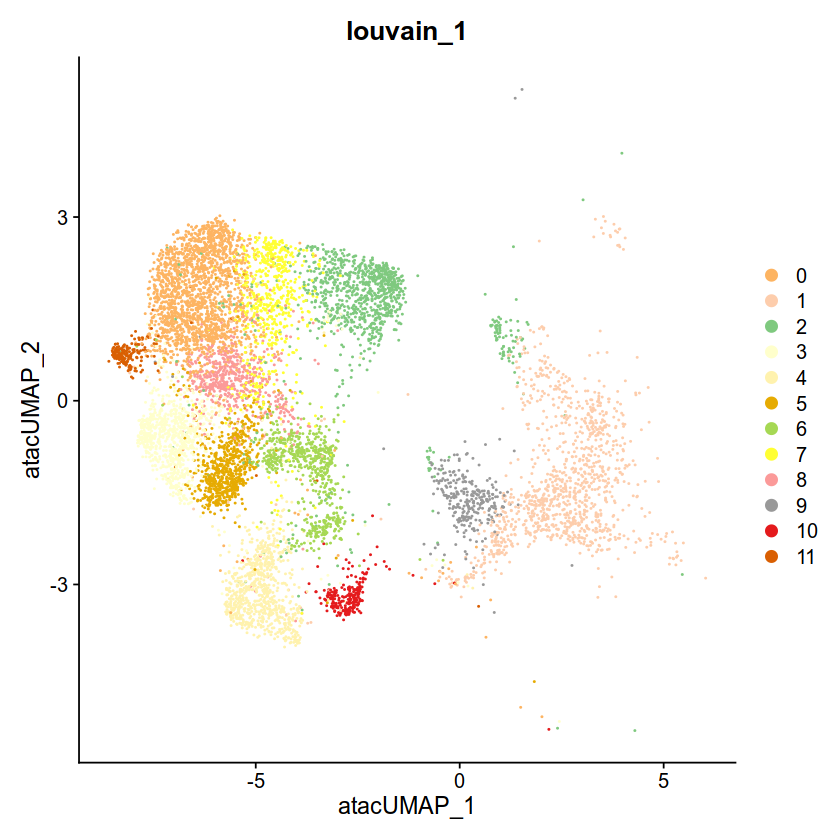

In [78]:
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.0.1",cols = col) + ggtitle("louvain_0.1")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.25",cols = col) + ggtitle("louvain_0.25")

DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.3",cols = col) + ggtitle("louvain_0.3")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
#DimPlot(alldata.int,reduction="tsne",group.by="CCA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.0.6",cols = col) + ggtitle("louvain_0.6")
DimPlot(subset_seurat,reduction="umap",group.by="peaks_snn_res.0.8",cols = col) + ggtitle("louvain_0.8")
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.1",cols = col) + ggtitle("louvain_1")

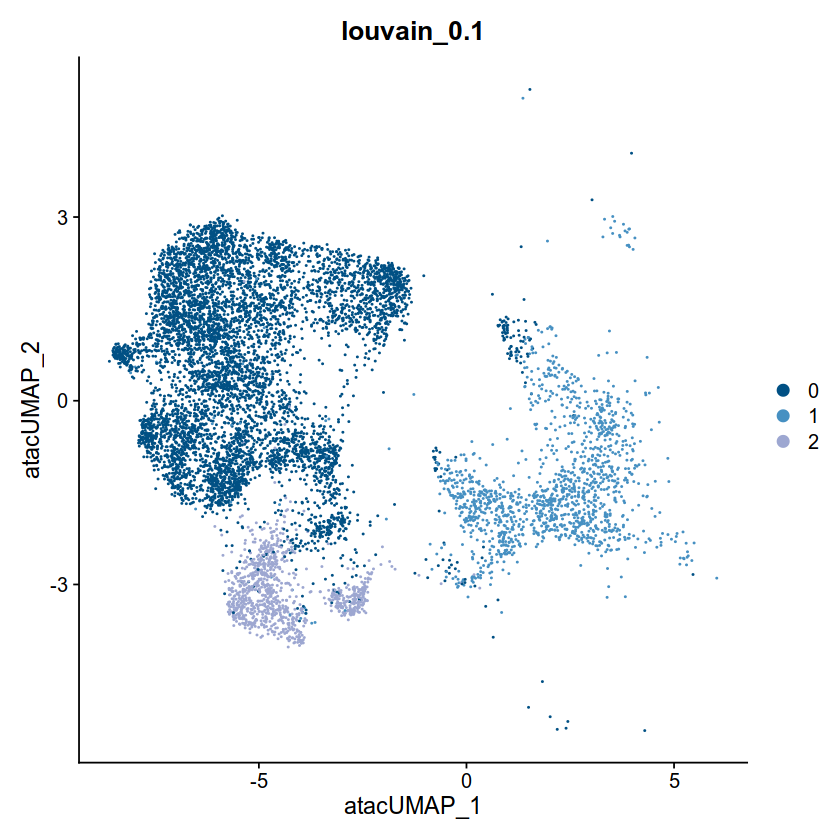

png 
  2

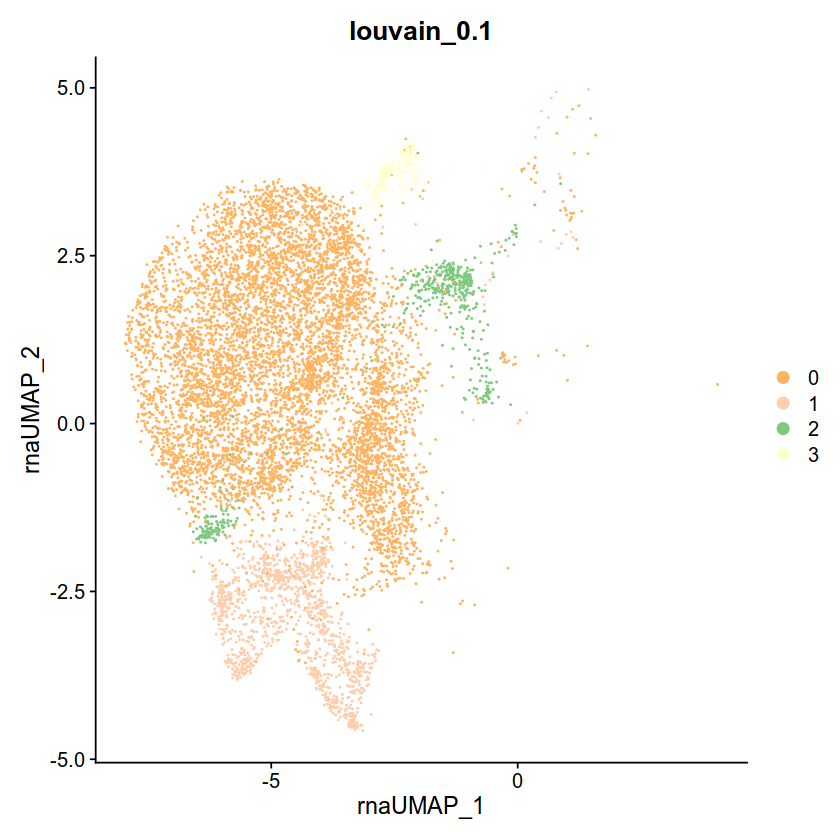

In [79]:
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.0.1",cols = c("#005084","#4690C2","#9DA7D1")) + ggtitle("louvain_0.1")
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.1")

pdf("edge.sub.clsuters.pdf")
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.0.1",cols = c("#005084","#4690C2","#9DA7D1")) + ggtitle("louvain_0.1")
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.1")

dev.off()


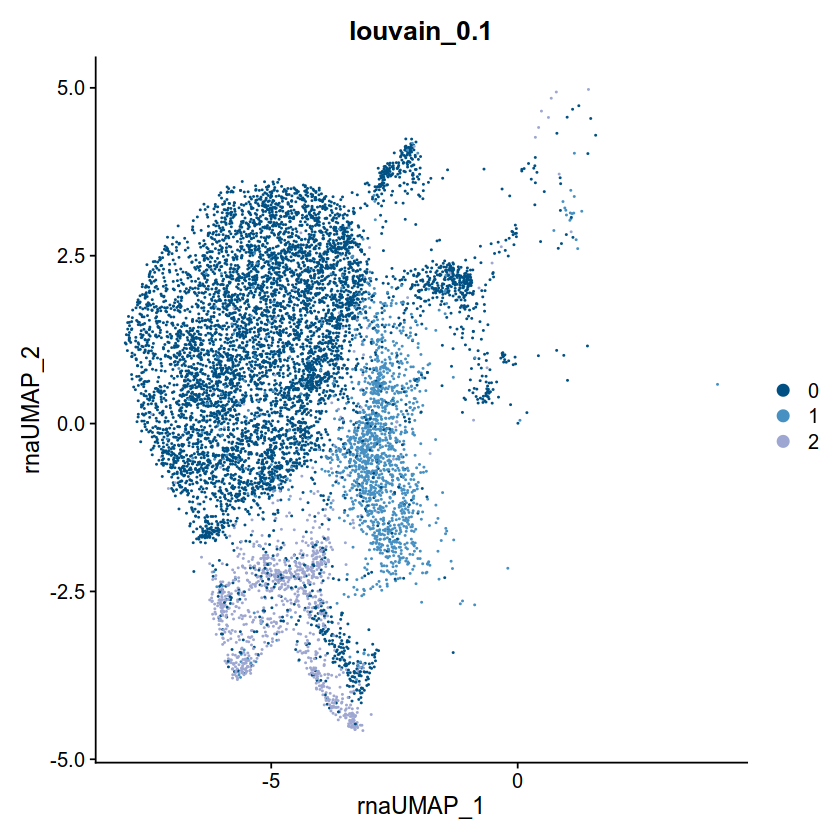

In [80]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col<-sample(col_vector, n)

DimPlot(subset_seurat, reduction = "rna.umap", group.by = "peaks_snn_res.0.1",cols = c("#005084","#4690C2","#9DA7D1")) + ggtitle("louvain_0.1")


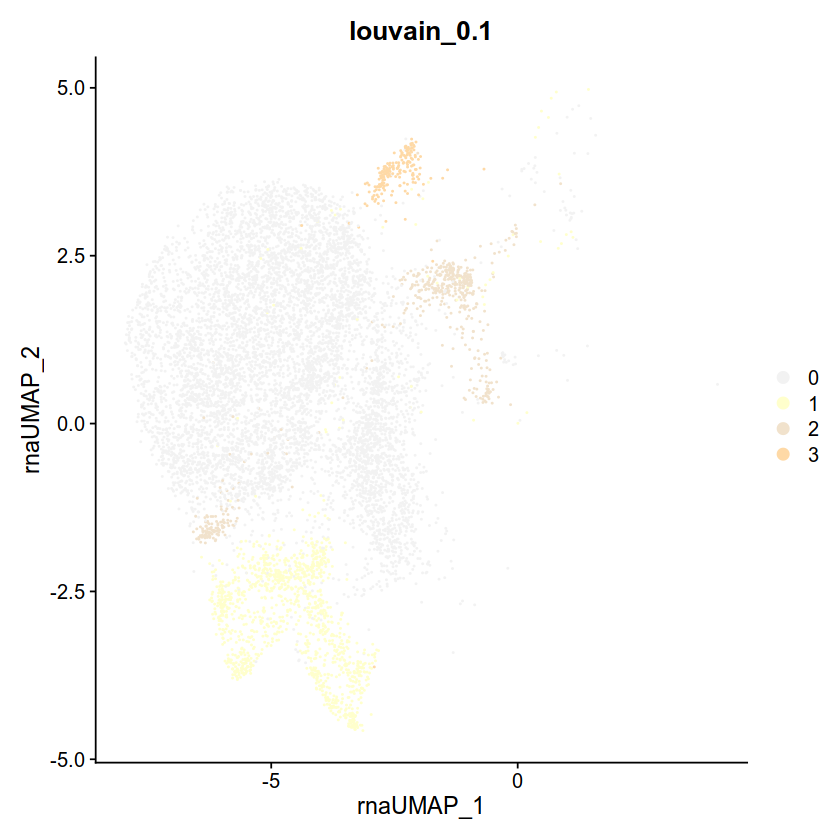

In [81]:
DimPlot(subset_seurat, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.1")

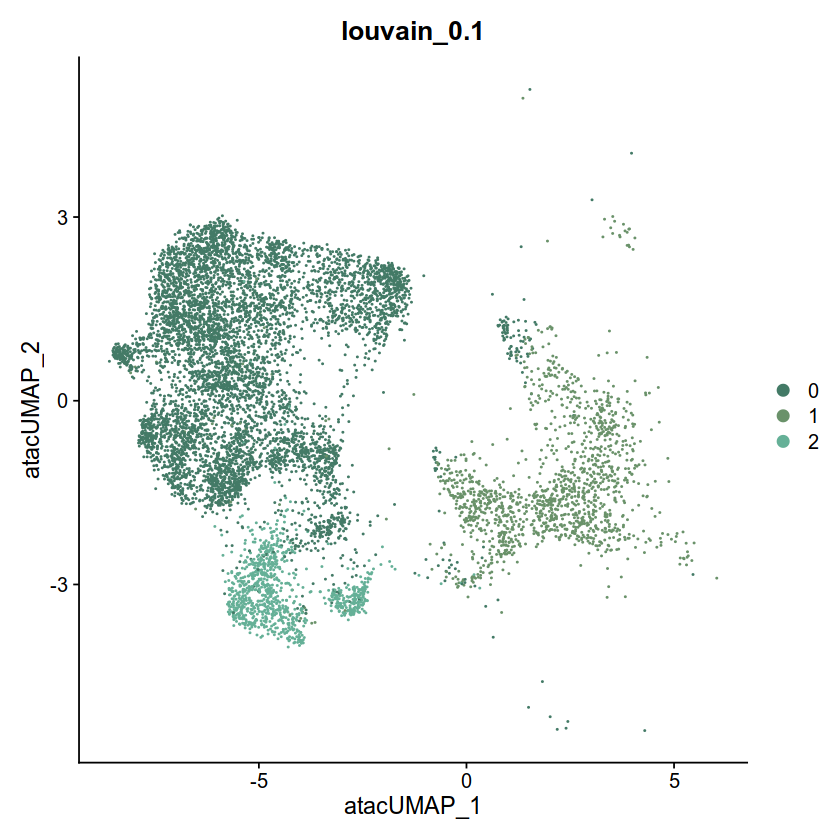

In [82]:
DimPlot(subset_seurat, reduction = "umap", group.by = "peaks_snn_res.0.1",cols = c("#437A66","#6A926A","#65B097")) + ggtitle("louvain_0.1")

In [83]:
table(subset_seurat$CCA_RNA_snn_res.0.2,subset_seurat$peaks_snn_res.0.1)
col<-c("#005084","#4690C2","#9DA7D1")

   
       0    1    2
  0 5499 1416  109
  1  363   27  867
  2  509    4    4
  3  190    4    1

In [84]:
a<-table(subset_seurat$CCA_RNA_snn_res.0.2,subset_seurat$peaks_snn_res.0.1)
new<-t(a)
new2<-data.frame(new)
new2$Freq <- new2$Freq
new
new2

   
       0    1    2    3
  0 5499  363  509  190
  1 1416   27    4    4
  2  109  867    4    1

Var1,Var2,Freq
<fct>,<fct>,<int>
0,0,5499
1,0,1416
2,0,109
0,1,363
1,1,27
2,1,867
0,2,509
1,2,4
2,2,4


[1] 0 1 2 0 1 2 0 1 2 0 1 2
Levels: 0 1 2

png 
  2

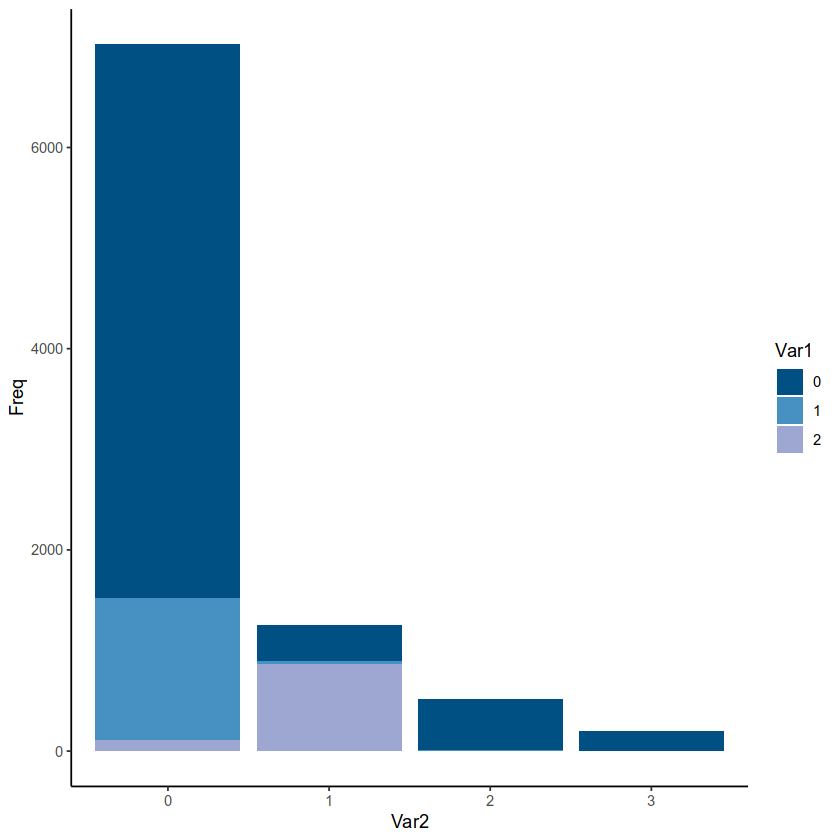

In [85]:
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
new2$Var1
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
pdf("edge.overlap.barplot.scRNA_scATAC.pdf")
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
dev.off()

   
    edge1 edge2 edge3
  0  6426    70    65
  1    43   898   510
  2   971     0    10

Var1,Var2,Freq
<fct>,<fct>,<int>
0,edge1,6426
1,edge1,43
2,edge1,971
0,edge2,70
1,edge2,898
2,edge2,0
0,edge3,65
1,edge3,510
2,edge3,10


png 
  2

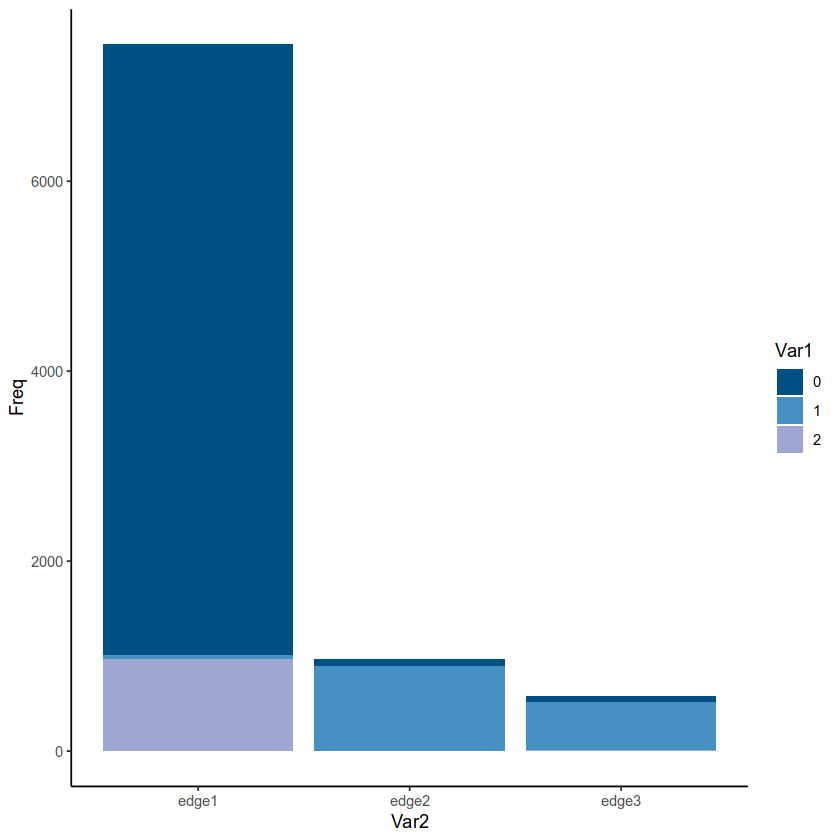

In [86]:
a<-table(subset_seurat$sample,subset_seurat$peaks_snn_res.0.1)
new<-t(a)
new2<-data.frame(new)
new2$Freq <- new2$Freq
new
new2
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
pdf("edge.egde.cluser.absolute.pdf")
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
dev.off()

       
           0    1    2
  edge1 6426   43  971
  edge2   70  898    0
  edge3   65  510   10

   
         edge1      edge2      edge3
  0 0.86370968 0.07231405 0.11111111
  1 0.00577957 0.92768595 0.87179487
  2 0.13051075 0.00000000 0.01709402

Var1,Var2,Freq
<fct>,<fct>,<dbl>
0,edge1,0.86370968
1,edge1,0.00577957
2,edge1,0.13051075
0,edge2,0.07231405
1,edge2,0.92768595
2,edge2,0.00000000
0,edge3,0.11111111
1,edge3,0.87179487
2,edge3,0.01709402


png 
  2

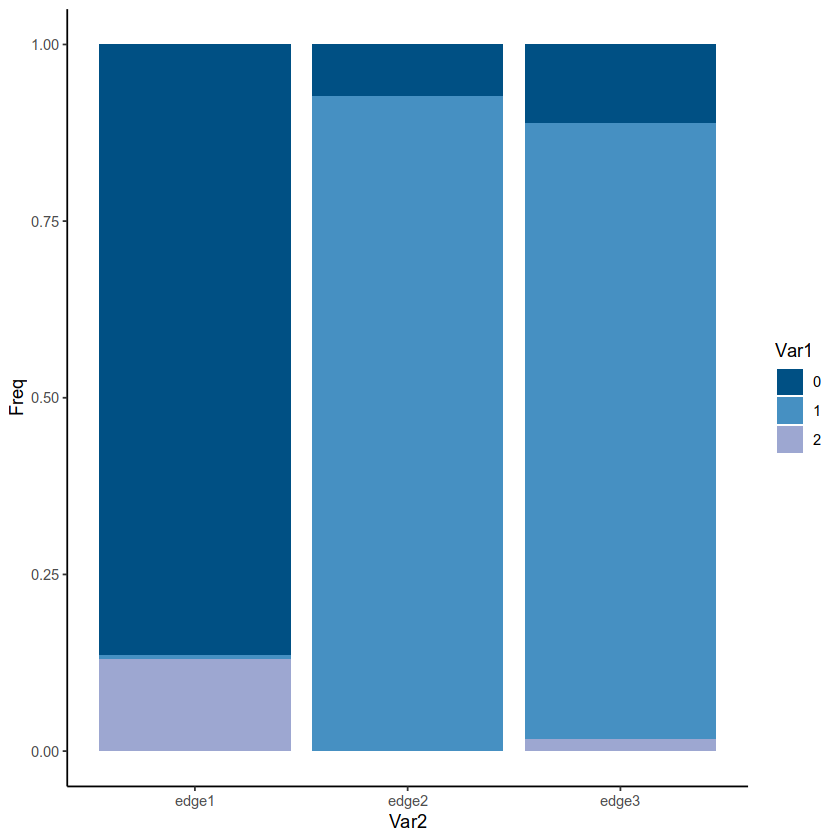

In [87]:
a<-table(subset_seurat$sample,subset_seurat$peaks_snn_res.0.1)
a
new<-t(a/rowSums(a))
new2<-data.frame(new)
new2$Freq <- new2$Freq

new
new2
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
pdf("edge.egde.cluser.percentage.pdf")
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()
dev.off()

In [88]:
a<-table(subset_seurat$sample,subset_seurat$CCA_RNA_snn_res.0.2)
new<-t(a)
new2<-data.frame(new)
new2$Freq <- new2$Freq
new
new2
new2$Var1<-factor(new2$Var1)
new2$Var2<-factor(new2$Var2)
ggplot(new2, aes( y=Freq, x=Var2,fill=Var1))+geom_bar(stat="identity")+scale_fill_manual(values=col)+theme_classic()

   
    edge1 edge2 edge3
  0  5511   962   551
  1  1222     2    33
  2   515     2     0
  3   192     2     1

Var1,Var2,Freq
<fct>,<fct>,<int>
0,edge1,5511
1,edge1,1222
2,edge1,515
3,edge1,192
0,edge2,962
1,edge2,2
2,edge2,2
3,edge2,2
0,edge3,551


ERROR while rich displaying an object: Error in `palette()`:
! Insufficient values in manual scale. 4 needed but only 3 provided.

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
6. repr::mime2repr[[mime]](obj)
7. repr_text.defau

In [89]:
load('/disk1/pengweixing/lene_sc_glio/02.single_cell/03.Edge_analysis/02.quad_meta_model/Neftel.Rdata')
core_matrix = as.matrix(subset_seurat@assays$RNA@data)
core_rankings <- AUCell_buildRankings(core_matrix, nCores=30, plotStats=FALSE)
rm(core_matrix)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 2.5 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


In [90]:
MES2_core_AUC <- AUCell_calcAUC(MES2geneSets, core_rankings)
MES1_core_AUC <- AUCell_calcAUC(MES1geneSets, core_rankings)
NPC1_core_AUC <- AUCell_calcAUC(NPC1geneSets, core_rankings)
NPC2_core_AUC <- AUCell_calcAUC(NPC2geneSets, core_rankings)
AC_core_AUC <- AUCell_calcAUC(ACgeneSets, core_rankings)
OPC_core_AUC <- AUCell_calcAUC(OPCgeneSets, core_rankings)

Genes in the gene sets NOT available in the dataset: 
	MES2: 	1 (2% of 50)

Genes in the gene sets NOT available in the dataset: 
	MES1: 	1 (2% of 50)

Genes in the gene sets NOT available in the dataset: 
	NPC1: 	2 (4% of 50)

Genes in the gene sets NOT available in the dataset: 
	NPC2: 	4 (8% of 50)

Genes in the gene sets NOT available in the dataset: 
	AC: 	1 (3% of 39)

Genes in the gene sets NOT available in the dataset: 
	OPC: 	3 (6% of 50)



In [91]:
core_AUC_list = c('MES1_core_AUC','MES2_core_AUC','NPC1_core_AUC',
                              'NPC2_core_AUC','AC_core_AUC','OPC_core_AUC')
for(each in core_AUC_list){
    AUC <- t(as.data.frame(get(each)@assays@data$AUC))
    colnames(AUC) <- paste0(colnames(AUC), "_AUC")
    AUC <- data.frame(AUC)
    #print(AUC)
    subset_seurat <- AddMetaData(subset_seurat, metadata = AUC)
}

In [92]:
core_meta <- subset_seurat@meta.data

core_meta$MES_mean <- apply(cbind(core_meta$MES1_AUC,core_meta$MES2_AUC),1,mean)
core_meta$NPC_mean <- apply(cbind(core_meta$NPC1_AUC,core_meta$NPC2_AUC),1,mean)
a1 <- apply(cbind(core_meta$OPC_AUC, core_meta$NPC_mean), 1, max)
b1 <- apply(cbind(core_meta$AC_AUC, core_meta$MES_mean), 1, max)
core_meta$Y.axis <-  a1 - b1
core_meta$CellClass <- ifelse(core_meta$Y.axis > 0, "OPC.NPC", "AC.MES")

head(core_meta)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,type,patient,nCount_ATAC_common_peak,nFeature_ATAC_common_peak,nucleosome_signal,⋯,MES1_AUC,MES2_AUC,NPC1_AUC,NPC2_AUC,AC_AUC,OPC_AUC,MES_mean,NPC_mean,Y.axis,CellClass
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
edge1_AAACAGCCAACTGGGA-1,SeuratProject,6194,2890,19810,9014,edge,patient1,10515,9191,0.8999098,⋯,0.2993084,0.12492372,0.09040271,0.1112153,0.1989192,0.1336881,0.2121161,0.10080903,-0.07842794,AC.MES
edge1_AAACAGCCACAATACT-1,SeuratProject,7473,3314,23542,10339,edge,patient1,12518,10555,0.9625954,⋯,0.2998169,0.16059846,0.10820878,0.1465392,0.2705231,0.1451330,0.2302077,0.12737398,-0.12539013,AC.MES
edge1_AAACAGCCACCCACCT-1,SeuratProject,14534,4943,57482,21641,edge,patient1,30292,22022,0.8306525,⋯,0.2774312,0.07227609,0.12579574,0.1622347,0.2490376,0.2101285,0.1748537,0.14401519,-0.03890912,AC.MES
edge1_AAACAGCCAGCATGAG-1,SeuratProject,8014,3750,39418,15806,edge,patient1,20983,16186,0.7486339,⋯,0.3322937,0.14941126,0.04627964,0.1238559,0.2194024,0.1360666,0.2408525,0.08506778,-0.10478589,AC.MES
edge1_AAACAGCCAGCTTACA-1,SeuratProject,12929,5120,67369,24431,edge,patient1,35633,24967,0.7588061,⋯,0.3453115,0.15866612,0.10539487,0.1203560,0.2264480,0.1778427,0.2519888,0.11287544,-0.07414617,AC.MES
edge1_AAACAGCCATAATCAC-1,SeuratProject,14195,4812,11773,5650,edge,patient1,6242,5755,0.8502140,⋯,0.2622099,0.09128302,0.07949303,0.1213903,0.1863242,0.1613465,0.1767464,0.10044169,-0.02497768,AC.MES


In [93]:
cc <- cbind(core_meta$AC_AUC, core_meta$MES_mean, core_meta$NPC_mean, core_meta$OPC_AUC)
colnames(cc) <- c("AC", "MES", "NPC", "OPC")
core_meta$MaxClass <- apply(cc,1,function(x) which(x==max(x)))
core_meta$MaxClass <- gsub(1, "AC", core_meta$MaxClass)
core_meta$MaxClass <- gsub(2, "MES", core_meta$MaxClass)
core_meta$MaxClass <- gsub(3, "NPC", core_meta$MaxClass)
core_meta$MaxClass <- gsub(4, "OPC", core_meta$MaxClass)
    
core_meta$ClassSign_X <- core_meta$MaxClass
core_meta$ClassSign_X <- gsub("AC", -1, core_meta$ClassSign_X )
core_meta$ClassSign_X <- gsub("MES", 1,core_meta$ClassSign_X )
core_meta$ClassSign_X <- gsub("OPC", -1, core_meta$ClassSign_X )
core_meta$ClassSign_X <- gsub("NPC", 1, core_meta$ClassSign_X )

In [94]:
core_meta$OPC.NPC_x <- log(abs(core_meta$OPC_AUC - core_meta$NPC_mean)+1,1.6)
core_meta$AC.MES_x <- log(abs(core_meta$AC_AUC - core_meta$MES_mean)+1,2)
core_meta$X.axis <- NA
core_meta$X.axis[grep("OPC.NPC", core_meta$CellClass)] <- core_meta$OPC.NPC_x[grep("OPC.NPC", core_meta$CellClass)]
core_meta$X.axis[grep("AC.MES", core_meta$CellClass)] <- core_meta$AC.MES_x[grep("AC.MES", core_meta$CellClass)]
#now change the sign based on maxclass for cell
#if AC is the max value, make postive; if MES is the max, make negative
#OPC = +, NPC = -
core_meta$X.axis_Class <- core_meta$X.axis * as.numeric(core_meta$ClassSign_X)

In [95]:
subset_seurat@meta.data

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,type,patient,nCount_ATAC_common_peak,nFeature_ATAC_common_peak,nucleosome_signal,⋯,peaks_snn_res.0.4,peaks_snn_res.0.6,peaks_snn_res.0.8,peaks_snn_res.1,MES1_AUC,MES2_AUC,NPC1_AUC,NPC2_AUC,AC_AUC,OPC_AUC
,<chr>,<dbl>,<int>,<dbl>,<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,⋯,<fct>,<fct>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
edge1_AAACAGCCAACTGGGA-1,SeuratProject,6194,2890,19810,9014,edge,patient1,10515,9191,0.8999098,⋯,1,2,6,5,0.2993084,0.12492372,0.09040271,0.11121535,0.1989192,0.13368814
edge1_AAACAGCCACAATACT-1,SeuratProject,7473,3314,23542,10339,edge,patient1,12518,10555,0.9625954,⋯,5,6,4,4,0.2998169,0.16059846,0.10820878,0.14653918,0.2705231,0.14513299
edge1_AAACAGCCACCCACCT-1,SeuratProject,14534,4943,57482,21641,edge,patient1,30292,22022,0.8306525,⋯,0,0,0,0,0.2774312,0.07227609,0.12579574,0.16223465,0.2490376,0.21012846
edge1_AAACAGCCAGCATGAG-1,SeuratProject,8014,3750,39418,15806,edge,patient1,20983,16186,0.7486339,⋯,4,5,5,6,0.3322937,0.14941126,0.04627964,0.12385591,0.2194024,0.13606660
edge1_AAACAGCCAGCTTACA-1,SeuratProject,12929,5120,67369,24431,edge,patient1,35633,24967,0.7588061,⋯,6,7,9,10,0.3453115,0.15866612,0.10539487,0.12035600,0.2264480,0.17784267
edge1_AAACAGCCATAATCAC-1,SeuratProject,14195,4812,11773,5650,edge,patient1,6242,5755,0.8502140,⋯,3,3,2,2,0.2622099,0.09128302,0.07949303,0.12139034,0.1863242,0.16134654
edge1_AAACATGCAAAGGTAC-1,SeuratProject,6037,2867,26659,11748,edge,patient1,14306,12077,0.8957816,⋯,1,2,6,5,0.2437566,0.08541822,0.12181705,0.13098803,0.2205936,0.16111105
edge1_AAACATGCAACCTGGT-1,SeuratProject,8020,3505,23861,10694,edge,patient1,12741,10945,0.8331090,⋯,5,6,4,4,0.2505820,0.15204421,0.06252883,0.15649768,0.2249517,0.11500194
edge1_AAACATGCAAGCTTAT-1,SeuratProject,11940,4556,27845,11358,edge,patient1,14944,11737,0.9522529,⋯,0,0,5,8,0.2412141,0.09391597,0.14004982,0.13911841,0.2462629,0.20113271


In [96]:
get_density <- function(x, y, ...) {
  dens <- MASS::kde2d(x, y, ...)
  ix <- findInterval(x, dens$x)
  iy <- findInterval(y, dens$y)
  ii <- cbind(ix, iy)
  return(dens$z[ii])
}

Warning message in brewer.pal(11, "Greys"):
"n too large, allowed maximum for palette Greys is 9
Returning the palette you asked for with that many colors
"
Warning message:
"The `size` argument of `element_rect()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead."
Warning message:
"Removed 4 rows containing non-finite values (`stat_density2d()`)."
Warning message:
"Removed 4 rows containing missing values (`geom_point()`)."


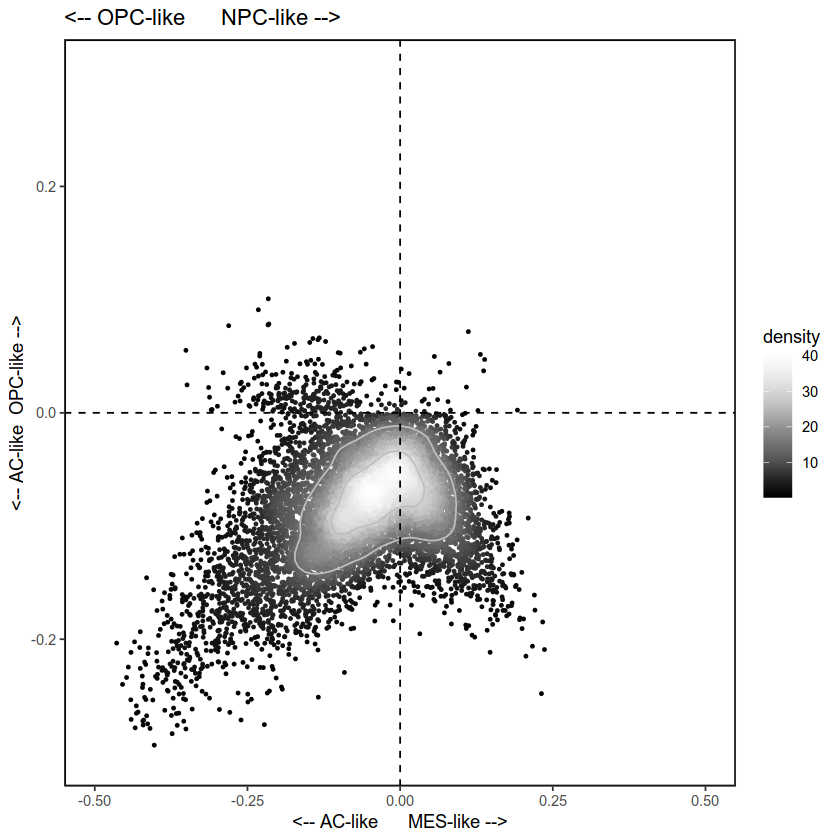

In [97]:
library(RColorBrewer)
core_meta$density <- get_density(core_meta$X.axis_Class, core_meta$Y.axis, n = 100)

core_meta<-as.data.frame(core_meta)
#core_meta$X.axis_Class <- factor(core_meta$X.axis_Class)

d <- ggplot(core_meta, aes(x = X.axis_Class, y = Y.axis, color = density)) +
geom_point(aes(X.axis_Class, Y.axis, color = density), alpha = 1, size = 0.7) + geom_density_2d(bins = 3, color = "grey")+scale_colour_gradientn(colours = rev(colorRampPalette(brewer.pal(11,"Greys"))(31))) +
xlab("<-- AC-like      MES-like -->") +
ylab("<-- AC-like  OPC-like -->") + 
geom_vline(xintercept = 0, lty = 2, col = "black") + 
geom_hline(yintercept = 0, lty = 2, col = "black") + 
ggtitle("<-- OPC-like      NPC-like -->")  +
 theme_bw() +
  theme(panel.grid.major = element_blank(), 
        panel.grid.minor = element_blank(),
        panel.background = element_rect(colour = "black", size=1))+ylim(-0.3,0.3)+xlim(-0.5,0.5)
d

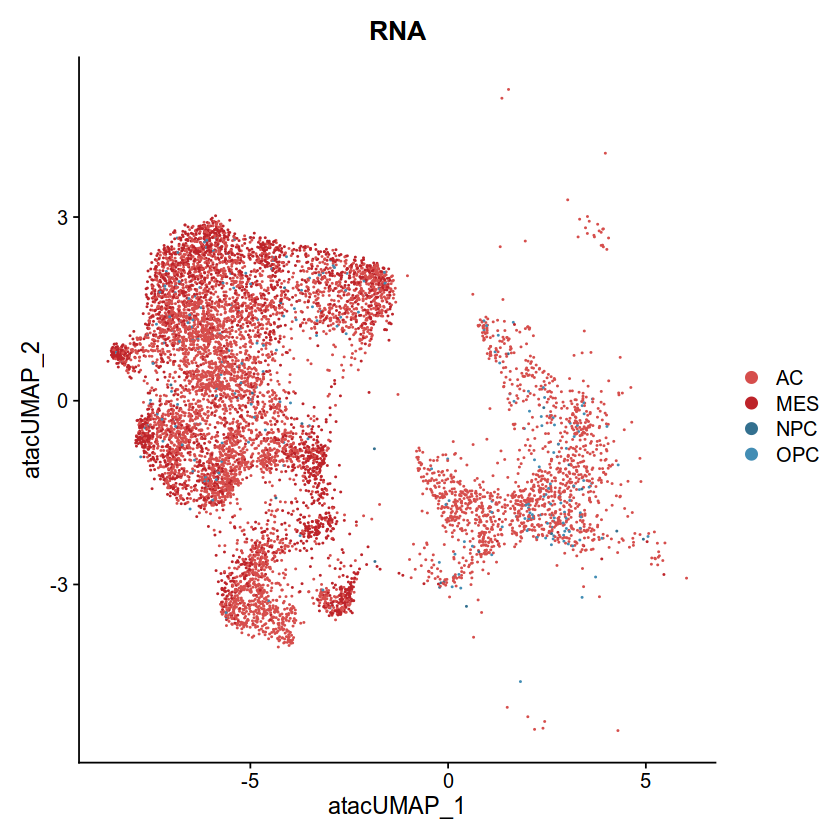

In [98]:
core_meta2<-data.frame(meta=core_meta$MaxClass)
rownames(core_meta2)<-rownames(core_meta)
subset_seurat <- AddMetaData(subset_seurat, metadata = core_meta2)

col<-c("#CA0020","#F4A582","#92C5DE","#0571B0")
col<-c("#F4A582","#CA0020","#0571B0","#92C5DE")
col<-c("#D64E4C","#BD2329","#33708F","#428DB4")

DimPlot(subset_seurat, reduction = "umap", group.by = "meta",cols = col ) + ggtitle("RNA")


In [99]:
table(core_meta$MaxClass,core_meta$peaks_snn_res.0.1)

     
         0    1    2
  AC  4041 1329  699
  MES 2347   14  273
  NPC    8   14    4
  OPC  165   94    5

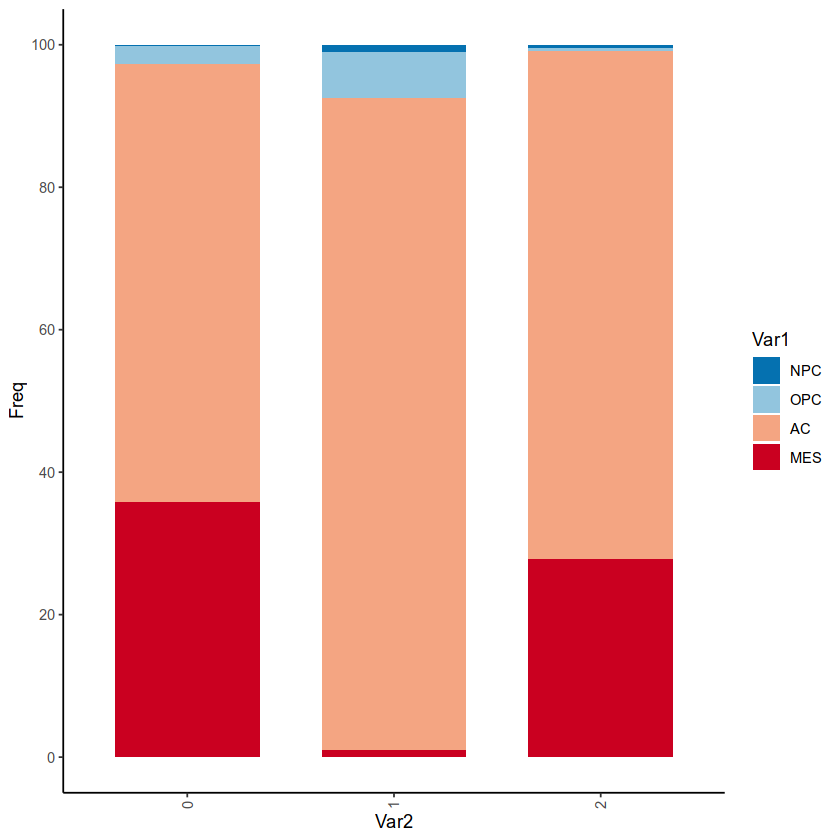

In [100]:
common<-table(core_meta$MaxClass,core_meta$peaks_snn_res.0.1)
new<-t(t(common)/colSums(common))
new2<-data.frame(new)
new2$Freq <- new2$Freq*100
new2$Var1<-factor(new2$Var1,levels=c("NPC","OPC","AC","MES"))
col<-c("#CA0020","#F4A582","#92C5DE","#0571B0")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=c("#0571B0","#92C5DE","#F4A582","#CA0020"))+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))+scale_y_continuous(breaks = round(seq(0, 100, by = 20),1))

In [101]:
pdf("subclusters.meta.modules.edge.pdf")
col<-c("#CA0020","#F4A582","#92C5DE","#0571B0")
ggplot(new2, aes( y=Freq, x=Var2))+scale_fill_manual(values=c("#0571B0","#92C5DE","#F4A582","#CA0020"))+geom_col(aes(fill = Var1 ), width = 0.7)+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))+scale_y_continuous(breaks = round(seq(0, 100, by = 20),1))
dev.off()

png 
  2

In [102]:
save(subset_seurat,file="edge_cells.rdata")

Warning message:
"Could not find NT5E in the default search locations, found in RNA assay instead"
Warning message:
"Could not find NT5E in the default search locations, found in RNA assay instead"


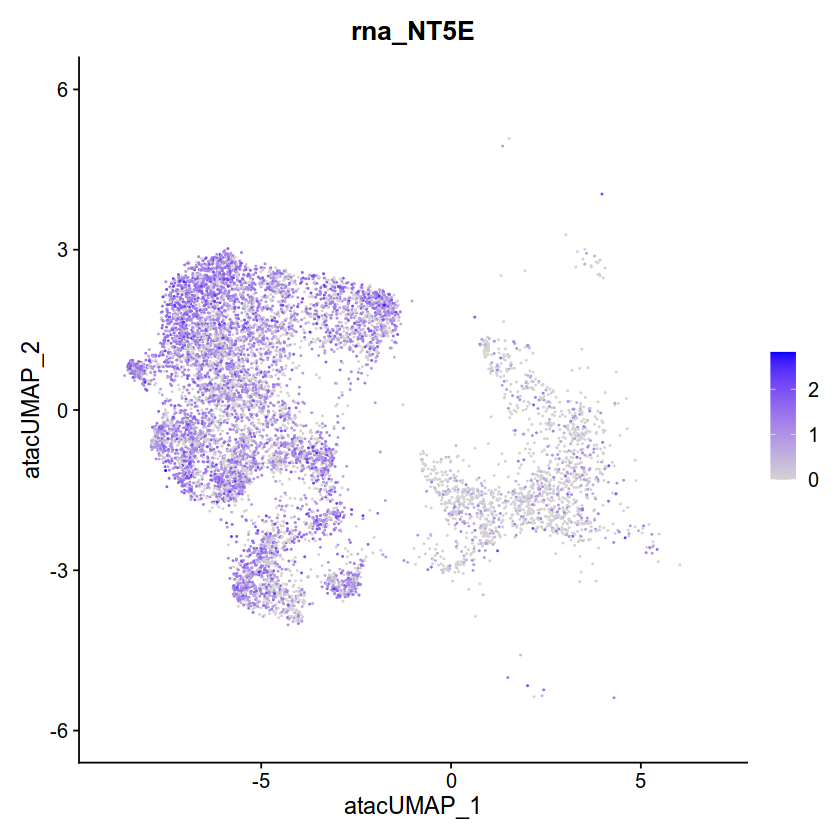

Warning message:
"Could not find NT5E in the default search locations, found in RNA assay instead"


png 
  2

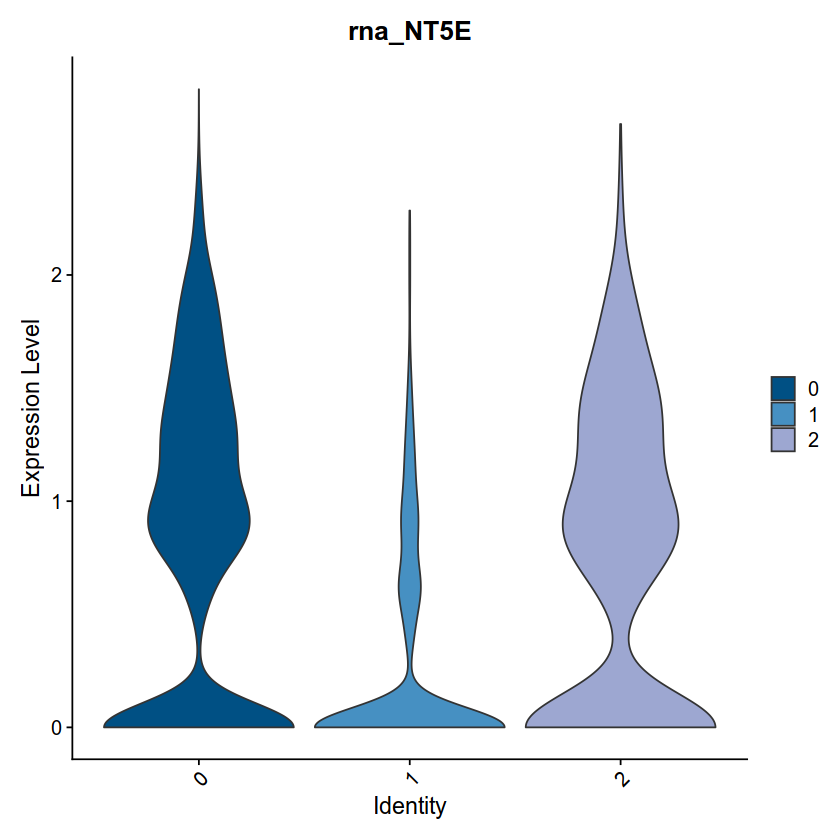

In [103]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
FeaturePlot(subset_seurat, features = 'NT5E',reduction="umap")
VlnPlot(subset_seurat, features = "NT5E",group.by = "peaks_snn_res.0.1",pt.size=0,cols=c("#005084","#4690C2","#9DA7D1"))
pdf("subcluster.edge.nt5e.pdf")
VlnPlot(subset_seurat, features = "NT5E",group.by = "peaks_snn_res.0.1",pt.size=0,cols=c("#005084","#4690C2","#9DA7D1"))
dev.off()

Warning message:
"Could not find OSMR in the default search locations, found in RNA assay instead"
Warning message:
"Could not find OSMR in the default search locations, found in RNA assay instead"


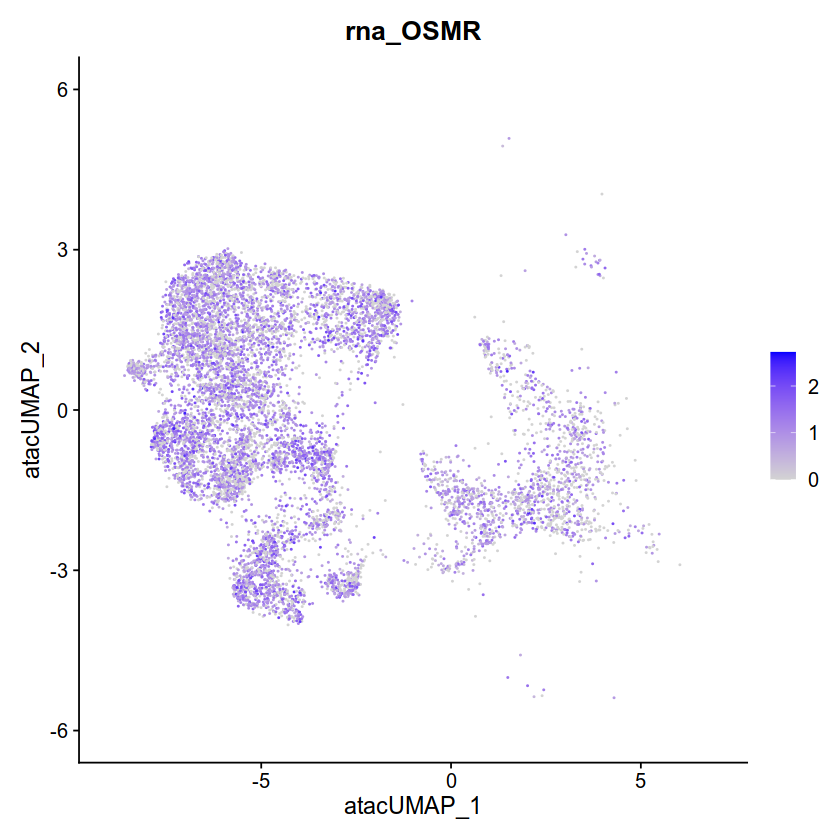

Warning message:
"Could not find OSMR in the default search locations, found in RNA assay instead"


png 
  2

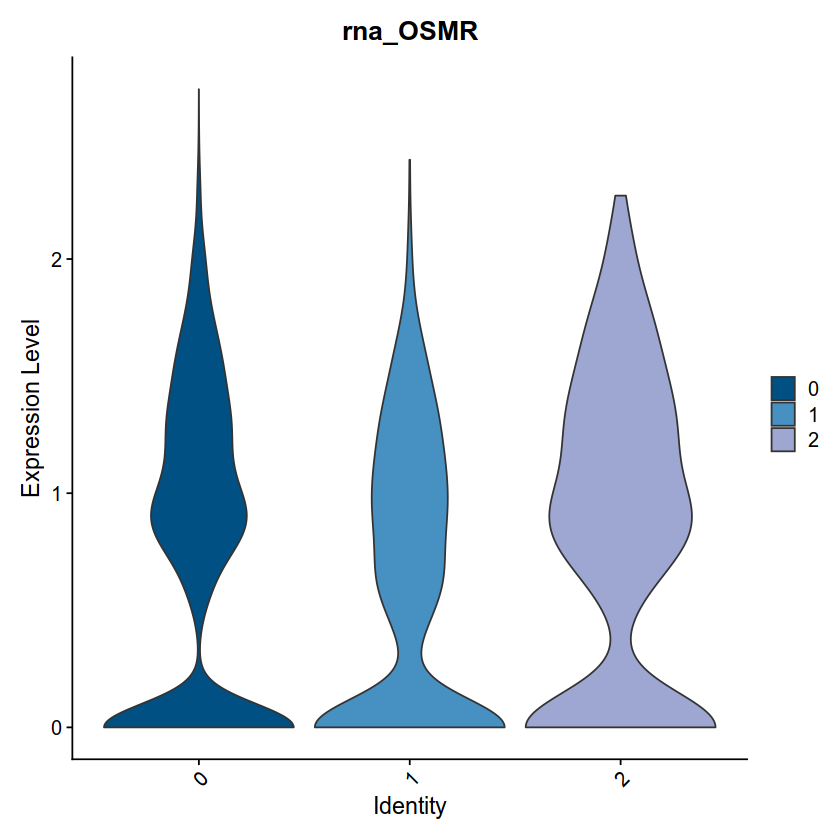

In [104]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
FeaturePlot(subset_seurat, features = 'OSMR',reduction="umap")
VlnPlot(subset_seurat, features = "OSMR",group.by = "peaks_snn_res.0.1",pt.size=0,cols=c("#005084","#4690C2","#9DA7D1"))
pdf("subcluster.edge.osmr.pdf")
VlnPlot(subset_seurat, features = "OSMR",group.by = "peaks_snn_res.0.1",pt.size=0,cols=c("#005084","#4690C2","#9DA7D1"))
dev.off()

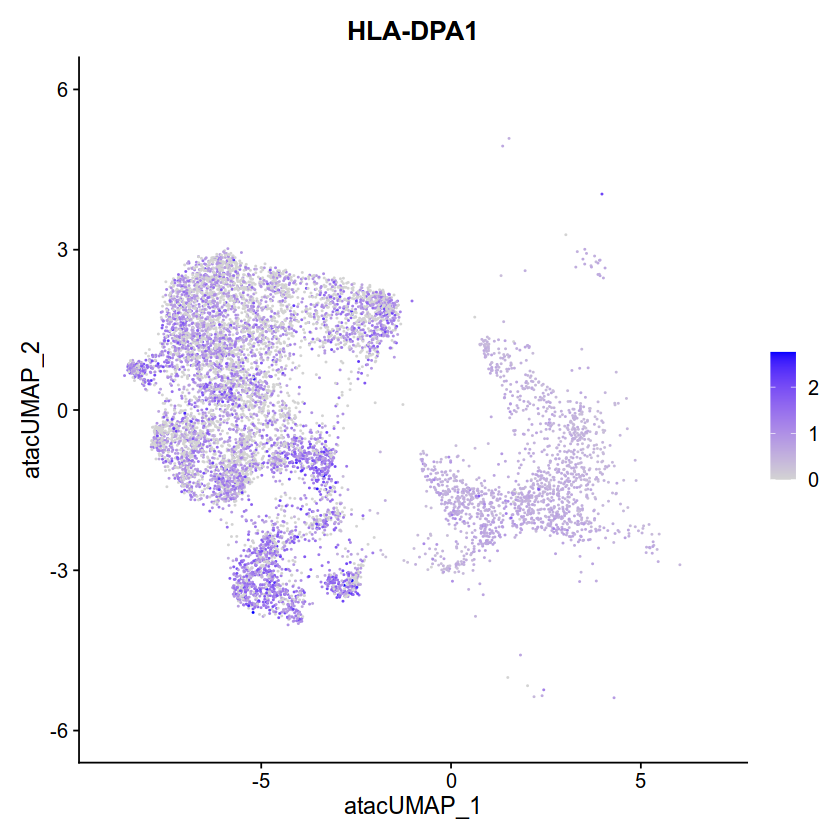

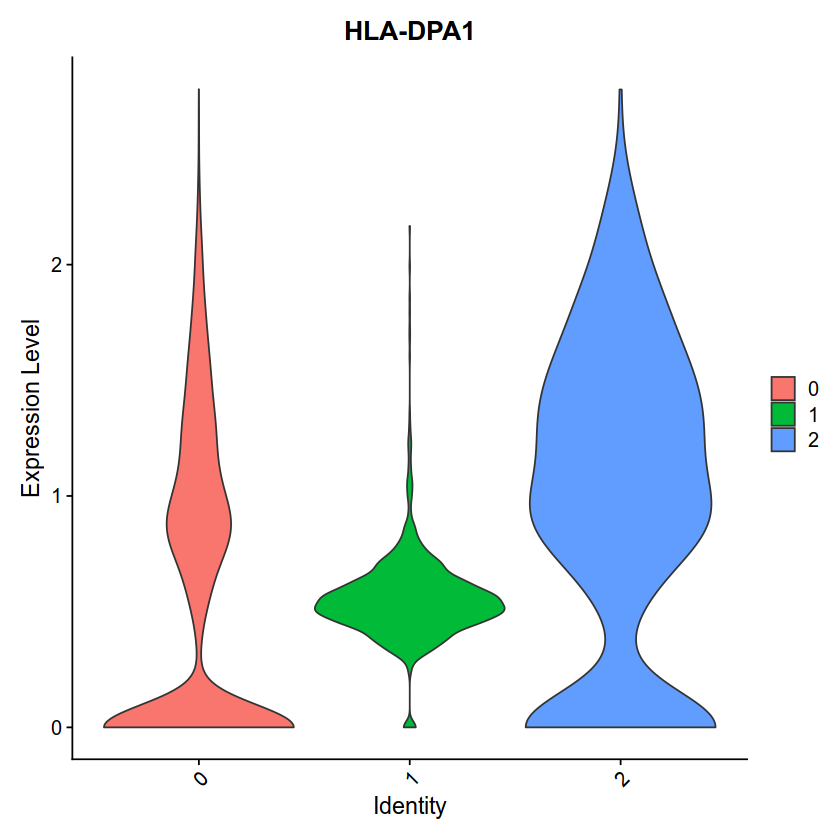

In [105]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
FeaturePlot(subset_seurat, features = 'HLA-DPA1',reduction="umap")
VlnPlot(subset_seurat, features = "HLA-DPA1",group.by = "peaks_snn_res.0.1",pt.size=0)

In [108]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'peaks_snn_res.0.1', assay = 'data', seurat_assay = 'CCA_RNA')
DefaultAssay(subset_seurat) <- "peaks"
markers_motifs <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'peaks_snn_res.0.1', assay = 'data', seurat_assay = 'chromvar')
motif.names <- markers_motifs$feature
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
colnames(markers_motifs) <- paste0("motif.", colnames(markers_motifs))
markers_rna$gene <- markers_rna$RNA.feature
markers_motifs$gene <- ConvertMotifID(subset_seurat, id = motif.names)

In [109]:
DefaultAssay(subset_seurat) <- "peaks"

markers_chromatin <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'peaks_snn_res.0.1', assay = 'data', seurat_assay = 'peaks')


In [110]:
topTFs_chromatin <- function(peaks_snn_res.0.1, padj.cutoff = 0.05) {
  ctmarkers_chromatin <- dplyr::filter(
    markers_chromatin, group == peaks_snn_res.0.1, padj < 0.05, logFC > 0.3,auc > 0.5) 
    top_tfs <- ctmarkers_chromatin
  return(top_tfs)
}

In [111]:
tf1_chromatin<-topTFs_chromatin("0")
tf2_chromatin<-topTFs_chromatin("1")
tf3_chromatin<-topTFs_chromatin("2")

tf_chromatin<-rbind(tf1_chromatin,tf2_chromatin,tf3_chromatin)


In [112]:
library(TxDb.Hsapiens.UCSC.hg38.knownGene)
library(clusterProfiler)
library(ChIPseeker)
library(org.Hs.eg.db)
library(annotate)



clusterProfiler v4.9.0  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use clusterProfiler in published research, please cite:
T Wu, E Hu, S Xu, M Chen, P Guo, Z Dai, T Feng, L Zhou, W Tang, L Zhan, X Fu, S Liu, X Bo, and G Yu. clusterProfiler 4.0: A universal enrichment tool for interpreting omics data. The Innovation. 2021, 2(3):100141


Attaching package: 'clusterProfiler'


The following objects are masked from 'package:plyr':

    arrange, mutate, rename, summarise


The following object is masked from 'package:purrr':

    simplify


The following object is masked from 'package:XVector':

    slice


The following objects are masked from 'package:ensembldb':

    filter, select


The following object is masked from 'package:AnnotationDbi':

    select


The following object is masked from 'package:IRanges':

    slice


The following object is masked from 'package:S4Vectors':

    rename


The following object is masked from 'package:stats':

    filt

In [113]:
split1<-strsplit(tf1_chromatin$feature,split = "-")
split1<-t(data.frame(split1))
split2<-data.frame(split1[,1],as.numeric(split1[,2]),as.numeric(split1[,3]))
input<-split2
cluster2_anno<-data.frame(seqnames=input[,1],start=input[,2],end=input[,3],width=input[,3]-input[,2],strand=rep("*",length(input[,2])))
rownames(cluster2_anno)<-paste(input[,1],input[,2],input[,3],sep="_")
cluster_c<-cluster2_anno
cluster_c_g<-makeGRangesFromDataFrame(cluster_c, keep.extra.columns = TRUE)
anno_LiverMinusHindbrain <- annotatePeak(cluster_c_g,TxDb = TxDb.Hsapiens.UCSC.hg38.knownGene)
anno_LiverMinusHindbrain_GRanges <- as.GRanges(anno_LiverMinusHindbrain)
a<-getSYMBOL(anno_LiverMinusHindbrain_GRanges$geneId, data='org.Hs.eg')
anno_LiverMinusHindbrain_GRanges$genes<-a
b<-anno_LiverMinusHindbrain_GRanges[which(anno_LiverMinusHindbrain_GRanges$distanceToTSS < 100000 & anno_LiverMinusHindbrain_GRanges$distanceToTSS > -100000),]
b$genes
kk2<-enrichKEGG(b$geneId,organism='hsa', pvalueCutoff = 0.05)
kk3<-setReadable(kk2,OrgDb = org.Hs.eg.db,keyType = "ENTREZID")
kk4 <- setReadable(kk2, 'org.Hs.eg.db', 'ENTREZID')
kk4
dotplot(kk4, showCategory=20)

>> preparing features information...		 2023-12-01 06:41:13 AM 
>> identifying nearest features...		 2023-12-01 06:41:15 AM 
>> calculating distance from peak to TSS...	 2023-12-01 06:41:15 AM 
>> assigning genomic annotation...		 2023-12-01 06:41:15 AM 
>> assigning chromosome lengths			 2023-12-01 06:41:42 AM 
>> done...					 2023-12-01 06:41:42 AM 


1953          27245      101928079          10100           5212 
       "MEGF6"        "AHDC1"  "SLC44A3-AS1"       "TSPAN2"          "VIT" 
     105376987         131368      105374016          55764      102724210 
"LOC105376987"        "ZPLD1" "LOC105374016"       "IFT122" "LOC102724210" 
          8821      109729132         153571           9607      102724855 
      "INPP4B"    "LINC02233"      "IRX2-DT"       "CARTPT"    "LINC02113" 
           313          79783          64409          23637           7186 
        "AOAH"        "SUGCT"      "GALNT17"      "RABGAP1"        "TRAF2" 
     105376463      105369527      100874370           2904           3852 
   "LINC02680" "LOC105369527"  "CACNA1C-IT3"       "GRIN2B"         "KRT5" 
          4779 
      "NFE2L1"

Reading KEGG annotation online: "https://rest.kegg.jp/link/hsa/pathway"...

Reading KEGG annotation online: "https://rest.kegg.jp/list/pathway/hsa"...



#
# over-representation test
#
#...@organism 	 hsa 
#...@ontology 	 KEGG 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:26] "1953" "27245" "101928079" "10100" "5212" "105376987" "131368" ...
#...pvalues adjusted by 'BH' with cutoff <0.05 
#...0 enriched terms found
#...Citation
 T Wu, E Hu, S Xu, M Chen, P Guo, Z Dai, T Feng, L Zhou, W Tang, L Zhan, X Fu, S Liu, X Bo, and G Yu.
 clusterProfiler 4.0: A universal enrichment tool for interpreting omics data.
 The Innovation. 2021, 2(3):100141 


Warning message in rep(yes, length.out = len):
"'x' is NULL so the result will be NULL"
ERROR while rich displaying an object: Error in ans[ypos] <- rep(yes, length.out = len)[ypos]: replacement has length zero

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr

>> preparing features information...		 2023-12-01 06:41:54 AM 
>> identifying nearest features...		 2023-12-01 06:41:54 AM 
>> calculating distance from peak to TSS...	 2023-12-01 06:41:54 AM 
>> assigning genomic annotation...		 2023-12-01 06:41:54 AM 
>> assigning chromosome lengths			 2023-12-01 06:41:59 AM 
>> done...					 2023-12-01 06:41:59 AM 


png 
  2

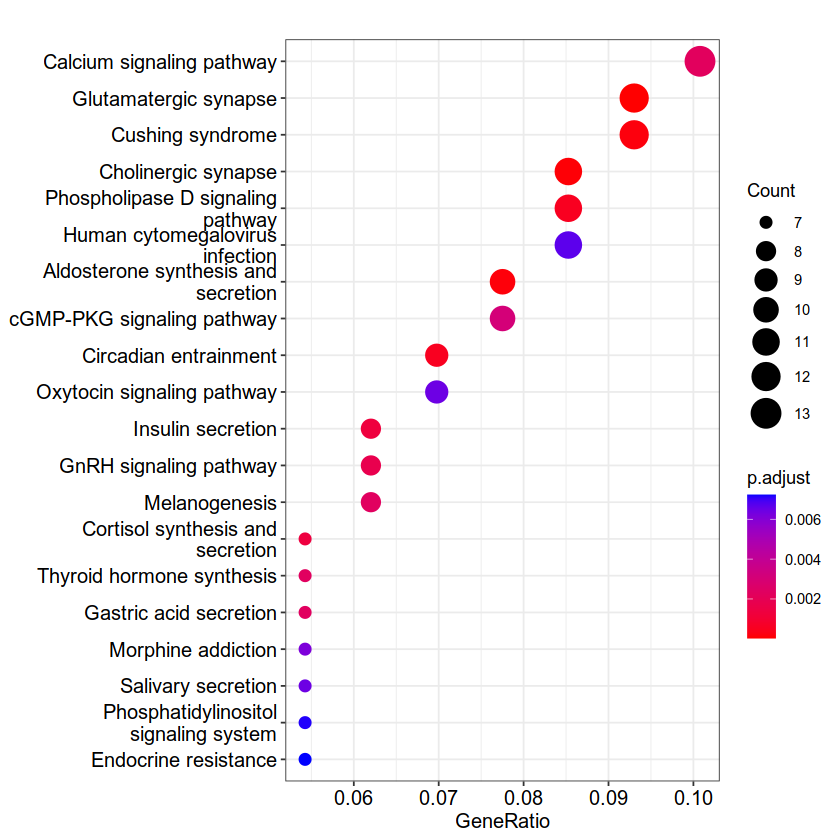

In [114]:
split1<-strsplit(tf2_chromatin$feature,split = "-")
split1<-t(data.frame(split1))
split2<-data.frame(split1[,1],as.numeric(split1[,2]),as.numeric(split1[,3]))
input<-split2
cluster2_anno<-data.frame(seqnames=input[,1],start=input[,2],end=input[,3],width=input[,3]-input[,2],strand=rep("*",length(input[,2])))
rownames(cluster2_anno)<-paste(input[,1],input[,2],input[,3],sep="_")
cluster_c<-cluster2_anno
cluster_c_g<-makeGRangesFromDataFrame(cluster_c, keep.extra.columns = TRUE)
anno_LiverMinusHindbrain <- annotatePeak(cluster_c_g,TxDb = TxDb.Hsapiens.UCSC.hg38.knownGene)
anno_LiverMinusHindbrain_GRanges <- as.GRanges(anno_LiverMinusHindbrain)
a<-getSYMBOL(anno_LiverMinusHindbrain_GRanges$geneId, data='org.Hs.eg')
anno_LiverMinusHindbrain_GRanges$genes<-a
b<-anno_LiverMinusHindbrain_GRanges[which(anno_LiverMinusHindbrain_GRanges$distanceToTSS < 100000 & anno_LiverMinusHindbrain_GRanges$distanceToTSS > -100000),]
kk2<-enrichKEGG(b$geneId,organism='hsa', pvalueCutoff = 0.05)
kk3<-setReadable(kk2,OrgDb = org.Hs.eg.db,keyType = "ENTREZID")
kk4 <- setReadable(kk2, 'org.Hs.eg.db', 'ENTREZID')
dotplot(kk4, showCategory=20)
pdf("edge.cluster2.pdf")
dotplot(kk4, showCategory=20)
dev.off()

In [115]:
split1<-strsplit(tf3_chromatin$feature,split = "-")
split1<-t(data.frame(split1))
split2<-data.frame(split1[,1],as.numeric(split1[,2]),as.numeric(split1[,3]))
input<-split2
cluster2_anno<-data.frame(seqnames=input[,1],start=input[,2],end=input[,3],width=input[,3]-input[,2],strand=rep("*",length(input[,2])))
rownames(cluster2_anno)<-paste(input[,1],input[,2],input[,3],sep="_")
cluster_c<-cluster2_anno
cluster_c_g<-makeGRangesFromDataFrame(cluster_c, keep.extra.columns = TRUE)
anno_LiverMinusHindbrain <- annotatePeak(cluster_c_g,TxDb = TxDb.Hsapiens.UCSC.hg38.knownGene)
anno_LiverMinusHindbrain_GRanges <- as.GRanges(anno_LiverMinusHindbrain)
a<-getSYMBOL(anno_LiverMinusHindbrain_GRanges$geneId, data='org.Hs.eg')
anno_LiverMinusHindbrain_GRanges$genes<-a
b<-anno_LiverMinusHindbrain_GRanges[which(anno_LiverMinusHindbrain_GRanges$distanceToTSS < 100000 & anno_LiverMinusHindbrain_GRanges$distanceToTSS > -100000),]
b$genes
kk2<-enrichKEGG(b$geneId,organism='hsa', pvalueCutoff = 0.05)
kk3<-setReadable(kk2,OrgDb = org.Hs.eg.db,keyType = "ENTREZID")
kk4 <- setReadable(kk2, 'org.Hs.eg.db', 'ENTREZID')
dotplot(kk4, showCategory=30)

>> preparing features information...		 2023-12-01 06:42:00 AM 
>> identifying nearest features...		 2023-12-01 06:42:00 AM 
>> calculating distance from peak to TSS...	 2023-12-01 06:42:01 AM 
>> assigning genomic annotation...		 2023-12-01 06:42:01 AM 
>> assigning chromosome lengths			 2023-12-01 06:42:06 AM 
>> done...					 2023-12-01 06:42:06 AM 


727684          127707           23065          388630            5563 
   "TMEM51-AS2"       "KLHDC7A"          "EMC1"       "TRABD2B"        "PRKAA2" 
          57554           56944       102723321           25903       100505918 
        "LRRC7"        "OLFML3"  "LOC102723321"       "OLFML2B"  "LOC100505918" 
         730159       102724830       105371664       105372893       106481171 
        "TEX50"  "LOC102724830"  "LOC105371664"     "LINC01717"   "RNU6ATAC35P" 
      101927532            3775          148641       107985365            3241 
    "LINC01736"         "KCNK1"       "SLC35F3"  "LOC107985365"        "HPCAL1" 
           8884            2492             822          130507       102724224 
       "SLC5A6"          "FSHR"          "CAPG"          "UBR3"     "LINC01117" 
           5510           55207             491            1233           11280 
       "PPP1R7"         "ARL8B"        "ATP2B2"          "CCR4"        "SCN11A" 
         406929       105377098             868       105374060       101927866 
     "MIR138-1"     "LINC02030"          "CBLB"  "LOC105374060"     "LINC02010" 
         151790            8975          152992            3166            3166 
        "WDR49"         "USP13"        "TRMT44"          "HMX1"          "HMX1" 
      105369250       101929472       105378969       105379040          153241 
 "LOC105369250" "CTD-2350J17.1"  "LOC105378969"  "LOC105379040"        "CEP120" 
           6695           57451       105377740            3274       100422737 
       "SPOCK1"         "TENM2"  "LOC105377740"          "HRH2"     "LINC02532" 
           8701       105375283       105375341       105375553       100506585 
       "DNAH11"  "GS1-278J22.2"  "LOC105375341"  "LOC105375553"    "PTPRN2-AS1" 
      105375613           26578           29968          389765       102724929 
 "LOC105375613"         "OSTF1"         "PSAT1"     "LOC389765"  "LOC102724929" 
           1620           79109            1289       105369606           56899 
       "BRINP1"       "MAPKAP1"        "COL5A1"     "LINC02827"        "ANKS1B" 
           4842          283455       100507206       100506530           51285 
         "NOS1"          "KSR2"     "LINC00943"     "LINC02349"        "RASL12" 
      105371011          283777           54715           54715           54715 
    "LINC02351"      "FAM169BP"        "RBFOX1"        "RBFOX1"        "RBFOX1" 
          54715           54715          729993          729993           91862 
       "RBFOX1"        "RBFOX1"        "SHISA9"        "SHISA9"      "MARVELD3" 
            463       105371342       105371342       107984856           80790 
        "ZFHX3"  "LOC105371342"  "LOC105371342"  "LOC107984856"          "CMIP" 
      101154687          732275           56934          400620       105372363 
    "LINC01081"     "LINC00917"          "CA10"     "LINC02092"     "LINC01837" 
           9935          140690       100506403            3763            7109 
         "MAFB"         "CTCFL"  "LOC100506403"         "KCNJ6"      "TRAPPC10" 
         406898 
     "MIR105-2"

Warning message in rep(yes, length.out = len):
"'x' is NULL so the result will be NULL"
ERROR while rich displaying an object: Error in ans[ypos] <- rep(yes, length.out = len)[ypos]: replacement has length zero

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr

In [116]:
b$geneId
write.table(b$geneId,file="chromatin.edge.3.xls",quote=F,row.names=F)

[1] "727684"    "127707"    "23065"     "388630"    "5563"      "57554"    
 [7] "56944"     "102723321" "25903"     "100505918" "730159"    "102724830"
[13] "105371664" "105372893" "106481171" "101927532" "3775"      "148641"   
[19] "107985365" "3241"      "8884"      "2492"      "822"       "130507"   
[25] "102724224" "5510"      "55207"     "491"       "1233"      "11280"    
[31] "406929"    "105377098" "868"       "105374060" "101927866" "151790"   
[37] "8975"      "152992"    "3166"      "3166"      "105369250" "101929472"
[43] "105378969" "105379040" "153241"    "6695"      "57451"     "105377740"
[49] "3274"      "100422737" "8701"      "105375283" "105375341" "105375553"
[55] "100506585" "105375613" "26578"     "29968"     "389765"    "102724929"
[61] "1620"      "79109"     "1289"      "105369606" "56899"     "4842"     
[67] "283455"    "100507206" "100506530" "51285"     "105371011" "283777"   
[73] "54715"     "54715"     "54715"     "54715"     "54715"     "729993"   
[79] "729993"    "91862"     "463"       "105371342" "105371342" "107984856"
[85] "80790"     "101154687" "732275"    "56934"     "400620"    "105372363"
[91] "9935"      "140690"    "100506403" "3763"      "7109"      "406898"

In [117]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/5.figure"

In [118]:
topTFs <- function(peaks_snn_res.0.1, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == peaks_snn_res.0.1, RNA.padj < padj.cutoff, RNA.logFC > 0.1,RNA.auc>0.1 )
#    %>% 
#    arrange(-RNA.auc)
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == peaks_snn_res.0.1, motif.padj < padj.cutoff, motif.logFC > 0.1,motif.auc > 0.1) 
#    %>% 
#    arrange(-motif.auc)
  top_tfs <- inner_join(
    x = ctmarkers_rna[, c(2, 11, 6, 7)], 
    y = ctmarkers_motif[, c(2, 1, 11, 6, 7)], by = "gene"
  )
  top_tfs$avg_auc <- (top_tfs$RNA.auc + top_tfs$motif.auc) / 2
  top_tfs <- arrange(top_tfs, -avg_auc)
  return(top_tfs)
}

In [119]:
topTFs_rna <- function(peaks_snn_res.0.1, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == peaks_snn_res.0.1, RNA.padj < 0.01, RNA.logFC > 0.5,RNA.auc>0.6 ) 
  top_tfs <- ctmarkers_rna
  return(top_tfs)
}

In [120]:
topTFs_motif <- function(peaks_snn_res.0.1, padj.cutoff = 0.01) {
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == peaks_snn_res.0.1, motif.padj < padj.cutoff, motif.logFC > 0.5,motif.auc > 0.6) 
  top_tfs <- ctmarkers_motif
  return(top_tfs)
}

In [121]:
tf1_c2<-topTFs("0")
tf2_c2<-topTFs("1")
tf3_c2<-topTFs("2")


tf_c2<-rbind(tf1_c2,tf2_c2,tf3_c2)

In [122]:
tf_c2

RNA.group,gene,RNA.auc,RNA.pval,motif.group,motif.feature,motif.auc,motif.pval,avg_auc
<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>
0,NR3C2,0.5289342,1.930889e-05,0,MA0727.1,0.5707880,5.232809e-25,0.5498611
0,TP63,0.3911202,3.105646e-77,0,MA0525.2,0.6469843,4.946590e-102,0.5190523
2,ETV1,0.5913806,1.747192e-21,2,MA0761.2,0.5452033,3.673988e-06,0.5682920


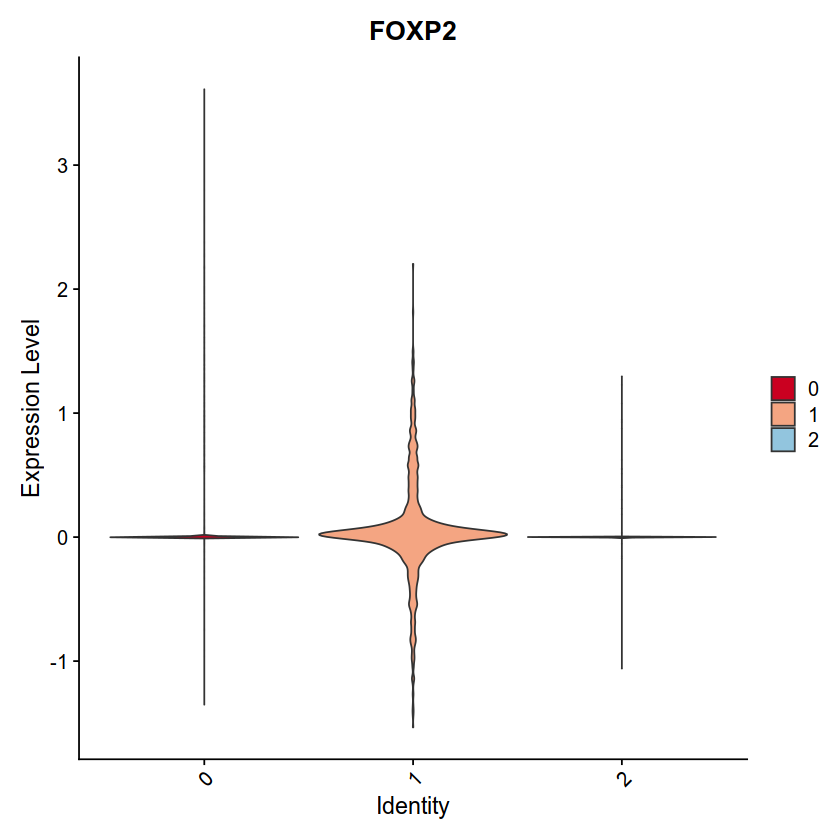

In [123]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "FOXP2",group.by = "peaks_snn_res.0.1",cols=col,pt.size=0)

Warning message:
"Could not find OSMR in the default search locations, found in RNA assay instead"


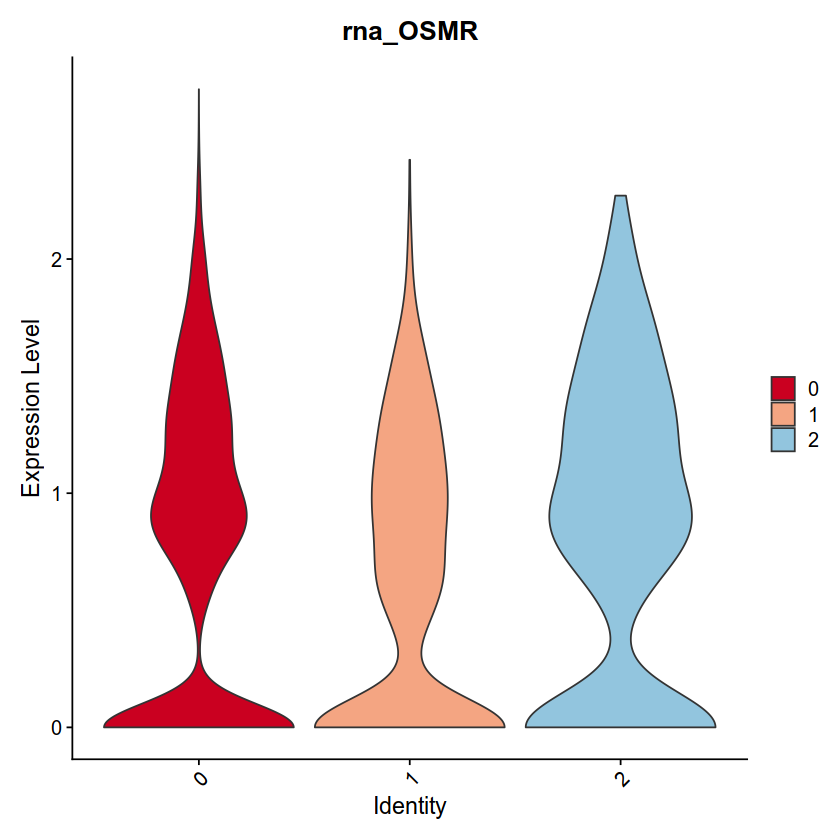

In [124]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "OSMR",group.by = "peaks_snn_res.0.1",cols=col,pt.size=0)

Warning message:
"Could not find LIFR in the default search locations, found in RNA assay instead"


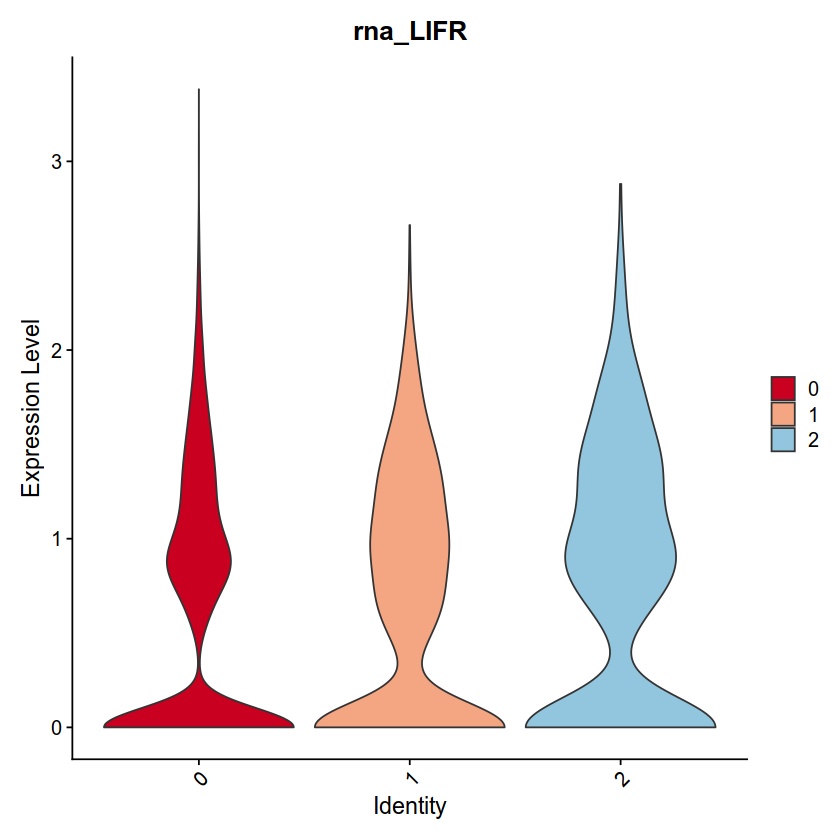

In [125]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "LIFR",group.by = "peaks_snn_res.0.1",cols=col,pt.size=0)

Warning message:
"Could not find IL6ST in the default search locations, found in RNA assay instead"


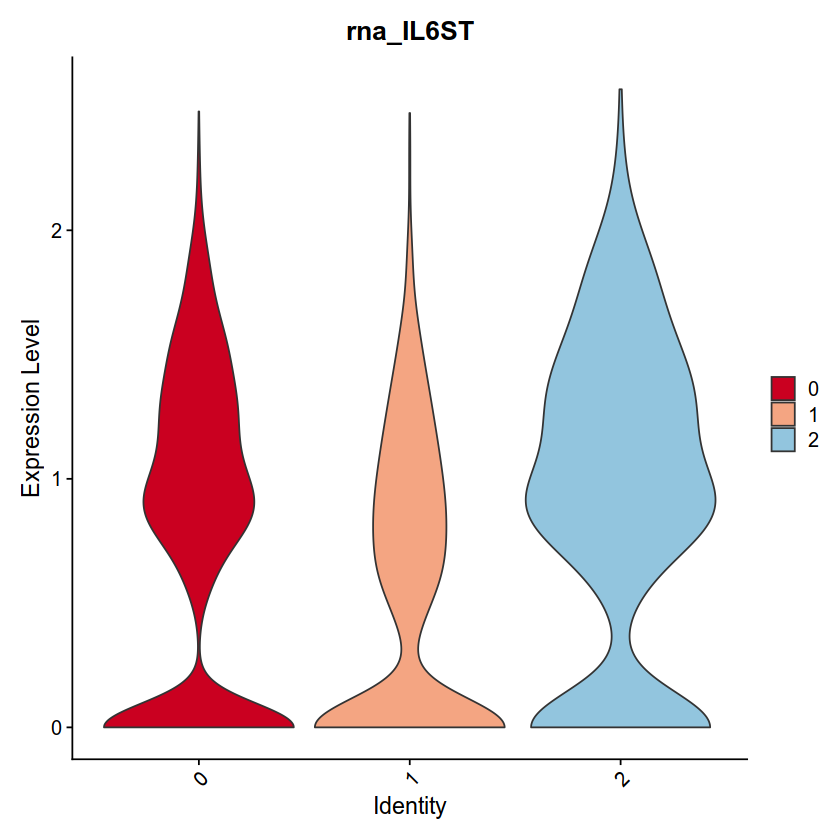

In [126]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "IL6ST",group.by = "peaks_snn_res.0.1",cols=col,pt.size=0)

Warning message:
"Could not find NF1 in the default search locations, found in RNA assay instead"


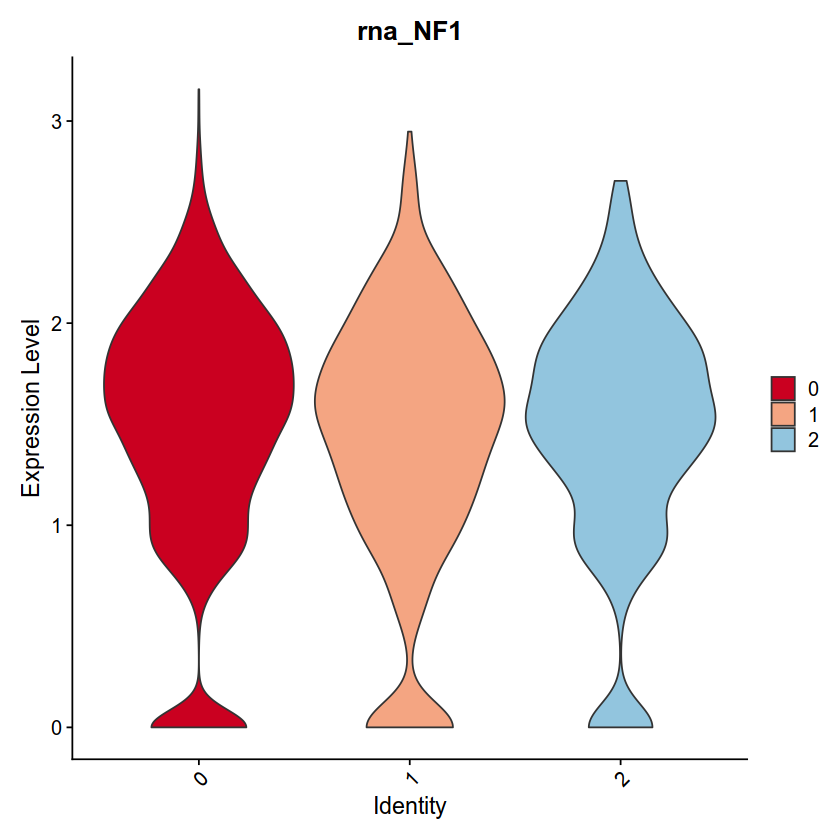

In [127]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "NF1",group.by = "peaks_snn_res.0.1",cols=col,pt.size=0)

In [128]:
DefaultAssay(glio.int) <- "CCA_RNA"
#DotPlot(object = subset_seurat, features = unique(tf_c2$gene),group.by = "peaks_snn_res.0.1")+coord_flip() 

In [129]:
tf1_rna<-topTFs_rna("0")
tf2_rna<-topTFs_rna("1")
tf3_rna<-topTFs_rna("2")
tf4_rna<-topTFs_rna("3")
tf5_rna<-topTFs_rna("4")

tf_rna<-rbind(tf1_rna,tf2_rna,tf3_rna,tf4_rna,tf5_rna)

In [130]:
tf1_motif<-topTFs_motif("0")
tf2_motif<-topTFs_motif("1")
tf3_motif<-topTFs_motif("2")

tf_motif<-rbind(tf1_motif,tf2_motif,tf3_motif)

In [131]:
write.table(tf_motif,file="tf.motif.subcluster.without.core.xls ",quote=F,sep="\t",row.names=F)

In [132]:
#tf_chromatin
write.table(tf_chromatin,file="chromatin.subcluster.xls",quote=F,sep="\t",row.names=F)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


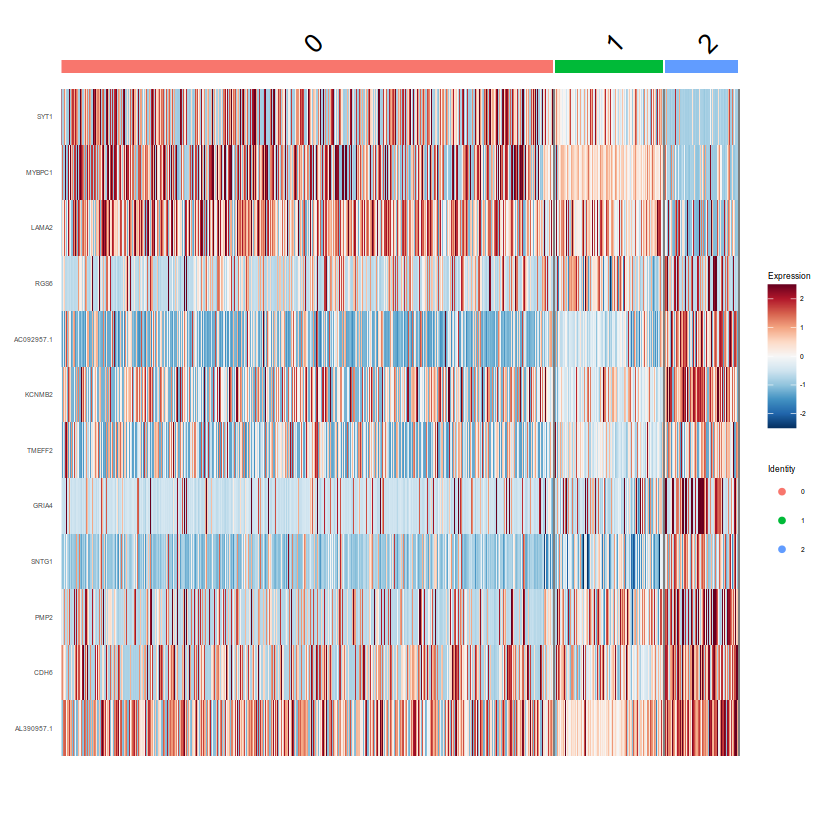

In [133]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(subset_seurat, features = as.character(tf_rna$RNA.feature), group.by = "peaks_snn_res.0.1")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

In [134]:
pdf("edge.cluster.rna.heatmap.pdf")

#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(subset_seurat, features = as.character(tf_rna$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))
dev.off()

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

In [135]:
library(ComplexHeatmap)
library(pheatmap)
library( "RColorBrewer" )
annotation<-data.frame(glio.int.kmeans_3=subset_seurat$`peaks_snn_res.0.1`)
rownames(annotation)<-names(subset_seurat$`peaks_snn_res.0.1`)
#annotation<-NULL
annotation$glio.int.kmeans_3<-factor(subset_seurat$`peaks_snn_res.0.1`)
#color = colorRampPalette(brewer.pal(3,"RdBu"))(21)
color <- colorRampPalette(RColorBrewer::brewer.pal(7,"RdBu"))(21)
breaks<-seq(-1.5,1.5,by=0.15)

ComplexHeatmap version 2.14.0
Bioconductor page: http://bioconductor.org/packages/ComplexHeatmap/
Github page: https://github.com/jokergoo/ComplexHeatmap
Documentation: http://jokergoo.github.io/ComplexHeatmap-reference

If you use it in published research, please cite either one:
- Gu, Z. Complex Heatmap Visualization. iMeta 2022.
- Gu, Z. Complex heatmaps reveal patterns and correlations in multidimensional 
    genomic data. Bioinformatics 2016.


The new InteractiveComplexHeatmap package can directly export static 
complex heatmaps into an interactive Shiny app with zero effort. Have a try!

This message can be suppressed by:
  suppressPackageStartupMessages(library(ComplexHeatmap))



Attaching package: 'pheatmap'


The following object is masked from 'package:ComplexHeatmap':

    pheatmap




In [136]:
annotation3<-data.frame(group=annotation[order(annotation$glio.int.kmeans_3),])
rownames(annotation3)<-rownames(annotation)[order(annotation$glio.int.kmeans_3)]
#annotation3$group<-factor(annotation3$group)


In [137]:
#chromatin 
DefaultAssay(subset_seurat) <- "peaks"

s<-as.matrix(subset_seurat@assays$peaks@data[tf_chromatin$feature,])
s2<-as.matrix(s[,rownames(annotation3)])



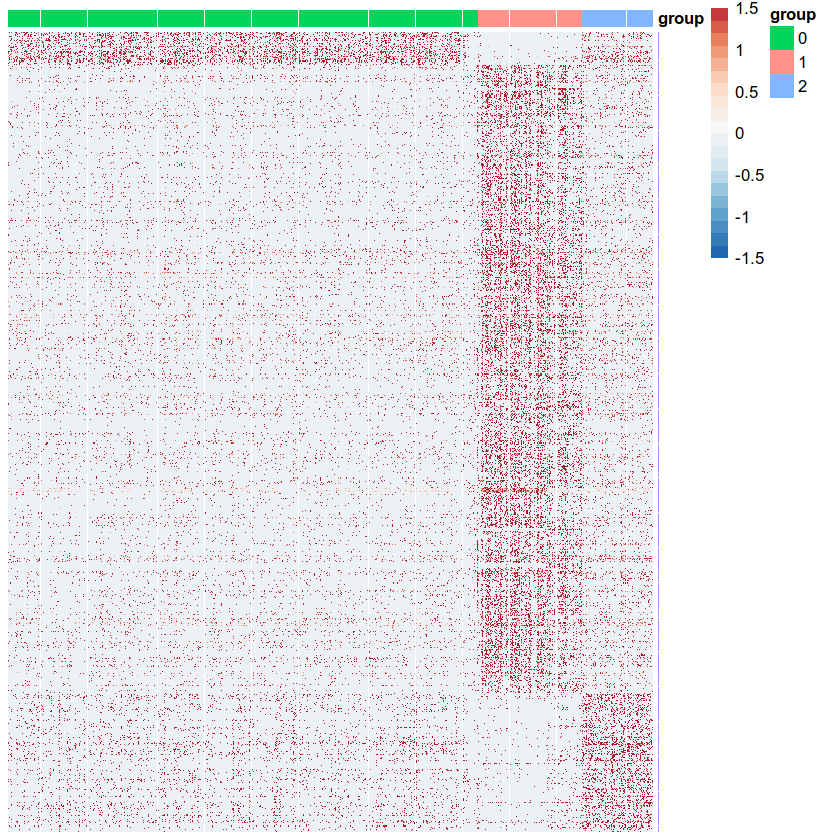

png 
  2

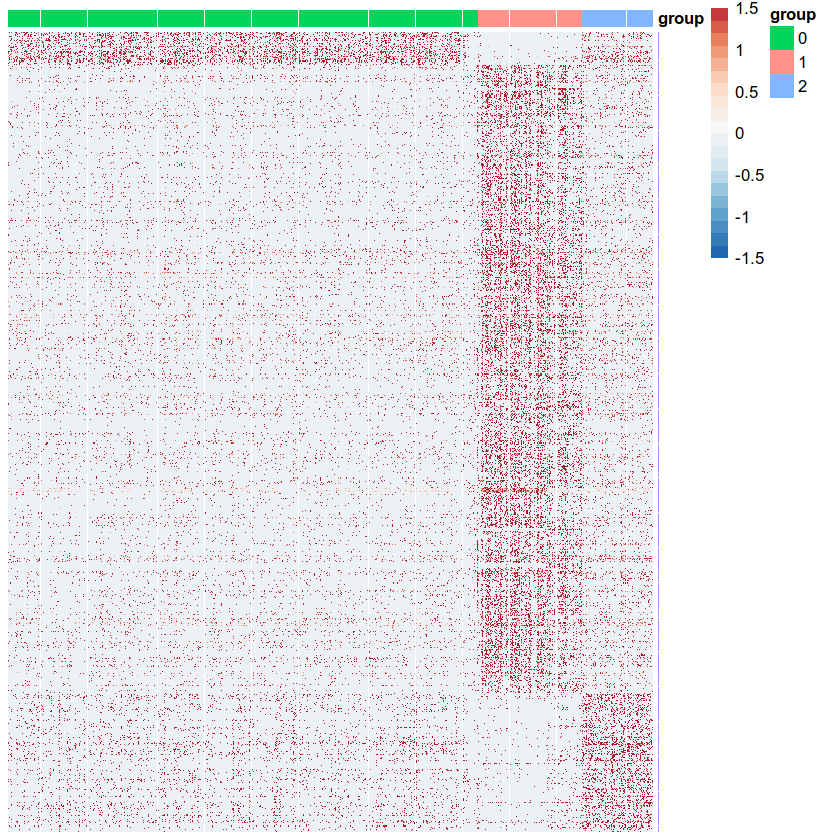

In [138]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="none",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)
fig<-pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="none",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)
pdf("chromatin.edge.heatmap.pdf")
fig
dev.off()

png 
  2

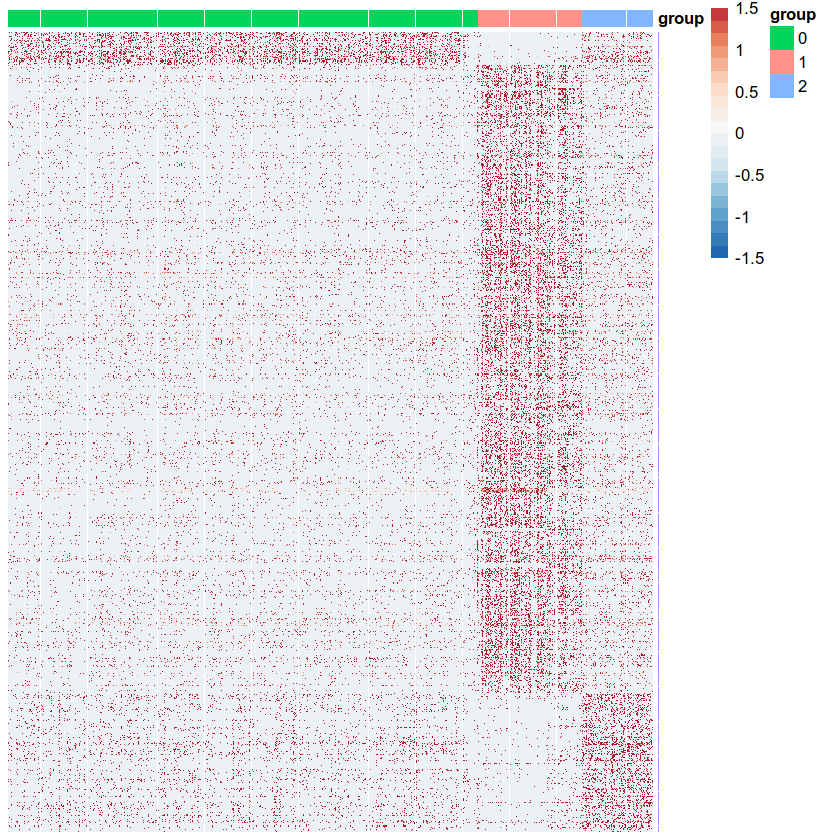

In [139]:
m<-pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="none",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)
pdf("heatmap.chroamtin.accessibility.edge.pdf")
m
dev.off()

In [140]:
DefaultAssay(glio.int) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X =subset_seurat , group_by = 'peaks_snn_res.0.1', assay = 'data', seurat_assay = 'CCA_RNA')
DefaultAssay(glio.int) <- "peaks"
markers_motifs <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'peaks_snn_res.0.1', assay = 'data', seurat_assay = 'chromvar')
motif.names <- markers_motifs$feature
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
colnames(markers_motifs) <- paste0("motif.", colnames(markers_motifs))
markers_rna$gene <- markers_rna$RNA.feature
markers_motifs$gene <- ConvertMotifID(glio.int, id = motif.names)

In [141]:
topTFs_motif <- function(peaks_snn_res.0.1, padj.cutoff = 0.01) {
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == peaks_snn_res.0.1, motif.padj < padj.cutoff, motif.logFC > 0.5,motif.auc > 0.6) 
  top_tfs <- ctmarkers_motif
  return(top_tfs)
}

In [142]:
topTFs_rna <- function(peaks_snn_res.0.1, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == peaks_snn_res.0.1, RNA.padj < 0.01, RNA.logFC > 0.5,RNA.auc>0.5 ) 
  top_tfs <- ctmarkers_rna
  return(top_tfs)
}

In [143]:
tf1_motif<-topTFs_motif("0")
tf2_motif<-topTFs_motif("1")
tf3_motif<-topTFs_motif("2")

tf_motif<-rbind(tf1_motif,tf2_motif,tf3_motif)

In [144]:
tf1_rna<-topTFs_rna("0")
tf2_rna<-topTFs_rna("1")
tf3_rna<-topTFs_rna("2")
tf4_rna<-topTFs_rna("3")
tf5_rna<-topTFs_rna("4")

tf_rna<-rbind(tf1_rna,tf2_rna,tf3_rna,tf4_rna,tf5_rna)

In [145]:
tf_rna

RNA.feature,RNA.group,RNA.avgExpr,RNA.logFC,RNA.statistic,RNA.auc,RNA.pval,RNA.padj,RNA.pct_in,RNA.pct_out,gene
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
SYT1,0,1.012932,0.5509924,10358814,0.6491969,8.160525e-110,1.038896e-109,65.00533,63.85691,SYT1
MYBPC1,0,1.280402,0.5705494,10475474,0.6565080,2.443013e-118,3.142138e-118,70.49230,71.38158,MYBPC1
LAMA2,0,1.688765,0.5732862,10640990,0.6668811,1.616675e-131,2.114683e-131,85.68816,78.33059,LAMA2
RGS6,2,1.315326,0.6291656,4882606,0.6212148,5.989314e-39,2.079623e-38,61.56983,53.33250,RGS6
AC092957.1,2,1.638217,0.9372678,5915880,0.7526783,7.911765e-161,3.955882e-158,83.28236,53.05791,AC092957.1
KCNMB2,2,1.753274,0.7744897,5640720,0.7176696,2.428410e-112,4.856820e-110,86.54434,70.86870,KCNMB2
TMEFF2,2,1.653294,0.5129825,4951347,0.6299606,3.957918e-41,1.786871e-40,78.79715,73.06540,TMEFF2
GRIA4,2,1.021141,0.8257521,5943028,0.7561324,1.381057e-211,1.381057e-208,68.39959,29.90514,GRIA4
SNTG1,2,1.337671,0.8532115,5475397,0.6966356,4.059228e-110,7.380415e-108,66.56473,40.21468,SNTG1


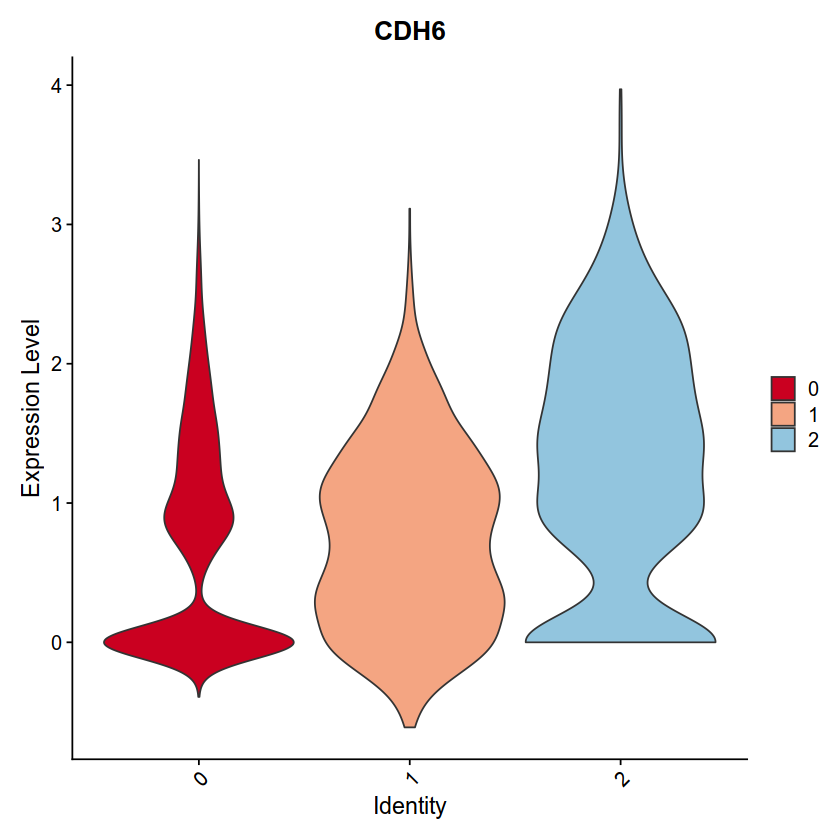

In [223]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "CDH6",group.by = "peaks_snn_res.0.1",cols=col,pt.size=0)

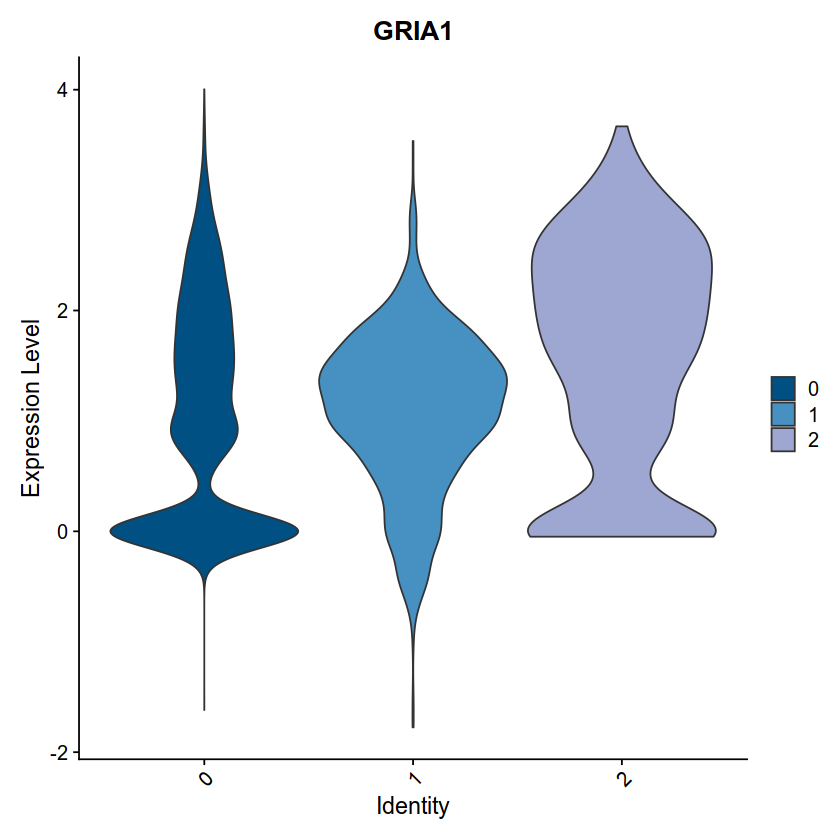

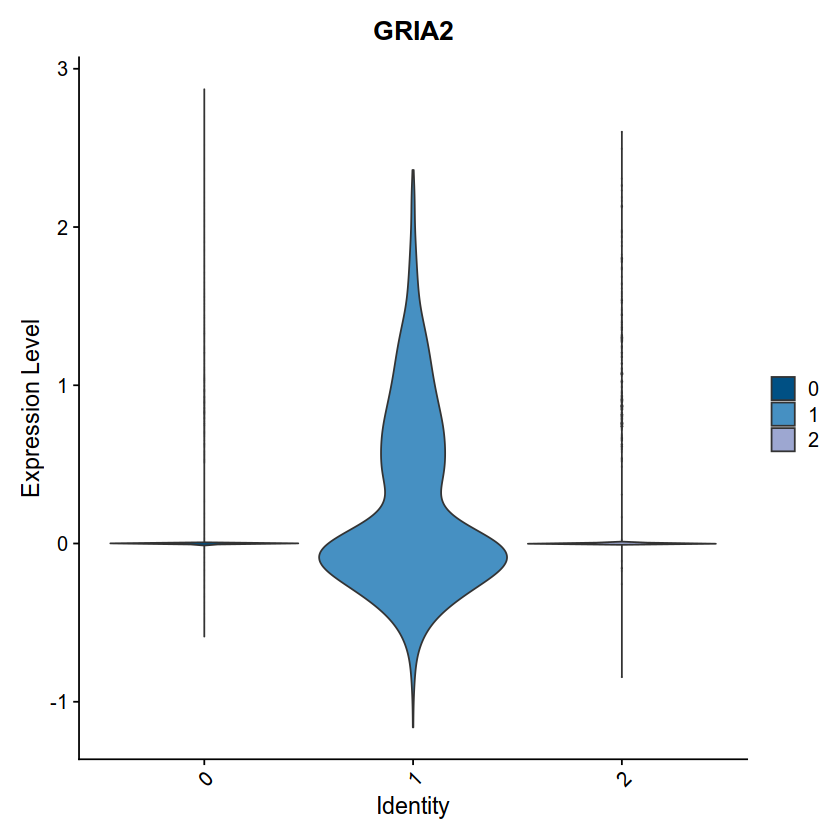

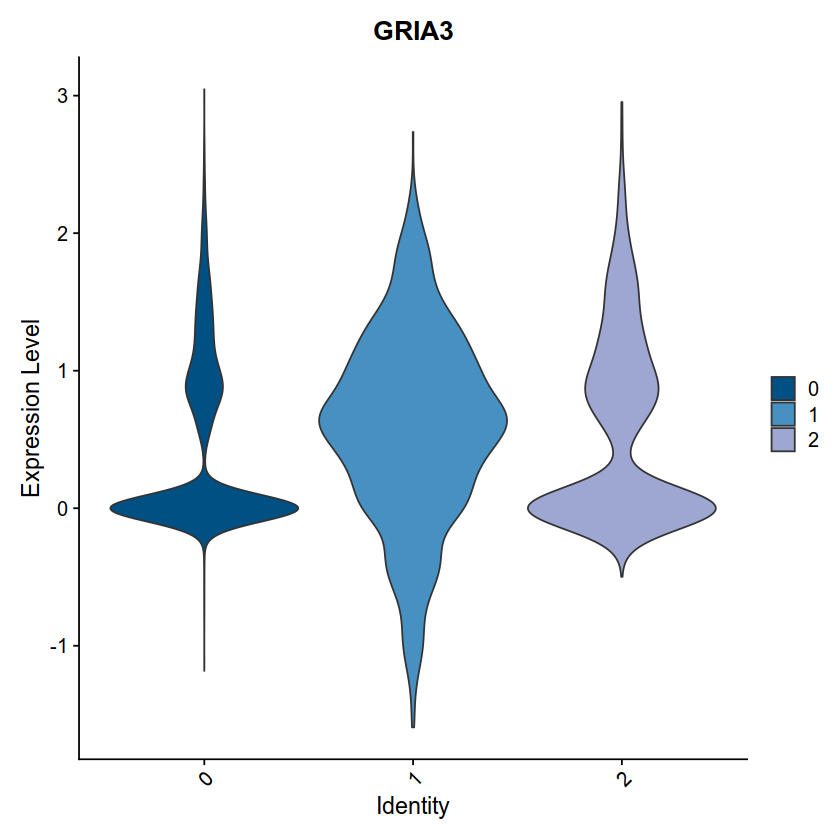

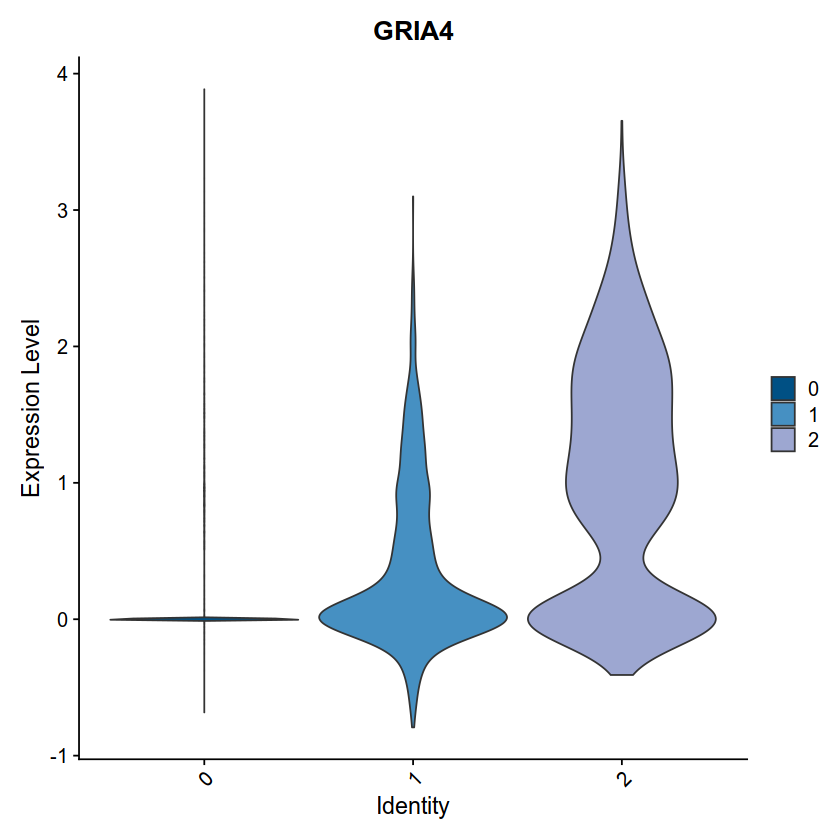

In [231]:
cols<-c("#005084","#4690C2","#9DA7D1")
VlnPlot(subset_seurat, features ="GRIA1",group.by = "peaks_snn_res.0.1",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="GRIA2",group.by = "peaks_snn_res.0.1",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="GRIA3",group.by = "peaks_snn_res.0.1",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="GRIA4",group.by = "peaks_snn_res.0.1",cols=cols,pt.size=0)

Warning message:
"Could not find DLG4 in the default search locations, found in RNA assay instead"


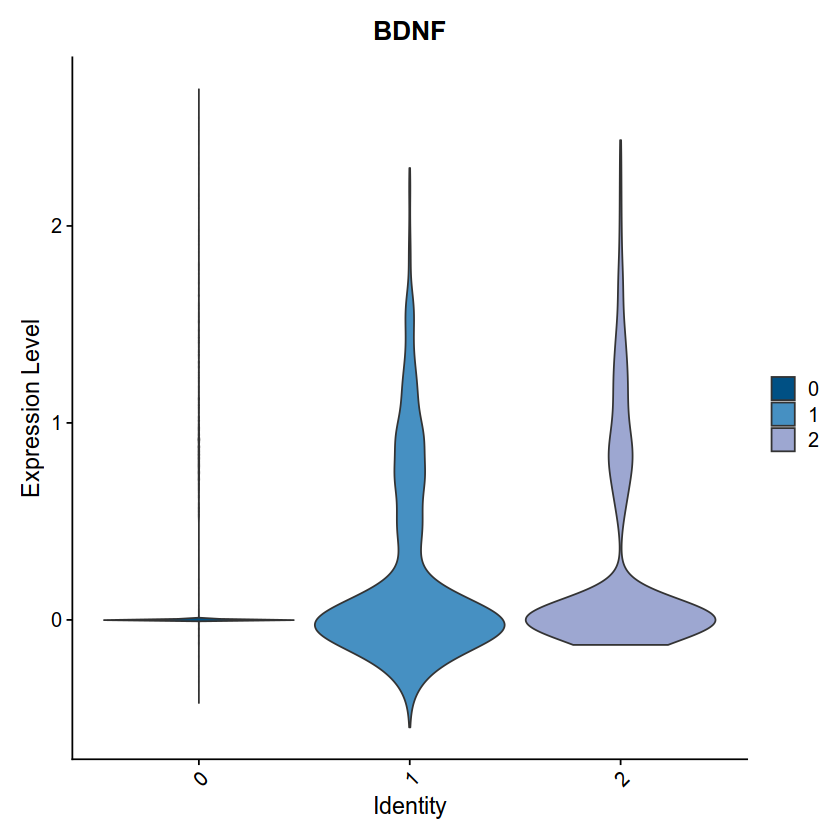

Warning message:
"Could not find NLGN3 in the default search locations, found in RNA assay instead"


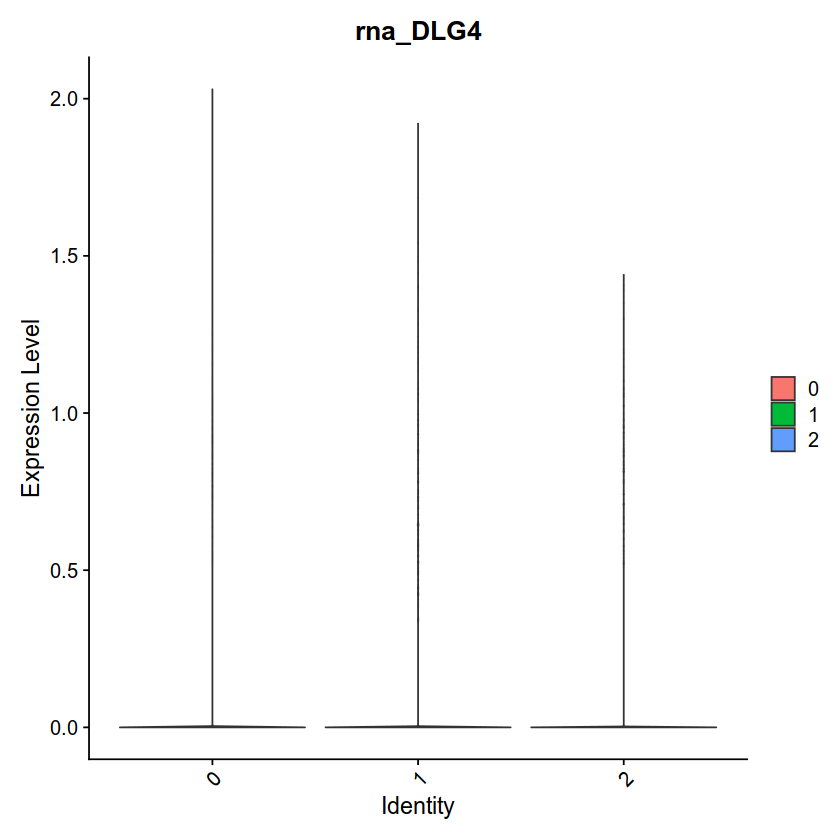

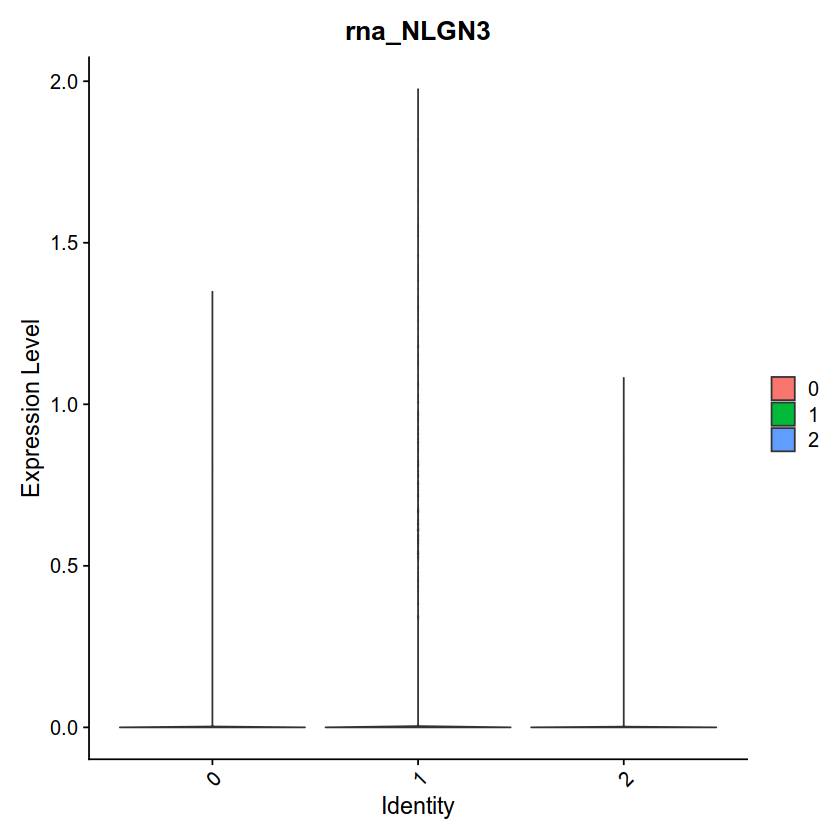

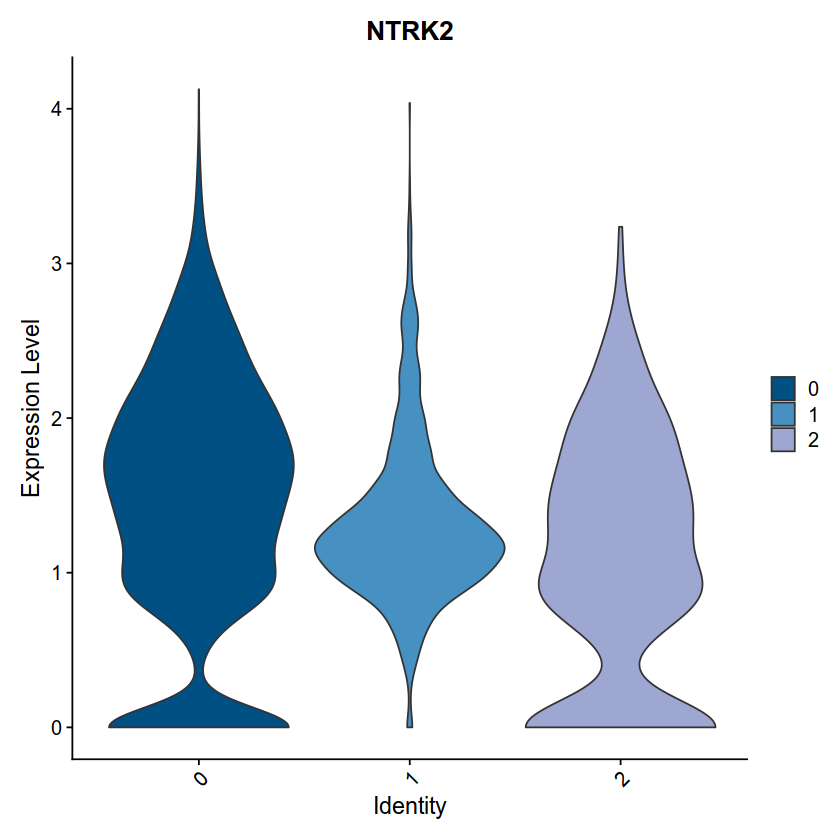

In [233]:
VlnPlot(subset_seurat, features ="BDNF",group.by = "peaks_snn_res.0.1",cols=cols,pt.size=0)
VlnPlot(subset_seurat, features ="DLG4",group.by = "peaks_snn_res.0.1",pt.size=0)
VlnPlot(subset_seurat, features ="NLGN3",group.by = "peaks_snn_res.0.1",pt.size=0)
VlnPlot(subset_seurat, features ="NTRK2",group.by = "peaks_snn_res.0.1",cols=cols,pt.size=0)

In [147]:
#write.table(tf_motif,file="tf.motif.subcluster.xls",quote=F,sep="\t",row.names=F)

In [148]:
annotation3<-data.frame(group=annotation[order(annotation$glio.int.kmeans_3),])
rownames(annotation3)<-rownames(annotation)[order(annotation$glio.int.kmeans_3)]
#annotation3$group<-factor(annotation3$group)


In [149]:
s<-as.matrix(glio.int@assays$chromvar@data[tf_motif$motif.feature,])
s2<-as.matrix(s[,rownames(annotation3)])



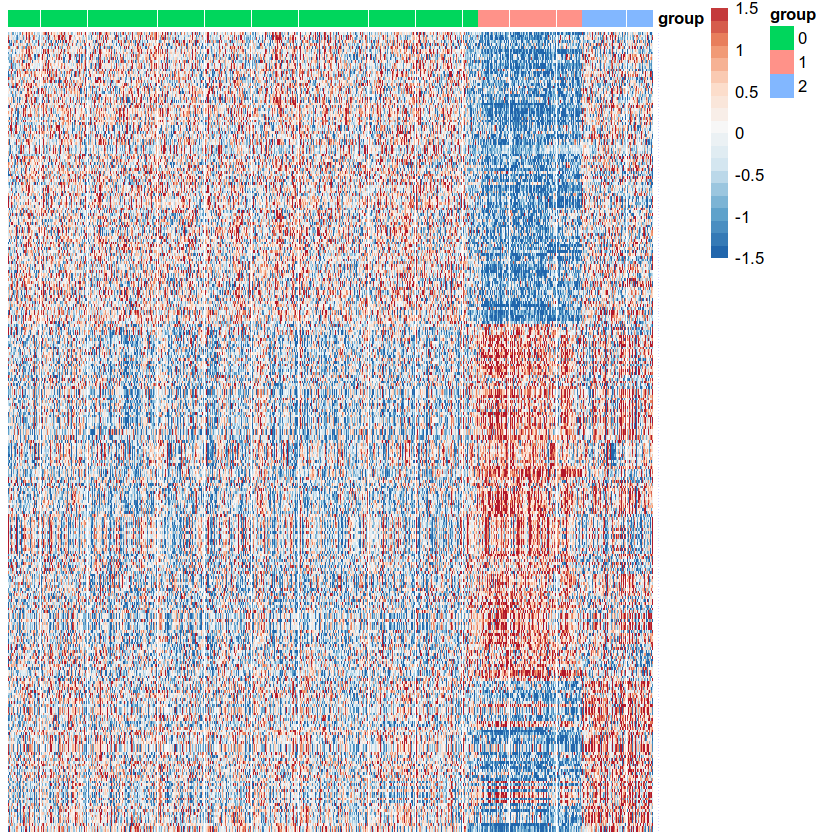

In [150]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="row",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)


In [151]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "0"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
library(dplyr)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc	 >0.6 ,"sig", "non-significant"))

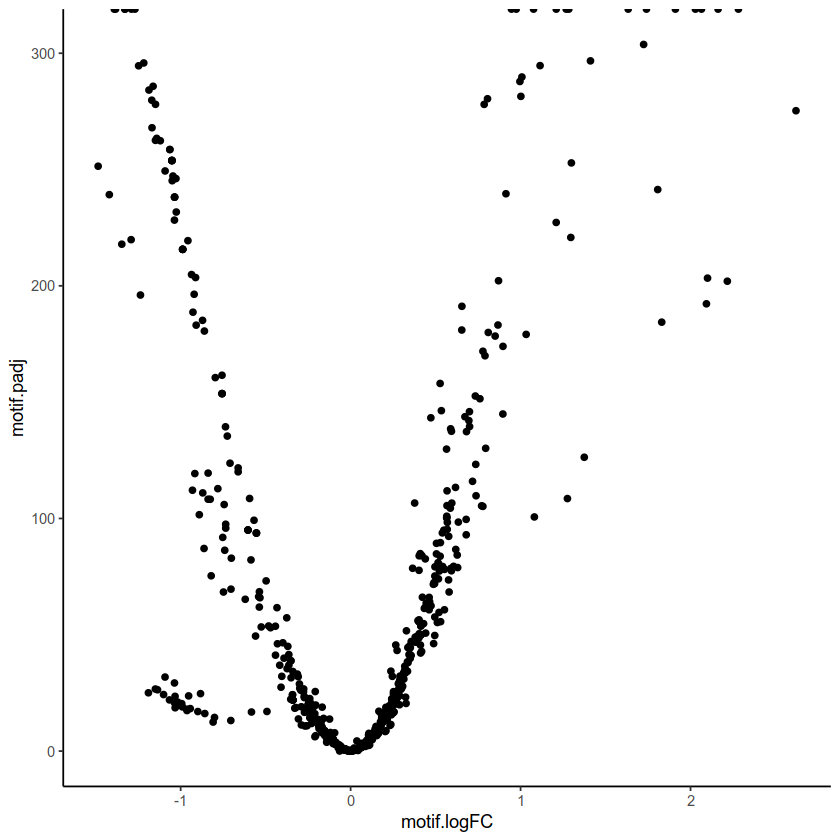

In [152]:
#tf_motif2<-tf_motif
#tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2<-tf_motif2[which(tf_motif2$motif.group == "0"),]
ggplot(tf_motif2, aes(x=motif.logFC, y=motif.padj)) + geom_point()+theme_classic()

In [153]:
max(tf_motif2$motif.padj)

[1] Inf

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 48 49 50

png 
  2

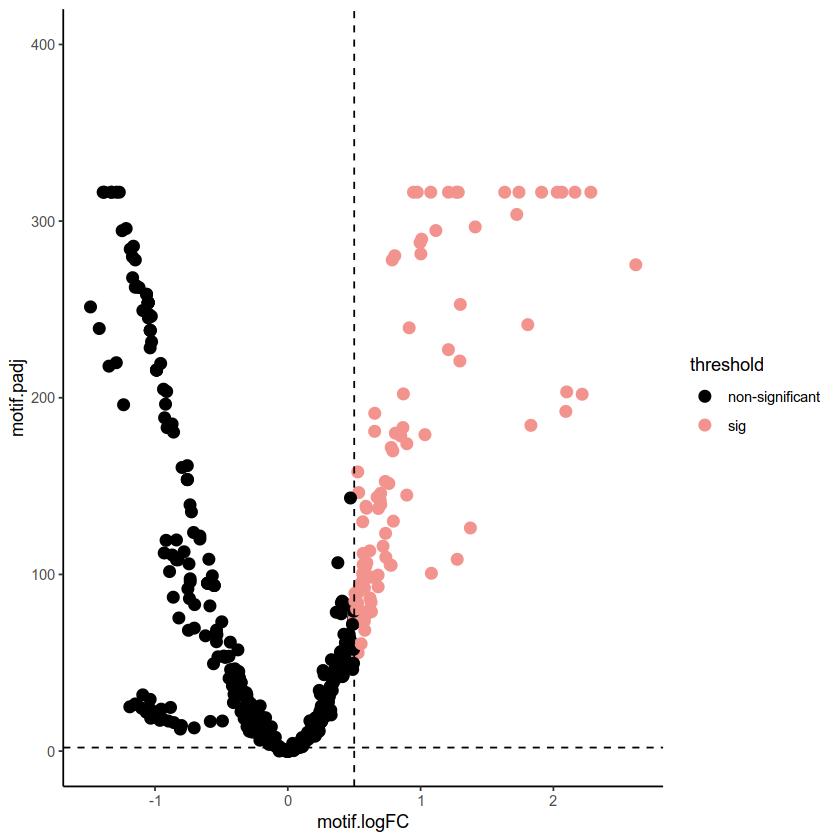

In [220]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "0"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-306.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
pdf("volcano.edge.c0.pdf")
a
dev.off()

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 48 49 50

Warning message:
"ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps"
Warning message:
"ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


png 
  2

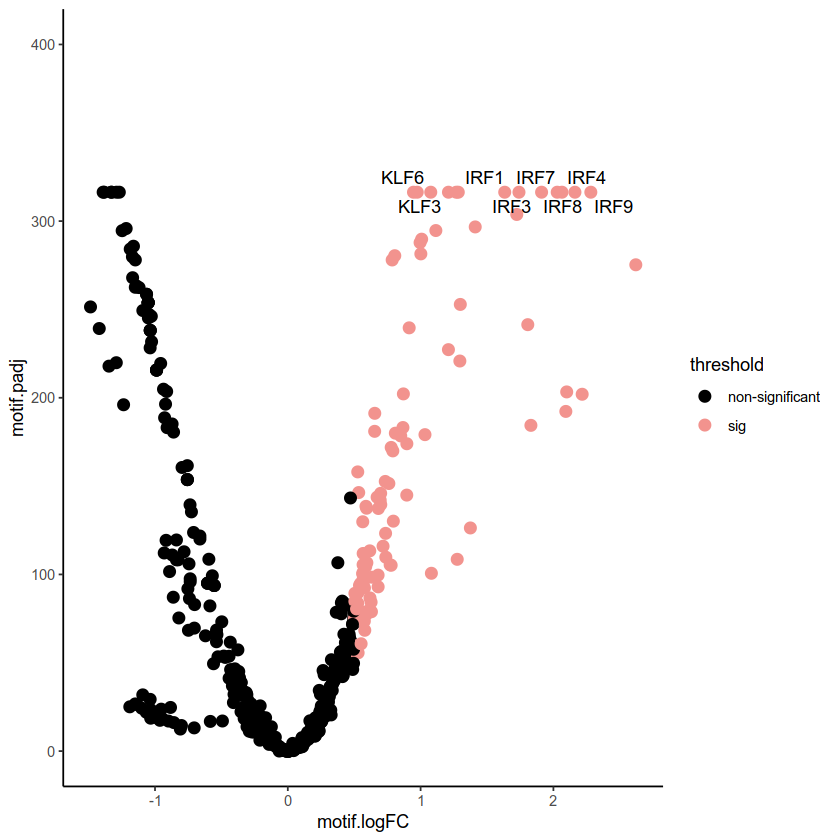

In [155]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "0"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-306.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >305),aes(label = gene),max.overlaps = 10)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >305),aes(label = gene),max.overlaps = 10)+ylim(c(0,400))+theme_classic()
pdf("volcano.edge.c0-add.pdf")
a
dev.off()

In [156]:
g<-subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >305)
g2<-g[order(g$motif.padj,decreasing =T),]
g2[order(g2$motif.logFC,decreasing =T),]

,motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene,threshold
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
90,MA0653.1,0,1.4194400,2.2817565,12710013,0.7965488,0,316.3633,100,100,IRF9,sig
356,MA1419.1,0,1.3907816,2.1621564,12539612,0.7858696,0,316.3633,100,100,IRF4,sig
89,MA0652.1,0,1.3086457,2.0645005,12400942,0.7771790,0,316.3633,100,100,IRF8,sig
43,MA0517.1,0,1.2523590,2.0286638,12784883,0.8012410,0,316.3633,100,100,STAT1::STAT2,sig
191,MA0772.1,0,1.1685511,1.9109765,12476527,0.7819160,0,316.3633,100,100,IRF7,sig
355,MA1418.1,0,1.0233777,1.7407359,12368767,0.7751626,0,316.3633,100,100,IRF3,sig
48,MA0050.2,0,0.9317853,1.6333224,12742089,0.7985590,0,316.3633,100,100,IRF1,sig
232,MA0811.1,0,0.8156074,1.2836496,12218073,0.7657184,0,316.3633,100,100,TFAP2B,sig
235,MA0524.2,0,0.7667612,1.2684068,12263986,0.7685959,0,316.3633,100,100,TFAP2C,sig


Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 21 32

Warning message:
"Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead."


png 
  2

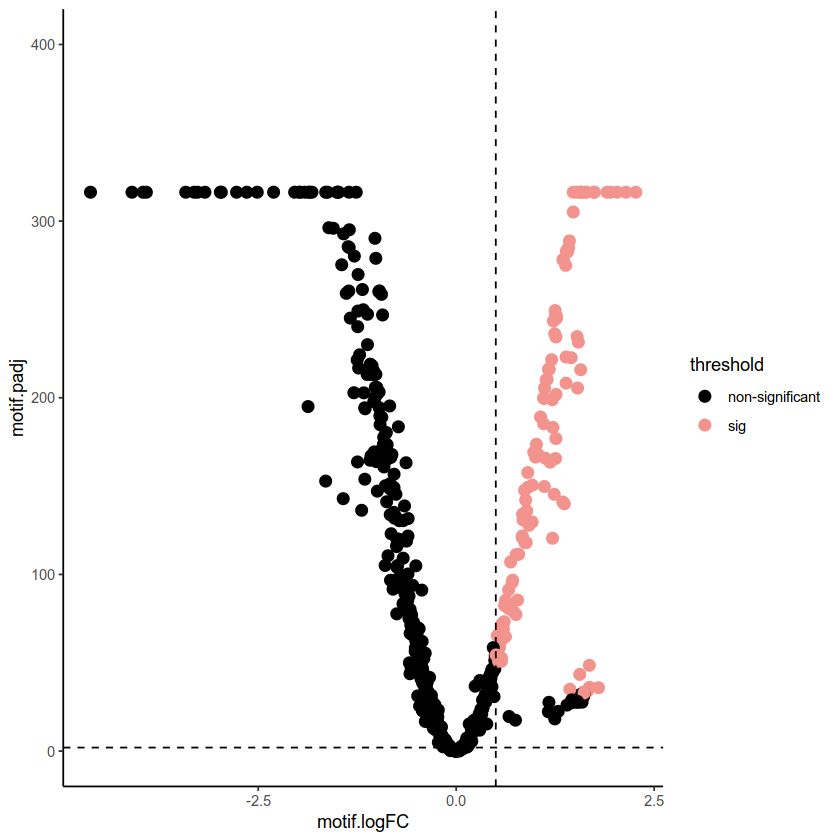

In [218]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "1"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-356.363256720647+10
tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-306.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
pdf("volcano.edge.c1.pdf")
a
dev.off()

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 21 32

png 
  2

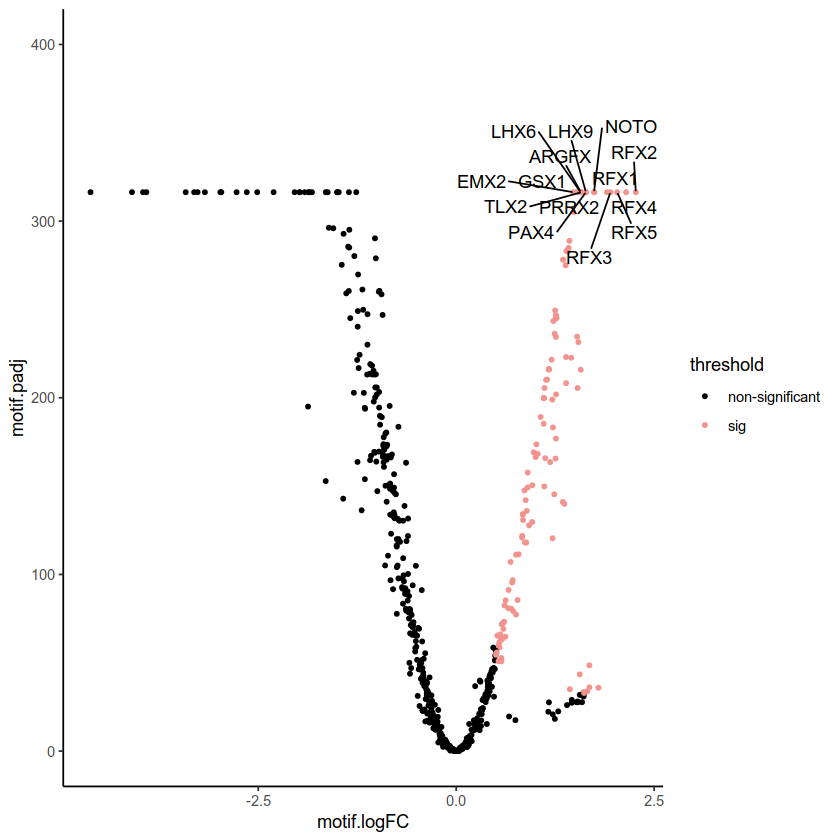

In [158]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "1"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-356.363256720647+10
tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-306.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=1) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >315),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=1) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >315),aes(label = gene),max.overlaps = 30)+ylim(c(0,400))+theme_classic()
pdf("volcano.edge.c1-add.pdf")
a
dev.off()

In [159]:
g<-subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >315)
g2<-g[order(g$motif.padj,decreasing =T),]
g2[order(g2$motif.logFC,decreasing =T),]

,motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene,threshold
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
848,MA0600.2,1,0.8487307,2.268368,9301566,0.8499671,0,316.3633,100,100,RFX2,sig
852,MA0799.1,1,0.8455441,2.144868,9151139,0.8362213,0,316.3633,100,100,RFX4,sig
853,MA0510.2,1,0.7525450,2.032619,9006842,0.8230356,0,316.3633,100,100,RFX5,sig
1245,MA0798.2,1,0.8545978,1.947829,9004687,0.8228386,0,316.3633,100,100,RFX3,sig
1244,MA0509.2,1,0.8374118,1.904767,8902572,0.8135075,0,316.3633,100,100,RFX1,sig
1150,MA0075.3,1,0.7763912,1.745833,9179685,0.8388298,0,316.3633,100,100,PRRX2,sig
770,MA0710.1,1,0.8508241,1.740209,9153415,0.8364293,0,316.3633,100,100,NOTO,sig
747,MA0068.2,1,0.7603221,1.638393,9048847,0.8268739,0,316.3633,100,100,PAX4,sig
1144,MA0701.2,1,0.7603221,1.638393,9048847,0.8268739,0,316.3633,100,100,LHX9,sig


Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 1 2

png 
  2

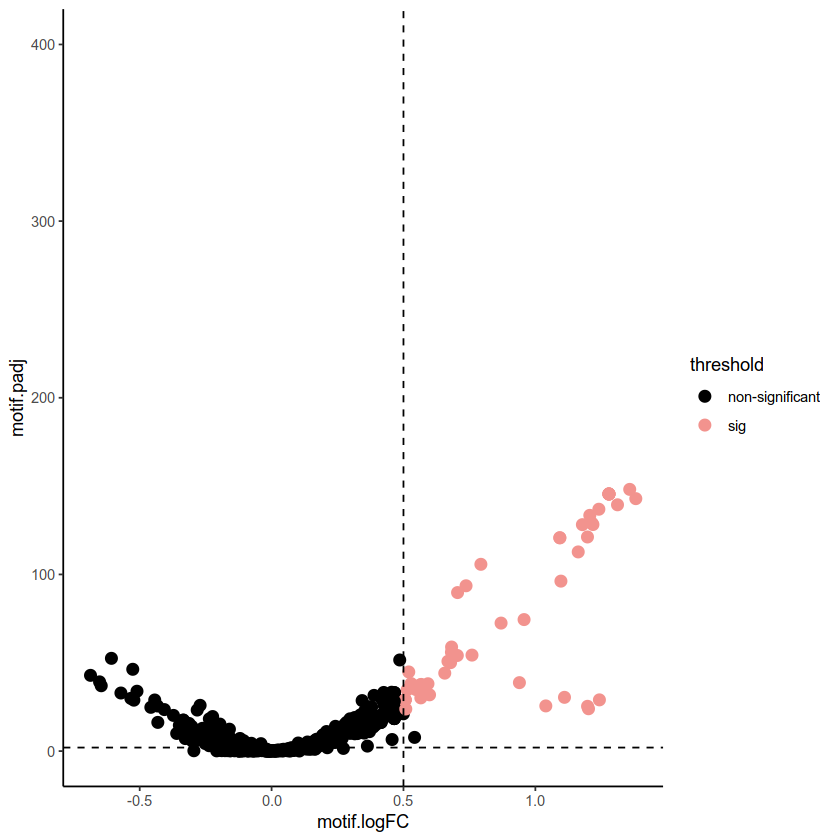

In [219]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "2"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-356.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+ geom_hline(yintercept = 2,linetype="dashed", color = "black", size=0.5)+geom_vline(xintercept = 0.5,linetype="dashed", color = "black", size=0.5)+ylim(c(0,400))+theme_classic()
pdf("volcano.edge.c2.pdf")
a
dev.off()

Warning message in mydata$motif.feature == head(mydata[which(mydata$threshold == :
"longer object length is not a multiple of shorter object length"


[1] 1 2

png 
  2

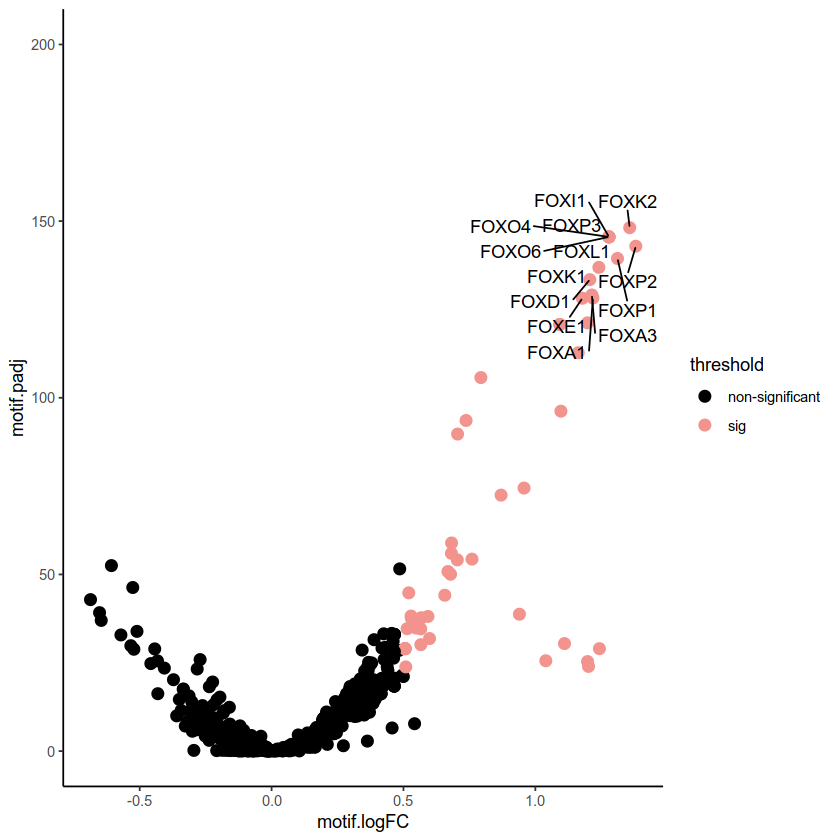

In [161]:
tf_motif2<-markers_motifs[which(markers_motifs$motif.group == "2"),]
tf_motif2$motif.padj<--log10(tf_motif2$motif.padj)
#tf_motif2$motif.padj[is.infinite(tf_motif2$motif.padj)]<-356.363256720647+10
library(dplyr)
library(ggrepel)
mydata<-tf_motif2%>%mutate(threshold = ifelse(motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >2,"sig", "non-significant"))
which(mydata$motif.feature == head(mydata[which(mydata$threshold == "sig"),]$motif.feature,10))

ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >122),aes(label = gene),max.overlaps = 30)+ylim(c(0,200))+theme_classic()
a<-ggplot(mydata, aes(x=motif.logFC, y=motif.padj))+geom_point(aes(colour = threshold), size=3) +scale_colour_manual(values = c("black","#f2938e"))+geom_text_repel(data=subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >122),aes(label = gene),max.overlaps = 30)+ylim(c(0,200))+theme_classic()
pdf("volcano.edge.c2-add.pdf")
a
dev.off()

In [162]:
g<-subset(mydata,motif.logFC>= 0.5 & motif.auc>0.6 & motif.padj >122)
g2<-g[order(g$motif.padj,decreasing =T),]
g2[order(g2$motif.logFC,decreasing =T),]

,motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene,threshold
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1319,MA0593.1,2,1.3303816,1.380828,5901900,0.7508996,1.390534e-145,142.9005,100,100,FOXP2,sig
1840,MA1103.2,2,1.1330768,1.357747,5943280,0.7561644,1.135369e-151,148.1435,100,100,FOXK2,sig
1841,MA0481.3,2,1.0650762,1.311447,5877446,0.7477884,4.805393e-142,139.4200,100,100,FOXP1,sig
1343,MA0042.2,2,1.0302103,1.278998,5920342,0.7532460,2.789121e-148,145.5313,100,100,FOXI1,sig
1344,MA0033.2,2,1.0302103,1.278998,5920342,0.7532460,2.789121e-148,145.5313,100,100,FOXL1,sig
1527,MA0848.1,2,1.0302103,1.278998,5920342,0.7532460,2.789121e-148,145.5313,100,100,FOXO4,sig
1528,MA0849.1,2,1.0302103,1.278998,5920342,0.7532460,2.789121e-148,145.5313,100,100,FOXO6,sig
1529,MA0850.1,2,1.0302103,1.278998,5920342,0.7532460,2.789121e-148,145.5313,100,100,FOXP3,sig
1563,MA0852.2,2,1.1188328,1.240767,5859525,0.7455083,1.765985e-139,136.9059,100,100,FOXK1,sig


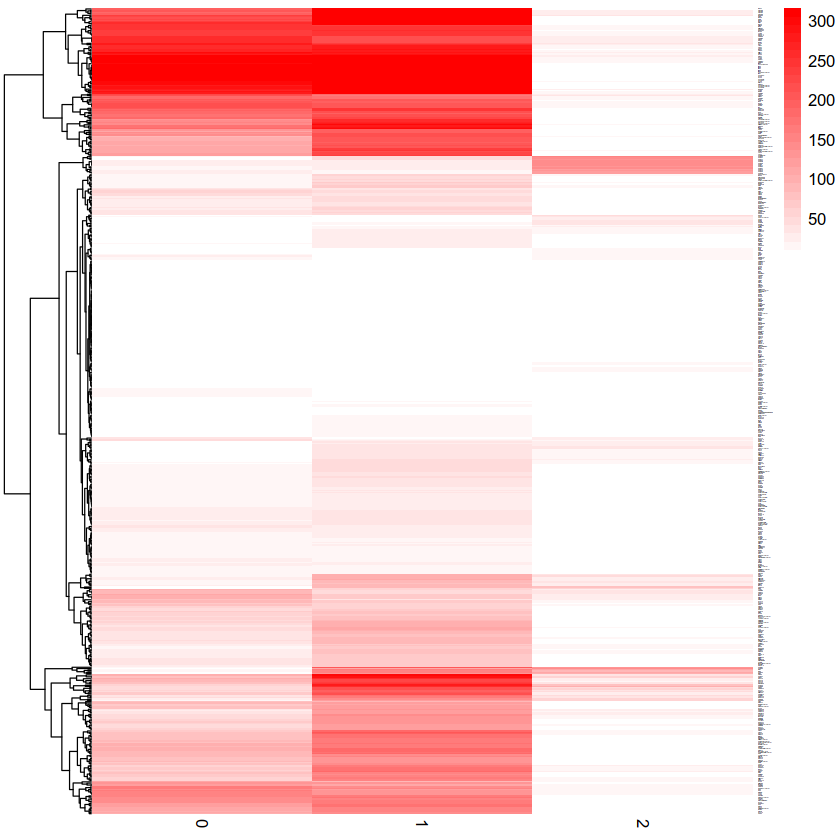

png 
  2

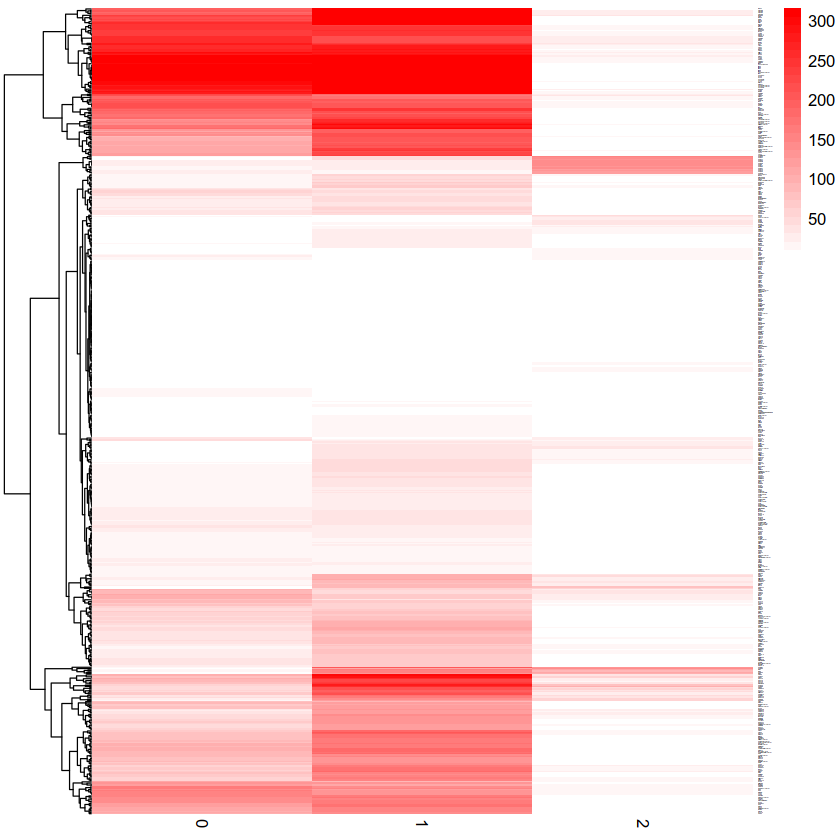

In [163]:
markers_motifs_new<-markers_motifs
markers_motifs_new$motif.pval<--log10(markers_motifs_new$motif.pval)

tf_motif22<-markers_motifs_new[which(markers_motifs_new$motif.group == "2"),]
tf_motif21<-markers_motifs_new[which(markers_motifs_new$motif.group == "1"),]
tf_motif20<-markers_motifs_new[which(markers_motifs_new$motif.group == "0"),]

tf_all<-cbind(tf_motif20[,c(7)],tf_motif21[,c(7)],tf_motif22[,c(7,11)])
colnames(tf_all)<-c("0","1","2")
tf_all2<-tf_all[,c(1,2,3)]
rownames(tf_all2)<-tf_all[,4]
#tf_all2<-tf_all2[is.finite(rowSums(tf_all2)),]
tf_all2[sapply(tf_all2, is.infinite)] <- 306.363256720647+10

library(pheatmap)
cols = colorRampPalette(c("white", "red"))(30)
pheatmap(tf_all2,color = cols,fontsize_row=1,cluster_cols = F)
a<-pheatmap(tf_all2,color = cols,fontsize_row=1,cluster_cols =F)
pdf("pvalue.edge.pdf")
a
dev.off()

In [164]:
log10(6.3059239497785e-148)
log10(4.57988696098355e-146 )

[1] -147.2003

[1] -145.3391

In [165]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X = subset_seurat, group_by = 'CCA_RNA_snn_res.0.2', assay = 'data', seurat_assay = 'CCA_RNA')
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
markers_rna$gene <- markers_rna$RNA.feature

In [166]:
topTFs_rna <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == CCA_RNA_snn_res.0.2, RNA.padj < 0.01, RNA.logFC > 0.2,RNA.auc>0.6 ) 
  top_tfs <- ctmarkers_rna
  return(top_tfs)
}

In [167]:
tf1_rna<-topTFs_rna("0")
tf2_rna<-topTFs_rna("1")
tf3_rna<-topTFs_rna("2")
tf4_rna<-topTFs_rna("3")
tf5_rna<-topTFs_rna("4")

tf_rna<-rbind(tf1_rna,tf2_rna,tf3_rna)


In [168]:
s<-as.matrix(glio.int@assays$CCA_RNA@scale.data[as.character(tf_rna$RNA.feature),])
s2<-as.matrix(s[,rownames(annotation3)])

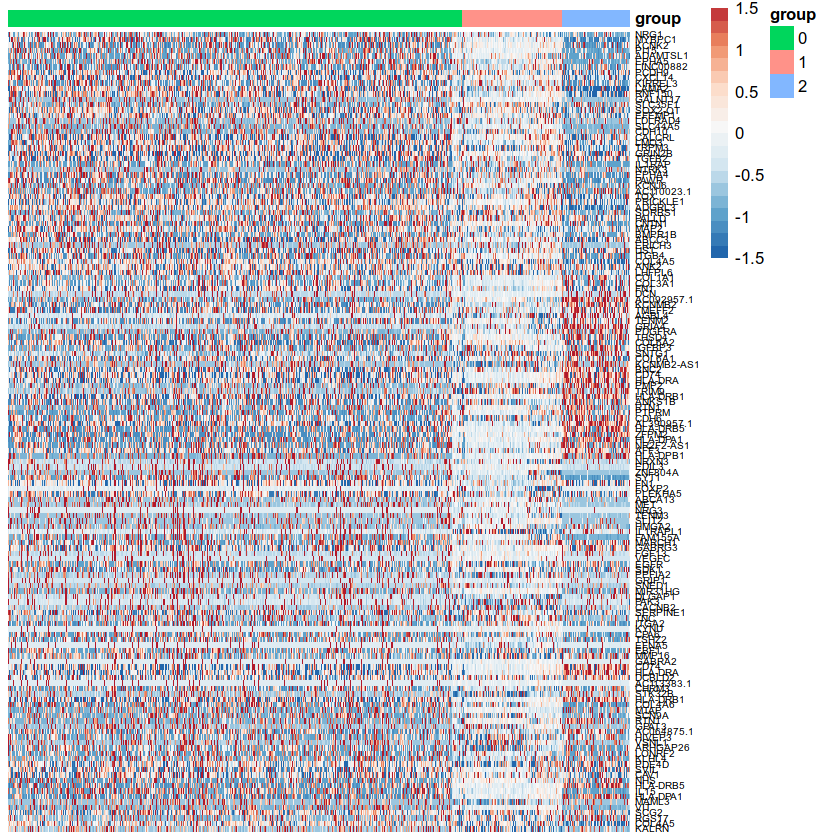

In [169]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="row",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=6,fontsize_col=4,breaks=breaks)


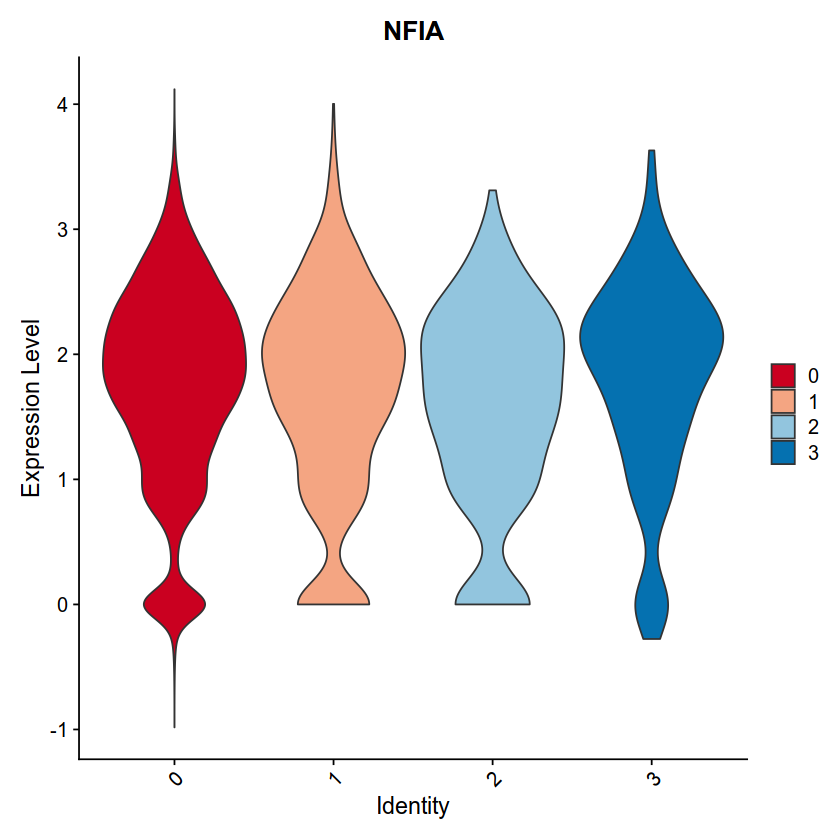

In [170]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
VlnPlot(subset_seurat, features = "NFIA",group.by = "CCA_RNA_snn_res.0.2",cols=col,pt.size=0)

In [171]:
write.table(tf_rna,file="subcluster.rna.xls",quote=F,sep="\t",row.names=F)

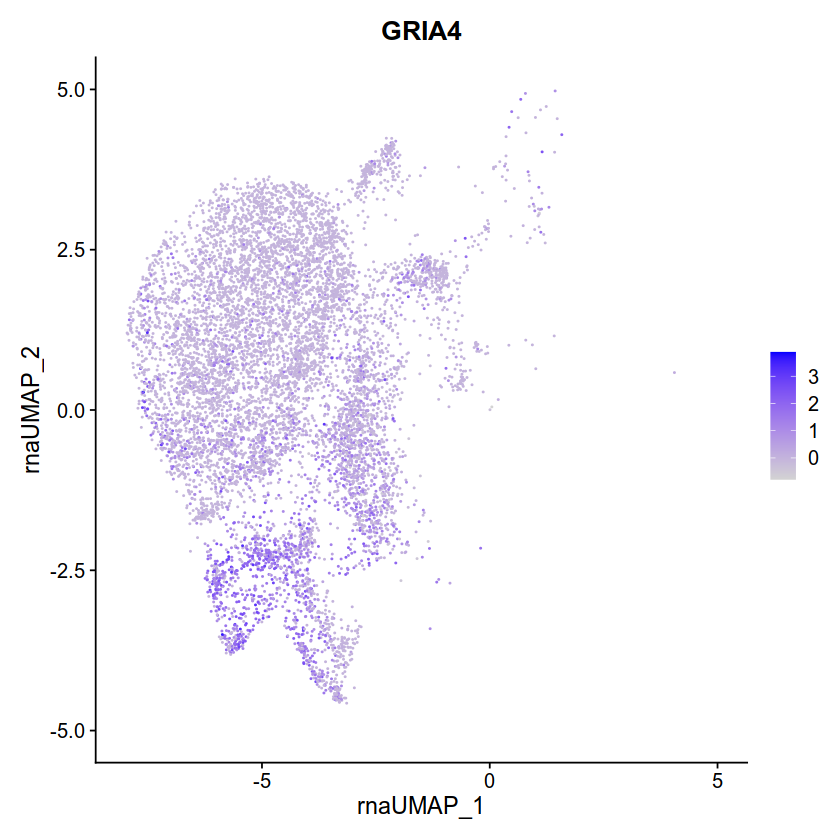

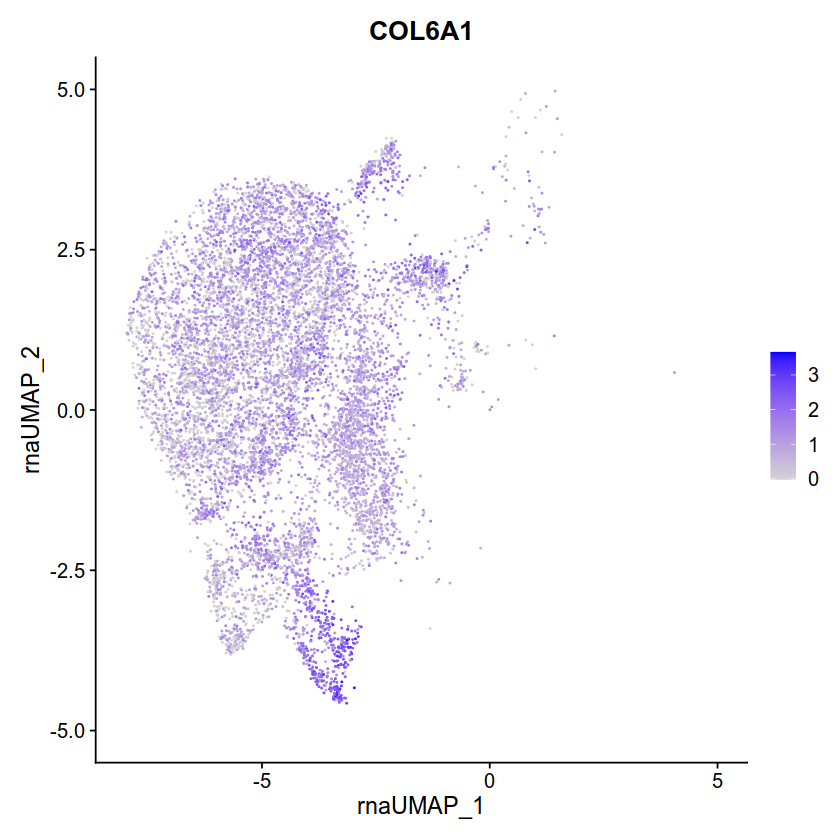

In [172]:
FeaturePlot(subset_seurat, features = 'GRIA4',reduction="rna.umap")
FeaturePlot(subset_seurat, features = 'COL6A1',reduction="rna.umap")


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


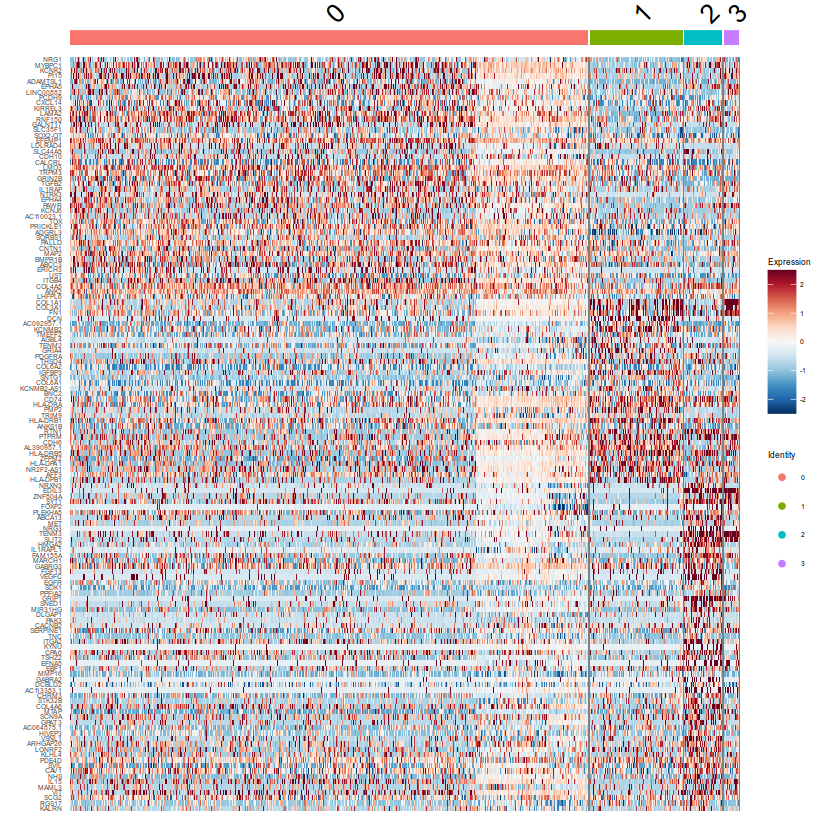

In [173]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(subset_seurat, features = as.character(tf_rna$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

Warning message:
"Scaling data with a low number of groups may produce misleading results"


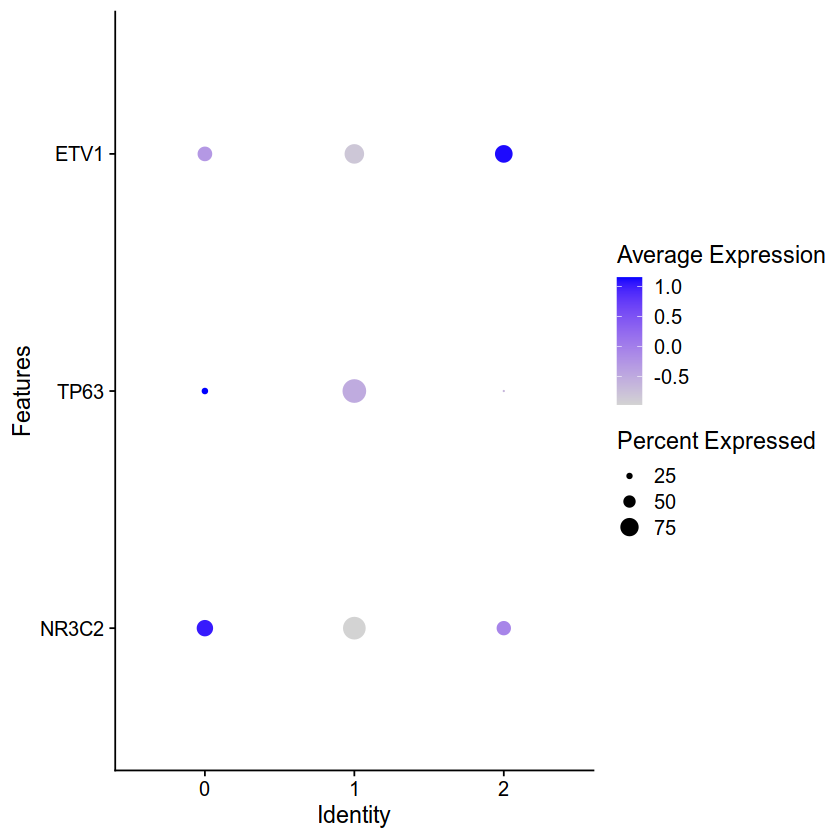

In [174]:
DefaultAssay(subset_seurat) <- "CCA_RNA"
DotPlot(object = subset_seurat, features = unique(tf_c2$gene),group.by = "peaks_snn_res.0.1")+coord_flip() 


In [175]:
pdf("edge.doptplot.pdf")
DotPlot(object = subset_seurat, features = unique(tf_c2$gene),group.by = "peaks_snn_res.0.1")+coord_flip() 
dev.off()


Warning message:
"Scaling data with a low number of groups may produce misleading results"


png 
  2

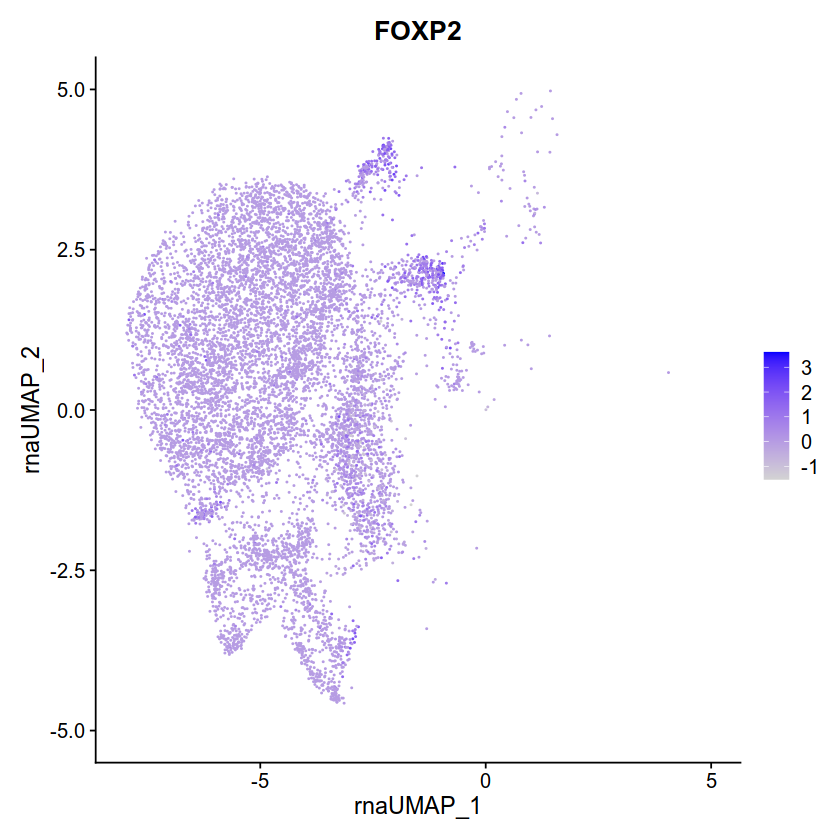

In [176]:
#FeaturePlot(subset_seurat, features = 'NFIA',reduction="rna.umap")
FeaturePlot(subset_seurat, features = 'FOXP2',reduction="rna.umap")
#FeaturePlot(subset_seurat, features = 'ETV1',reduction="rna.umap")
#FeaturePlot(subset_seurat, features = 'PRRX1',reduction="rna.umap")


In [177]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/5.figure"

In [178]:

DefaultAssay(subset_seurat) <- "peaks"
subset_seurat <- RegionStats(subset_seurat, genome = BSgenome.Hsapiens.UCSC.hg38)


In [179]:
peaklink <- LinkPeaks(
  object = subset_seurat,
  peak.assay = "peaks",
  expression.assay = "CCA_RNA",
  genes.use = c("RUNX2","FOXP2")
)

Testing 2 genes and 256350 peaks

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-2') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."
as(<dgCMatrix>, "dgTMatrix") is deprecated since Matrix 1.5-0; do as(., "TsparseMatrix") instead



Warning message:
"Removed 596 rows containing non-finite values (`stat_ydensity()`)."


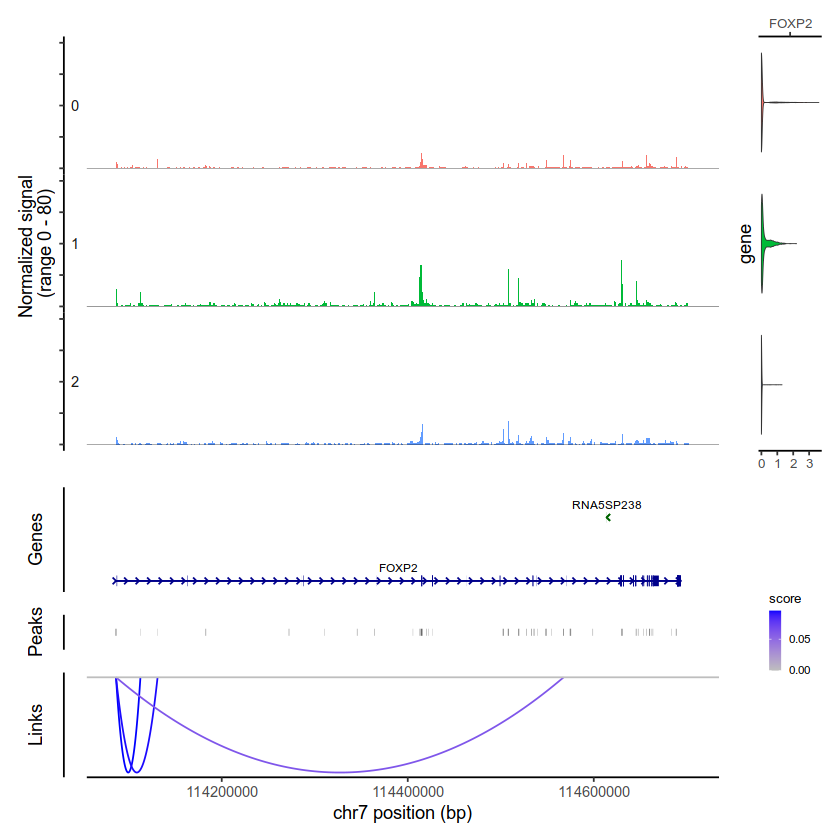

In [180]:
p1 <- CoveragePlot(
  object = peaklink,
  region = "FOXP2",
  features = "FOXP2",
  expression.assay = "CCA_RNA",
  group.by = "peaks_snn_res.0.1",
#  idents = c("0","1","2"),
  extend.upstream = 500,
  extend.downstream = 10000
)
patchwork::wrap_plots(p1, ncol = 1)

Warning message:
"Removed 54 rows containing missing values (`geom_segment()`)."


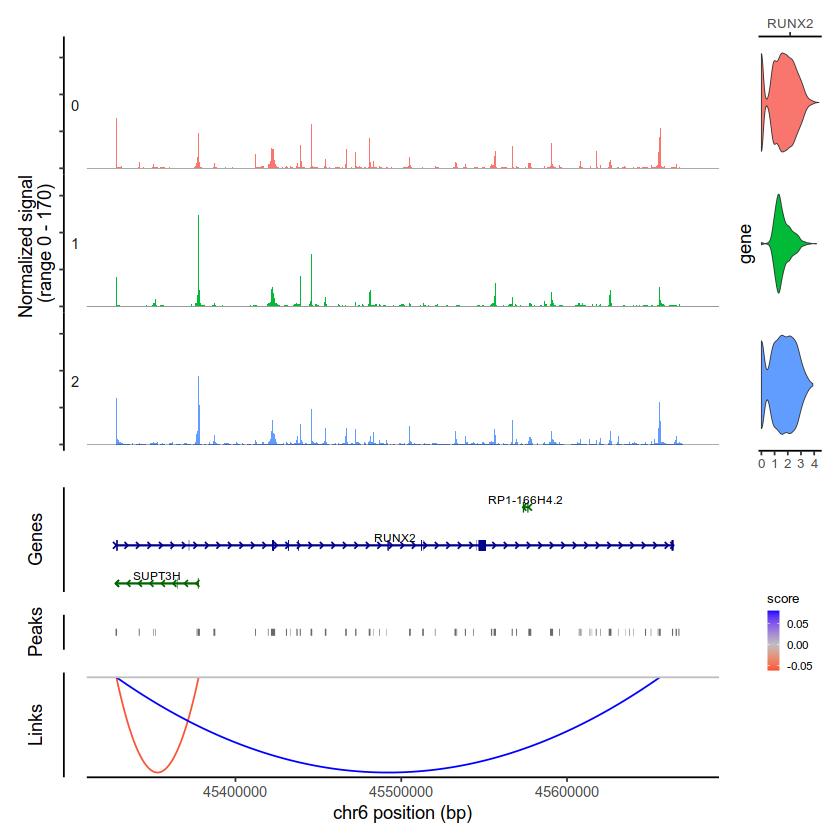

In [181]:
p2 <- CoveragePlot(
  object = peaklink,
  region = "RUNX2",
  features = "RUNX2",
  expression.assay = "CCA_RNA",
  group.by = "peaks_snn_res.0.1",
  extend.upstream = 500,
  extend.downstream = 10000
)
patchwork::wrap_plots(p2, ncol = 1)

In [182]:
pdf("panel.edge.runx2.pdf")
patchwork::wrap_plots(p2, ncol = 1)
dev.off()

Warning message:
"Removed 54 rows containing missing values (`geom_segment()`)."


png 
  2

In [183]:
pdf("link.scatac.without.filter.pdf")
patchwork::wrap_plots(p1, ncol = 1)
patchwork::wrap_plots(p2, ncol = 1)
dev.off()

Warning message:
"Removed 596 rows containing non-finite values (`stat_ydensity()`)."
Warning message:
"Removed 54 rows containing missing values (`geom_segment()`)."


png 
  2

In [184]:
DefaultAssay(subset_seurat) <- "CCA_RNA"

variable<-FindVariableFeatures(subset_seurat,method="vst",nfeatures=8000,verbose=T)
gene_name<-VariableFeatures(variable)

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
"selection.method set to 'vst' but count slot is empty; will use data slot instead"
Warning message:
"The following arguments are not used: method"
Warning message in eval(predvars, data, env):
"NaNs produced"
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
"number of items to replace is not a multiple of replacement length"


In [185]:
peaklink2 <- LinkPeaks(
  object = subset_seurat,
    distance = 500000,
  min.cells = 1000,
  peak.assay = "peaks",
  expression.assay = "CCA_RNA",
 genes.use = gene_name
)

Testing 1221 genes and 22462 peaks

Found gene coordinates for 1009 genes

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiproces

Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly specify either 'multisession' (recommended) or 'multicore'. In the current R session, 'multiprocess' equals 'multicore'."
Warning message:
"Detected creation of a 'multiprocess' future. Strategy 'multiprocess' is deprecated in future (>= 1.20.0) [2020-10-30]. Instead, explicitly sp

R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-2') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-3') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-4') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-5') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-6') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-7') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-8') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-9') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-10') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-11') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-12') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-13') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-14') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-15') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-16') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-17') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-18') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-19') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-20') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-21') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-22') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-23') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-24') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-25') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-26') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-27') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-28') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-29') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-30') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-31') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-32') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-33') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-34') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-35') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-36') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-37') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-38') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-39') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-40') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-41') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-42') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-43') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-44') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-45') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-46') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-47') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-48') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-49') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


R_zmq_msg_send errno: 4 strerror: Interrupted system call


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-50') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [186]:
table<-data.frame(peaklink2@assays$peaks@links)


In [187]:
table2<-table[which(table$pvalue < 0.01),]

In [188]:
unique(table2$gene)

[1] "KAZN"        "ID3"         "CSMD2"       "HIVEP3"      "RNF220"     
  [6] "AGBL4"       "NFIA"        "ROR1"        "CACHD1"      "ERICH3"     
 [11] "SLC44A5"     "ST6GALNAC3"  "LPAR3"       "DDAH1"       "BCAR3"      
 [16] "ARHGAP29"    "F3"          "NTNG1"       "KCND3"       "PRRX1"      
 [21] "GLUL"        "CHI3L1"      "KLHDC8A"     "LEMD1"       "SYT14"      
 [26] "KCNH1"       "PTPN14"      "CENPF"       "KCNK2"       "TGFB2"      
 [31] "SUSD4"       "DNAH14"      "CHRM3"       "KIF26B"      "PXDN"       
 [36] "VSNL1"       "KLHL29"      "DPYSL5"      "LTBP1"       "RASGRP3"    
 [41] "CRIM1"       "VIT"         "CYP1B1"      "SLC8A1"      "EFEMP1"     
 [46] "MEIS1"       "TACR1"       "ST3GAL5"     "AFF3"        "LONRF2"     
 [51] "GPR39"       "CACNB4"      "GALNT13"     "SLC38A11"    "SCN9A"      
 [56] "PDE1A"       "COL3A1"      "STAT4"       "MYO1B"       "EPHA4"      
 [61] "PAX3"        "SCG2"        "AGAP1"       "TWIST2"      "SNED1"      
 [66] "CHL1"        "LMCD1"       "HRH1"        "RARB"        "NEK10"      
 [71] "MYRIP"       "VIPR1"       "LIMD1"       "LTF"         "LRRC2"      
 [76] "CACNA2D3"    "ERC2"        "COL8A1"      "PHLDB2"      "CCDC80"     
 [81] "STXBP5L"     "CPNE4"       "TMEM108"     "SLCO2A1"     "AGTR1"      
 [86] "IQCJ-SCHIP1" "SMC4"        "MECOM"       "LINC00578"   "DGKG"       
 [91] "TP63"        "FGF12"       "TACC3"       "STK32B"      "KCNIP4-IT1" 
 [96] "KCNIP4"      "PCDH7"       "SCFD2"       "IGFBP7"      "ADGRL3"     
[101] "EPHA5"       "SLC4A4"      "GPAT3"       "ARHGAP24"    "SPARCL1"    
[106] "BMPR1B"      "UNC5C"       "DKK2"        "LEF1"        "ANK2"       
[111] "NDST3"       "PRSS12"      "LINC01091"   "SLC7A11"     "MAML3"      
[116] "RNF150"      "IL15"        "EDNRA"       "FAM160A1"    "TDO2"       
[121] "MARCH1"      "PALLD"       "TENM3"       "AHRR"        "ADCY2"      
[126] "CDH10"       "CDH6"        "ADAMTS12"    "SLC1A3"      "GHR"        
[131] "FST"         "ARHGEF28"    "IQGAP2"      "ADGRV1"      "EFNA5"      
[136] "LOX"         "CHSY3"       "CXCL14"      "SPRY4"       "ARHGAP26"   
[141] "PRELID2"     "PPP2R2B"     "CD74"        "FAT2"        "GRIA1"      
[146] "EBF1"        "SLIT3"       "KCNIP1"      "NEURL1B"     "HLA-DRB5"   
[151] "HLA-DRB1"    "HLA-DQA1"    "HLA-DPB1"    "HLA-DPA1"    "RUNX2"      
[156] "TNFRSF21"    "LINC00472"   "CNR1"        "REV3L"       "SLC35F1"    
[161] "MAN1A1"      "LAMA2"       "MOXD1"       "MAP7"        "ARFGEF3"    
[166] "PPP1R14C"    "AKAP12"      "RGS17"       "SYNJ2"       "PDE10A"     
[171] "SDK1"        "ETV1"        "HDAC9"       "CREB5"       "PDE1C"      
[176] "EEPD1"       "HECW1"       "TNS3"        "VWC2"        "GRB10"      
[181] "COBL"        "EGFR"        "LANCL2"      "VOPP1"       "HIP1"       
[186] "SEMA3C"      "HGF"         "PCLO"        "ADAM22"      "COL1A2"     
[191] "DYNC1I1"     "PCOLCE"      "SERPINE1"    "COL26A1"     "NAMPT"      
[196] "CAV1"        "MET"         "PTPRZ1"      "PODXL"       "PLXNA4"     
[201] "CALD1"       "PTN"         "DGKI"        "TMEM178B"    "NEFL"       
[206] "DOCK5"       "EXTL3"       "PXDNL"       "NKAIN3"      "PMP2"       
[211] "SNTB1"       "FBXO32"      "KHDRBS3"     "COL22A1"     "TPM2"       
[216] "PGM5"        "PIP5K1B"     "GCNT1"       "PRUNE2"      "RASEF"      
[221] "NTRK2"       "GABBR2"      "LINC01505"   "LPAR1"       "COL27A1"    
[226] "TNC"         "PAPPA"       "ASTN2"       "PBX3"        "ANGPTL2"    
[231] "NRP1"        "SORBS1"      "PLEKHS1"     "SOX6"        "NAV2"       
[236] "BBOX1"       "LGR4"        "KIAA1549L"   "LDLRAD3"     "TMEM132A"   
[241] "NEAT1"       "TENM4"       "GUCY1A2"     "ELMOD1"      "CRYAB"      
[246] "NCAM1"       "KIRREL3"     "CACNA1C"     "TSPAN9"      "A2M"        
[251] "APOLD1"      "EMP1"        "GRIN2B"      "PTPRO"       "ST8SIA1"    
[256] "CCDC91"      "PRICKLE1"    "KRT5"        "METTL7B"     "NUP107"     
[261] "SLC35E3"     "MDM2"        "PAWR"        "R

In [189]:
num<-as.numeric(table(as.character(table2$gene)))

In [190]:
table(num)

num
  1   2   3   4   5   6   8   9  13 
199  78  39  13   5   2   1   1   2 

In [191]:
names(table(num))

[1] "1"  "2"  "3"  "4"  "5"  "6"  "8"  "9"  "13"

In [192]:
data.frame(name=c(names(table(num))[1:7],">8"),value=c(as.numeric(table(num))[1:7],18))
table3<-data.frame(name=as.character(c(names(table(num))[1:7],">8")),value=c(as.numeric(table(num))[1:7],18))

name,value
<chr>,<dbl>
1,199
2,78
3,39
4,13
5,5
6,2
8,1
>8,18


In [193]:
table3

name,value
<chr>,<dbl>
1,199
2,78
3,39
4,13
5,5
6,2
8,1
>8,18


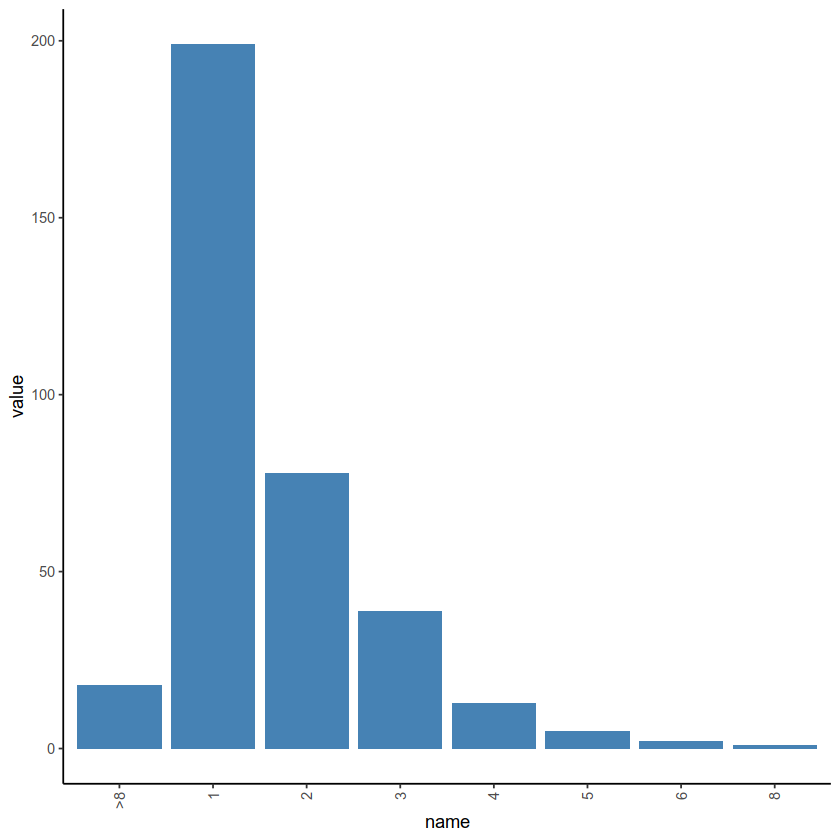

In [194]:
library(ggplot2)
ggplot(table3, aes( y=value, x=name))+geom_bar(stat="identity", fill="steelblue")+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

In [195]:
pdf("barplot.all.pdf")
ggplot(table3, aes( y=value, x=name))+geom_bar(stat="identity", fill="steelblue")+theme_classic()+theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
dev.off()

png 
  2

In [196]:
s<-as.matrix(subset_seurat@assays$CCA_RNA@scale.data[as.character(table2$gene),])
s2<-as.matrix(s[,rownames(annotation3)])

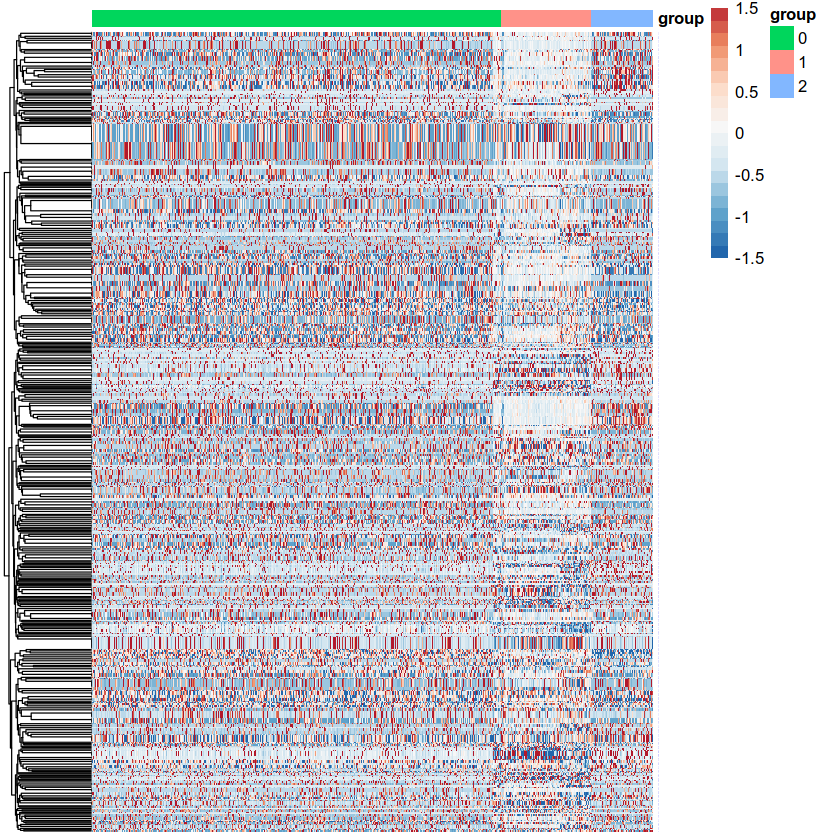

In [197]:
pheatmap(s2, show_rownames=T, cluster_rows=T,cluster_cols = F,clustering_distance_cols="euclidean",scale="row",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)


In [198]:
#chromatin 
DefaultAssay(subset_seurat) <- "peaks"

s<-as.matrix(subset_seurat@assays$peaks@data[tf_chromatin$feature,])
s2<-as.matrix(s[,rownames(annotation3)])

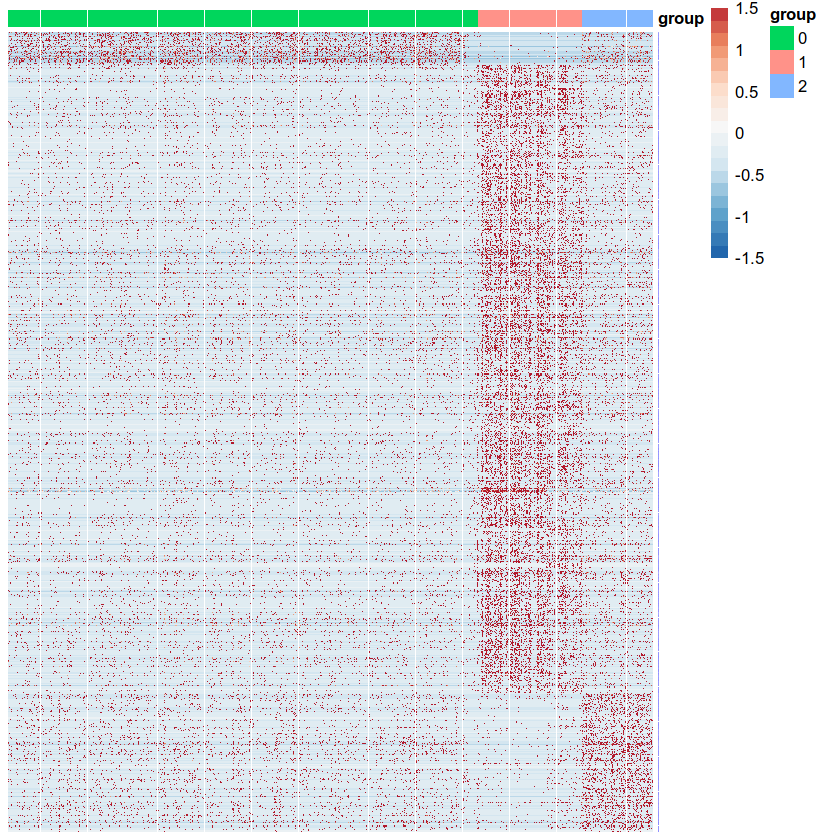

In [199]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="row",show_colnames= F,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)


In [200]:
library(presto)

In [201]:
pbmc.genes <- wilcoxauc(glio.int, 'CCA_RNA_snn_res.0.2')
dplyr::count(pbmc.genes, group)

group,n
<chr>,<int>
0,36601
1,36601
2,36601
3,36601


In [202]:
library(msigdbr)
library(fgsea)
library(dplyr)
library(ggplot2)
#library(tibble)

In [203]:
m_df<- msigdbr(species = "Homo sapiens", category = "C2",subcategory = "CGP")#我们使用H
#m_df<- msigdbr(species = "Homo sapiens", category = "C2",subcategory = "KEGG")
#m_df<- msigdbr(species = "Homo sapiens", category = "C2",subcategory = "REACTOME")
#m_df<- msigdbr(species = "Homo sapiens", category = "C5",subcategory = "BP")


In [204]:
fgsea_sets<- m_df %>% split(x = .$gene_symbol, f = .$gs_name)
pbmc.genes %>%
  dplyr::filter(group == "0") %>%
  arrange(desc(logFC), desc(auc)) %>%
  head(n = 10) 

,feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,IGFBP7,0,2.582026,1.844946,106476325,0.8491905,0,0,86.57797,45.18957
2,NEAT1,0,3.078553,1.549726,104217118,0.8311725,0,0,98.58435,72.38124
3,COL21A1,0,2.051745,1.544607,101821347,0.8120653,0,0,78.90367,29.85164
4,ANK2,0,2.588264,1.429871,107225342,0.8551642,0,0,95.91272,73.81238
5,EFEMP1,0,1.682309,1.422531,105644273,0.8425546,0,0,79.32943,20.47055
6,COL1A2,0,1.671603,1.292580,100228758,0.7993637,0,0,76.15753,26.10520
7,AHR,0,1.695877,1.220957,102362150,0.8163784,0,0,81.40500,38.70073
8,COL4A5,0,1.582397,1.147483,104434738,0.8329081,0,0,85.93933,33.95774
9,LMO3,0,1.329806,1.126721,101344720,0.8082640,0,0,72.01703,16.09471


In [205]:
cluster0.genes<- pbmc.genes %>%
  dplyr::filter(group == "0") %>%
  arrange(desc(auc)) %>%
  dplyr::select(feature, auc)

ranks<-as.vector(unlist(cluster0.genes$auc))
names(ranks)<-cluster0.genes$feature
head(ranks)

ANK2    IGFBP7    EFEMP1    COL4A5     NEAT1   SPARCL1 
0.8551642 0.8491905 0.8425546 0.8329081 0.8311725 0.8259158

In [206]:
fgseaRes<- fgsea(fgsea_sets, stats = ranks, nperm = 1000)

Warning message in fgsea(fgsea_sets, stats = ranks, nperm = 1000):
"You are trying to run fgseaSimple. It is recommended to use fgseaMultilevel. To run fgseaMultilevel, you need to remove the nperm argument in the fgsea function call."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (27.4% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"All values in the stats vector are greater than zero and scoreType is "std", maybe you should switch to scoreType = "pos"."


In [207]:
fgseaResTidy <- fgseaRes %>%
  as_tibble() %>%
  arrange(desc(NES))

fgseaResTidy %>%
  dplyr::select(-leadingEdge, -ES, -nMoreExtreme) %>%
  arrange(padj) %>% head(20)

pathway,pval,padj,NES,size
<chr>,<dbl>,<dbl>,<dbl>,<int>
REN_ALVEOLAR_RHABDOMYOSARCOMA_DN,0.001264223,0.005322345,10.374811,407
NUYTTEN_EZH2_TARGETS_UP,0.001108647,0.005322345,9.796719,1016
JOHNSTONE_PARVB_TARGETS_3_UP,0.001253133,0.005322345,9.645226,428
CHICAS_RB1_TARGETS_CONFLUENT,0.001201923,0.005322345,9.313953,557
BERENJENO_TRANSFORMED_BY_RHOA_DN,0.001272265,0.005322345,9.188493,397
GOZGIT_ESR1_TARGETS_DN,0.001160093,0.005322345,8.976834,756
CUI_TCF21_TARGETS_2_DN,0.001138952,0.005322345,8.922026,836
KINSEY_TARGETS_OF_EWSR1_FLII_FUSION_DN,0.001300390,0.005322345,8.913685,328
RODRIGUES_THYROID_CARCINOMA_POORLY_DIFFERENTIATED_DN,0.001144165,0.005322345,8.909791,774


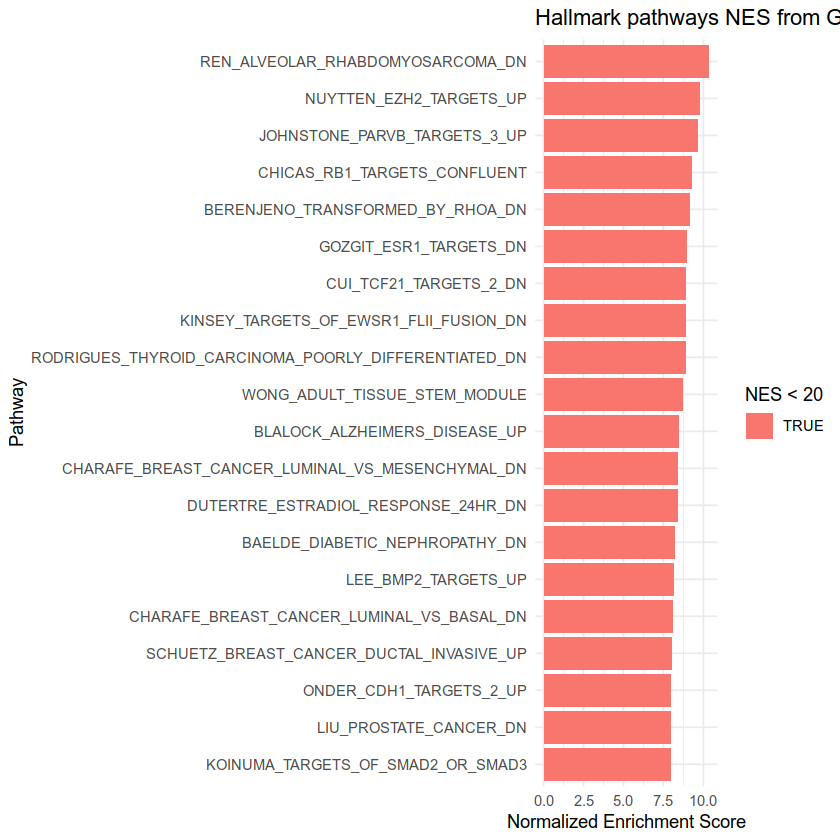

In [208]:
# 显示top20信号通路
ggplot(fgseaResTidy %>% filter(padj < 0.01) %>% head(n= 20), aes(reorder(pathway, NES), NES)) +
  geom_col(aes(fill= NES < 20)) +
  coord_flip() +
  labs(x="Pathway", y="Normalized Enrichment Score",
       title="Hallmark pathways NES from GSEA") +
  theme_minimal() ####以7.5进行绘图填色

In [209]:
cluster0.genes<- pbmc.genes %>%
  dplyr::filter(group == "1") %>%
  arrange(desc(auc)) %>%
  dplyr::select(feature, auc)

ranks<-as.vector(unlist(cluster0.genes$auc))
names(ranks)<-cluster0.genes$feature
head(ranks)

GPM6A      TCF4       QKI     SNTG1       PTN     NOVA1 
0.7973137 0.7872484 0.7521873 0.7450859 0.7403483 0.7393147

In [210]:
fgseaRes<- fgsea(fgsea_sets, stats = ranks, nperm = 1000)
fgseaResTidy <- fgseaRes %>%
  as_tibble() %>%
  arrange(desc(NES))

fgseaResTidy %>%
  dplyr::select(-leadingEdge, -ES, -nMoreExtreme) %>%
  arrange(padj) %>% head(20)

Warning message in fgsea(fgsea_sets, stats = ranks, nperm = 1000):
"You are trying to run fgseaSimple. It is recommended to use fgseaMultilevel. To run fgseaMultilevel, you need to remove the nperm argument in the fgsea function call."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (27.63% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"All values in the stats vector are greater than zero and scoreType is "std", maybe you should switch to scoreType = "pos"."


pathway,pval,padj,NES,size
<chr>,<dbl>,<dbl>,<dbl>,<int>
GOBERT_OLIGODENDROCYTE_DIFFERENTIATION_DN,0.001204819,0.006446083,11.082149,1063
VERHAAK_GLIOBLASTOMA_PRONEURAL,0.001577287,0.006446083,9.334481,175
BLALOCK_ALZHEIMERS_DISEASE_DN,0.001172333,0.006446083,9.045414,1233
DACOSTA_UV_RESPONSE_VIA_ERCC3_DN,0.001240695,0.006446083,8.978750,847
GRYDER_PAX3FOXO1_ENHANCERS_IN_TADS,0.001206273,0.006446083,8.624421,996
BUYTAERT_PHOTODYNAMIC_THERAPY_STRESS_UP,0.001245330,0.006446083,8.452375,810
ONKEN_UVEAL_MELANOMA_UP,0.001254705,0.006446083,7.642633,781
RODRIGUES_THYROID_CARCINOMA_POORLY_DIFFERENTIATED_DN,0.001270648,0.006446083,7.386379,774
DACOSTA_UV_RESPONSE_VIA_ERCC3_COMMON_DN,0.001375516,0.006446083,7.280211,458


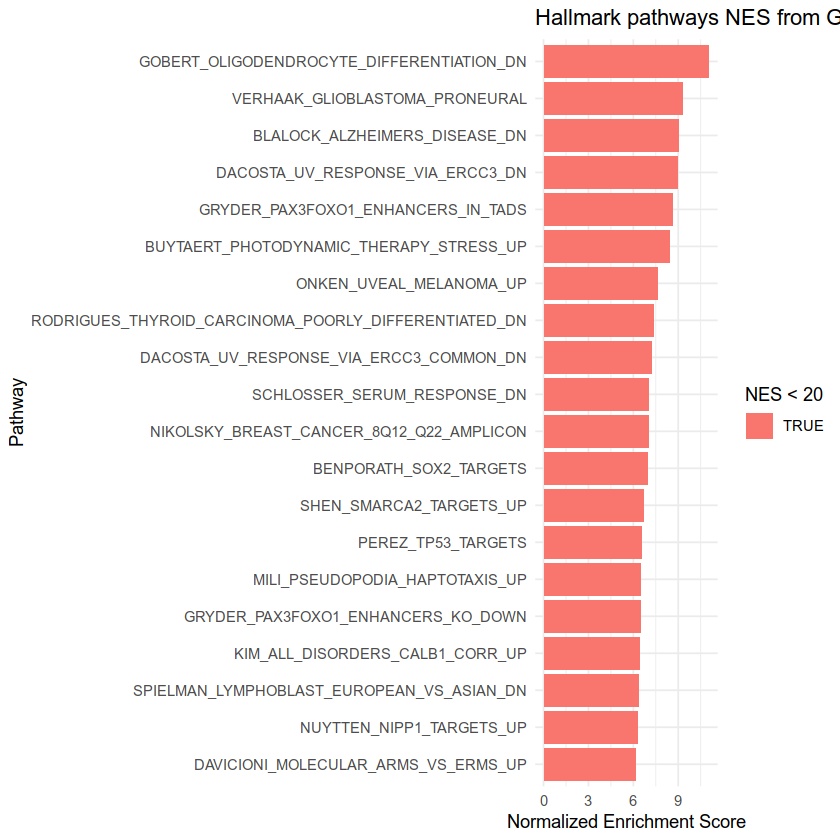

In [211]:
# 显示top20信号通路
ggplot(fgseaResTidy %>% filter(padj < 0.01) %>% head(n= 20), aes(reorder(pathway, NES), NES)) +
  geom_col(aes(fill= NES < 20)) +
  coord_flip() +
  labs(x="Pathway", y="Normalized Enrichment Score",
       title="Hallmark pathways NES from GSEA") +
  theme_minimal() ####以7.5进行绘图填色

In [212]:
cluster0.genes<- pbmc.genes %>%
  dplyr::filter(group == "2") %>%
  arrange(desc(auc)) %>%
  dplyr::select(feature, auc)

ranks<-as.vector(unlist(cluster0.genes$auc))
names(ranks)<-cluster0.genes$feature
head(ranks)

DIAPH3     BRIP1     CENPK      POLQ     CENPP     PRIM2 
0.9117745 0.8942441 0.8862289 0.8829193 0.8792297 0.8647946

In [213]:
fgseaRes<- fgsea(fgsea_sets, stats = ranks, nperm = 1000)
fgseaResTidy <- fgseaRes %>%
  as_tibble() %>%
  arrange(desc(NES))

fgseaResTidy %>%
  dplyr::select(-leadingEdge, -ES, -nMoreExtreme) %>%
  arrange(padj) %>% head(20)

Warning message in fgsea(fgsea_sets, stats = ranks, nperm = 1000):
"You are trying to run fgseaSimple. It is recommended to use fgseaMultilevel. To run fgseaMultilevel, you need to remove the nperm argument in the fgsea function call."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (28.45% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"All values in the stats vector are greater than zero and scoreType is "std", maybe you should switch to scoreType = "pos"."


pathway,pval,padj,NES,size
<chr>,<dbl>,<dbl>,<dbl>,<int>
FISCHER_DREAM_TARGETS,0.001182033,0.004679572,23.09303,911
KINSEY_TARGETS_OF_EWSR1_FLII_FUSION_UP,0.001150748,0.004679572,20.72610,1267
DODD_NASOPHARYNGEAL_CARCINOMA_DN,0.001141553,0.004679572,18.79862,1367
PUJANA_BRCA1_PCC_NETWORK,0.001117318,0.004679572,18.47763,1583
PUJANA_CHEK2_PCC_NETWORK,0.001209190,0.004679572,17.72340,750
LEE_BMP2_TARGETS_DN,0.001186240,0.004679572,16.80976,887
MARSON_BOUND_BY_E2F4_UNSTIMULATED,0.001231527,0.004679572,16.80950,667
JOHNSTONE_PARVB_TARGETS_3_DN,0.001201923,0.004679572,16.54433,852
GOBERT_OLIGODENDROCYTE_DIFFERENTIATION_UP,0.001290323,0.004679572,16.37412,558


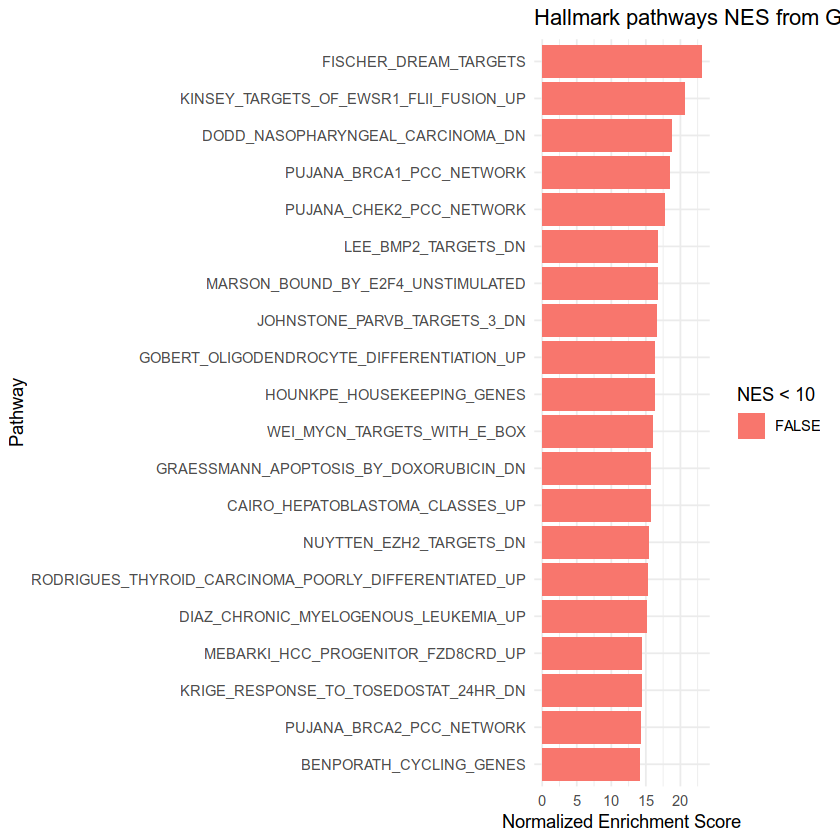

In [214]:
# 显示top20信号通路
ggplot(fgseaResTidy %>% filter(padj < 0.01) %>% head(n= 20), aes(reorder(pathway, NES), NES)) +
  geom_col(aes(fill= NES < 10)) +
  coord_flip() +
  labs(x="Pathway", y="Normalized Enrichment Score",
       title="Hallmark pathways NES from GSEA") +
  theme_minimal() ####以7.5进行绘图填色

In [215]:
cluster0.genes<- pbmc.genes %>%
  dplyr::filter(group == "3") %>%
  arrange(desc(auc)) %>%
  dplyr::select(feature, auc)

ranks<-as.vector(unlist(cluster0.genes$auc))
names(ranks)<-cluster0.genes$feature
head(ranks)

CENPF   ARL6IP1     CENPE      ASPM     H2AFZ     MKI67 
0.8754051 0.8123700 0.7944768 0.7767853 0.7767413 0.7730478

In [216]:
fgseaRes<- fgsea(fgsea_sets, stats = ranks, nperm = 1000)
fgseaResTidy <- fgseaRes %>%
  as_tibble() %>%
  arrange(desc(NES))

fgseaResTidy %>%
  dplyr::select(-leadingEdge, -ES, -nMoreExtreme) %>%
  arrange(padj) %>% head(20)

Warning message in fgsea(fgsea_sets, stats = ranks, nperm = 1000):
"You are trying to run fgseaSimple. It is recommended to use fgseaMultilevel. To run fgseaMultilevel, you need to remove the nperm argument in the fgsea function call."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (37.11% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."
Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"All values in the stats vector are greater than zero and scoreType is "std", maybe you should switch to scoreType = "pos"."


pathway,pval,padj,NES,size
<chr>,<dbl>,<dbl>,<dbl>,<int>
HOUNKPE_HOUSEKEEPING_GENES,0.001119821,0.005979327,17.85597,1113
PUJANA_BRCA1_PCC_NETWORK,0.001081081,0.005979327,14.38530,1583
CAIRO_HEPATOBLASTOMA_CLASSES_UP,0.001207729,0.005979327,13.96789,601
DIAZ_CHRONIC_MYELOGENOUS_LEUKEMIA_UP,0.001098901,0.005979327,13.96162,1384
PUJANA_CHEK2_PCC_NETWORK,0.001158749,0.005979327,13.80489,750
HSIAO_HOUSEKEEPING_GENES,0.001310616,0.005979327,12.67734,386
FISCHER_DREAM_TARGETS,0.001124859,0.005979327,12.59471,911
DODD_NASOPHARYNGEAL_CARCINOMA_DN,0.001100110,0.005979327,12.57476,1367
DANG_BOUND_BY_MYC,0.001117318,0.005979327,12.30878,1020


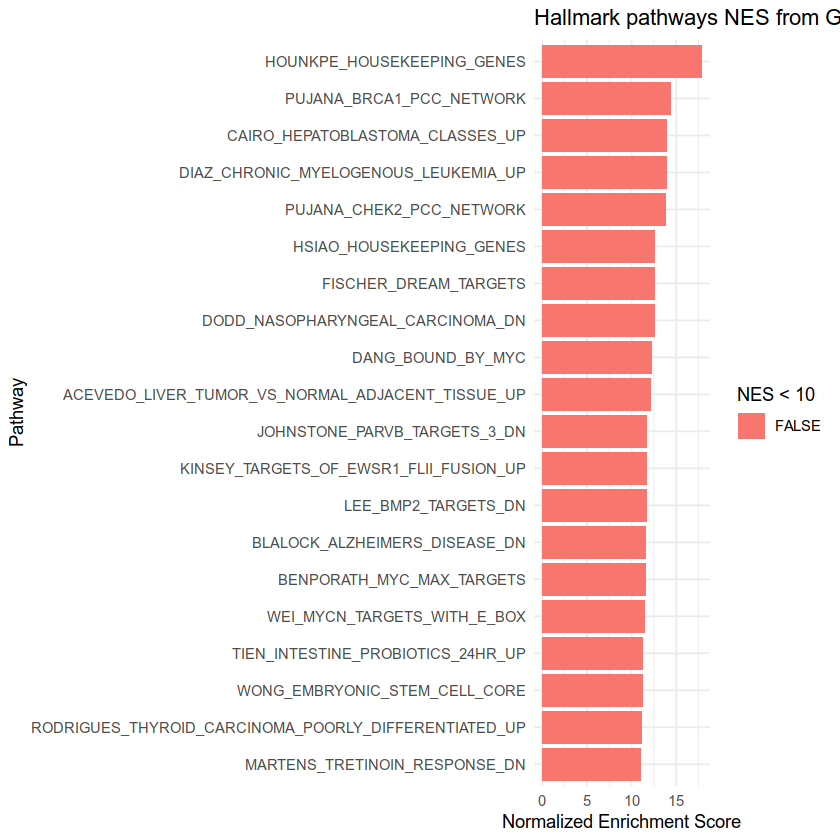

In [217]:
# 显示top20信号通路
ggplot(fgseaResTidy %>% filter(padj < 0.01) %>% head(n= 20), aes(reorder(pathway, NES), NES)) +
  geom_col(aes(fill= NES < 10)) +
  coord_flip() +
  labs(x="Pathway", y="Normalized Enrichment Score",
       title="Hallmark pathways NES from GSEA") +
  theme_minimal() ####以7.5进行绘图填色